In [1]:
!date

Tue Apr 30 10:00:27 PDT 2019


# Imports

In [2]:
import os
from pathlib import Path
import numpy as np
from IPython.display import display, HTML, Math
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import pybroom as br
from multispot_utils import heatmap48, spotsh, spotsv, info_html

In [3]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

plt.rcParams['font.sans-serif'].insert(0, 'Arial')
plt.rcParams['path.simplify_threshold'] = 1.0
plt.rcParams['font.size'] = 14

In [4]:
from fretbursts import *

 - Optimized (cython) burst search loaded.
 - Optimized (cython) photon counting loaded.
--------------------------------------------------------------
 You are running FRETBursts (version 0.7+26.g5de603d.dirty).

 If you use this software please cite the following paper:

   FRETBursts: An Open Source Toolkit for Analysis of Freely-Diffusing Single-Molecule FRET
   Ingargiola et al. (2016). http://dx.doi.org/10.1371/journal.pone.0160716 

--------------------------------------------------------------


In [5]:
sns = init_notebook(apionly=True)

In [6]:
plot_timetraces = True
skip_ch = (12, 13)

In [7]:
_plot_status = {}

# Load HDF5 files

In [8]:
mlabels = ['-8TA_-3NTD_500pM_no-flow_0-200s', '-8TA_-3NTD_500pM_Streets_chip_with_flow_0-200s']
mlabels

['-8TA_-3NTD_500pM_no-flow_0-200s',
 '-8TA_-3NTD_500pM_Streets_chip_with_flow_0-200s']

In [9]:
dir_ = '.'
dir_ = Path(dir_).absolute()
dir_

PosixPath('/Users/maya/Documents/weiss_lab/48-spot/multispot_review_results')

In [10]:
ls $dir_

05_-8TA_-3NTD_500pM.hdf5*
05_-8TA_-3NTD_500pM_cache.hdf5
06_-8TA_-3NTD_500pM_ASchip.hdf5*
06_-8TA_-3NTD_500pM_ASchip_cache.hdf5
README.md
__pycache__/
_config.yml
burst_analysis_for_flow_vs_no-flow_0-200s.ipynb
burst_analysis_no_flow_50kcps_vs_with_flow_75kcps.ipynb
cal_phrates.py
figures/
metadata/
results/
save_results_for_flow_vs_no-flow_0-200s-50kcps_75kcps_size_sel_40-64.ipynb
save_results_for_flow_vs_no-flow_0-200s-50kcps_75kcps_with_size_sel-v2.ipynb
save_results_for_flow_vs_no-flow_0-200s-50kcps_75kcps_with_size_sel-v3.ipynb
save_results_for_flow_vs_no-flow_0-200s-50kcps_75kcps_with_size_sel.ipynb
save_results_for_flow_vs_no-flow_0-200s.ipynb
save_results_for_flow_vs_no-flow_0-200s_v2.ipynb


In [11]:
# sort to have chronological order for repeats
filepaths = sorted([f for f in Path(dir_).glob('*.hdf5') 
                   if 'cache' not in f.stem]) 
fnames = [f.name for f in filepaths]
fnames

['05_-8TA_-3NTD_500pM.hdf5', '06_-8TA_-3NTD_500pM_ASchip.hdf5']

In [12]:
f0 = fnames[0][:19] # no flow
f1 = fnames[1][:26] # with flow
f0, f1

('05_-8TA_-3NTD_500pM', '06_-8TA_-3NTD_500pM_ASchip')

In [13]:
save_dir = './figures'
Path(save_dir).absolute()

PosixPath('/Users/maya/Documents/weiss_lab/48-spot/multispot_review_results/figures')

# Load data

In [14]:
d0 = loader.photon_hdf5(fnames[0]) # no flow
d1 = loader.photon_hdf5(fnames[1]) # with flow

In [15]:
info_html(d0)

In [16]:
info_html(d1)

In [17]:
blue = '#0055d4'
green = '#2ca02c'
red = '#e74c3c'  # '#E41A1C'
purple = '#9b59b6'
cyan = '#00FFFF'

In [18]:
def plot_alternation_hist_usalex(d0, d1, bins=None, ax=None, ich0=0, ich1=0, #adding a data object to function
                                 hist_style={}, span_style={}):
    """Plot the us-ALEX alternation histogram for the variable `d`.

    This function must be called on us-ALEX data **before** calling
    :func:`fretbursts.loader.alex_apply_period`.
    """
    if ax is None:
        _, ax = plt.subplots()

    if bins is None:
        bins = 100

    D0_ON, A0_ON = d0._D_ON_multich[ich0], d0._A_ON_multich[ich0]
    D1_ON, A1_ON = d1._D_ON_multich[ich1], d1._A_ON_multich[ich1]
    d0_ch, a0_ch = d0._det_donor_accept_multich[ich0]
    d1_ch, a1_ch = d1._det_donor_accept_multich[ich1]
    offset0 = d0.get('offset', 0)
    offset1 = d1.get('offset', 0)
    
    ph0_times_t, det0_t = d0.ph_times_t[ich0][:], d0.det_t[ich0][:]
    ph1_times_t, det1_t = d1.ph_times_t[ich1][:], d1.det_t[ich1][:]
    period0 = d0.alex_period
    period1 = d1.alex_period
    d0_em_t = (det0_t == d0_ch)
    d1_em_t = (det1_t == d1_ch)
    
    hist_style_ = dict(bins=bins, histtype='step', lw=2, alpha=0.9, zorder=4) #zorder=2
    hist_style_.update(hist_style)
    span_style_ = dict(alpha=0.2, zorder=2) #zorder=1 
    span_style_.update(span_style)

    D0_label = 'Donor: %d-%d, no flow' % (D0_ON[0], D0_ON[1])
    D1_label = 'Donor: %d-%d, Streets chip with 10μL flow rate' % (D1_ON[0], D1_ON[1])
    A0_label = 'Accept: %d-%d, no flow' % (A0_ON[0], A0_ON[1])
    A1_label = 'Accept: %d-%d, Streets chip with 10μL flow rate' % (A1_ON[0], A1_ON[1])

    ax.hist((ph0_times_t[d0_em_t] - offset0) % period0, color=green, label=D0_label,
            **hist_style_)
    ax.hist((ph1_times_t[d1_em_t] - offset1) % period1, color=blue, label=D1_label,
            **hist_style_)
    ax.hist((ph0_times_t[~d0_em_t] - offset0) % period0, color=red, label=A0_label,
            **hist_style_)
    ax.hist((ph1_times_t[~d1_em_t] - offset1) % period1, color=purple, label=A1_label,
            **hist_style_)
    
    ax.set_xlabel('Timestamp MODULO Alternation period')

    if D0_ON[0] < D0_ON[1]:
        ax.axvspan(D0_ON[0], D0_ON[1], color=green, **span_style_)
    else:
        ax.axvspan(0, D0_ON[1], color=green, **span_style_)
        ax.axvspan(D0_ON[0], period0, color=green, **span_style_)
        
    if D1_ON[0] < D1_ON[1]:
        ax.axvspan(D1_ON[0], D1_ON[1], color=green, **span_style_)
    else:
        ax.axvspan(0, D1_ON[1], color=green, **span_style_)
        ax.axvspan(D1_ON[0], period1, color=green, **span_style_)

    if A0_ON[0] < A0_ON[1]:
        ax.axvspan(A0_ON[0], A0_ON[1], color=red, **span_style_)
    else:
        ax.axvspan(0, A0_ON[1], color=red, **span_style_)
        ax.axvspan(A0_ON[0], period0, color=red, **span_style_)
    if A1_ON[0] < A1_ON[1]:
        ax.axvspan(A1_ON[0], A1_ON[1], color=red, **span_style_)
    else:
        ax.axvspan(0, A1_ON[1], color=red, **span_style_)
        ax.axvspan(A1_ON[0], period1, color=red, **span_style_)
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5), frameon=False)

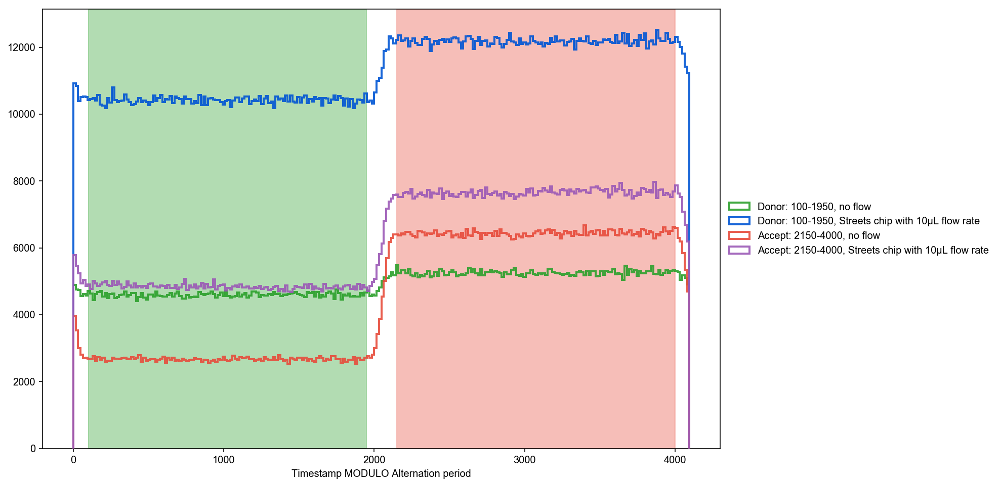

In [19]:
fig, ax = plt.subplots(figsize=(12, 8))
plot_alternation_hist_usalex(d0, d1, ax=ax, bins=np.arange(0, 4097, 16))
plt.savefig(f'{save_dir}/{mlabels[0]}_{mlabels[1]}_alternation_hist.png', bbox_inches='tight', dpi=1200);

In [20]:
%%timeit -n1 -r1 
loader.alex_apply_period(d0) 
loader.alex_apply_period(d1)

# Total photons (after ALEX selection):   121,766,143
#  D  photons in D+A excitation periods:   61,895,751
#  A  photons in D+A excitation periods:   59,870,392
# D+A photons in  D  excitation period:    48,825,342
# D+A photons in  A  excitation period:    72,940,801

# Total photons (after ALEX selection):   314,610,922
#  D  photons in D+A excitation periods:  162,968,031
#  A  photons in D+A excitation periods:  151,642,891
# D+A photons in  D  excitation period:    91,730,911
# D+A photons in  A  excitation period:   222,880,011

31.8 s ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)


# Select first 0 - 200 s

In [21]:
d0.time_max, d1.time_max

(300.05318665, 300.08232792499996)

In [22]:
d0 = d0.slice_ph(time_s1=0, time_s2=200)
d1 = d1.slice_ph(time_s1=0, time_s2=200)

In [23]:
d0.time_max, d1.time_max

(199.99998507499998, 199.99999778749998)

# Timetraces

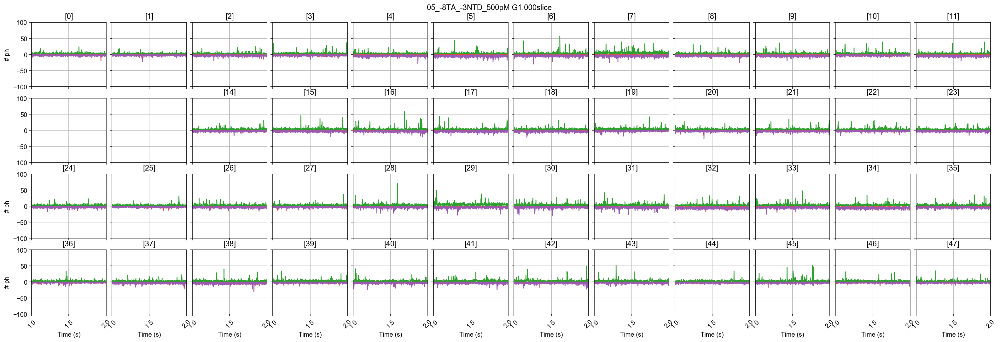

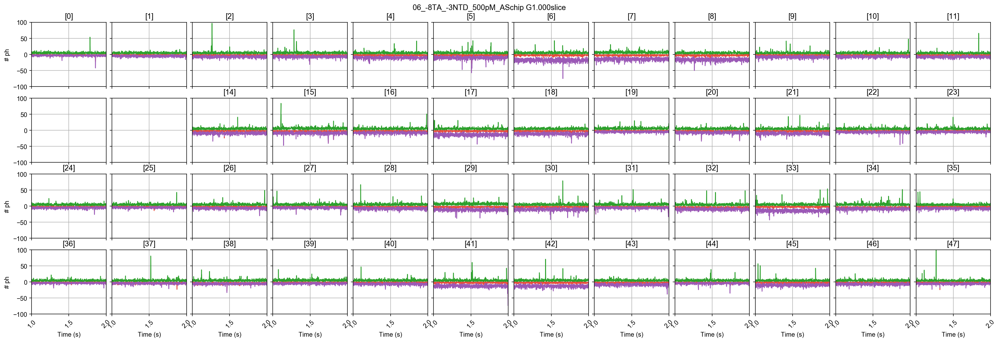

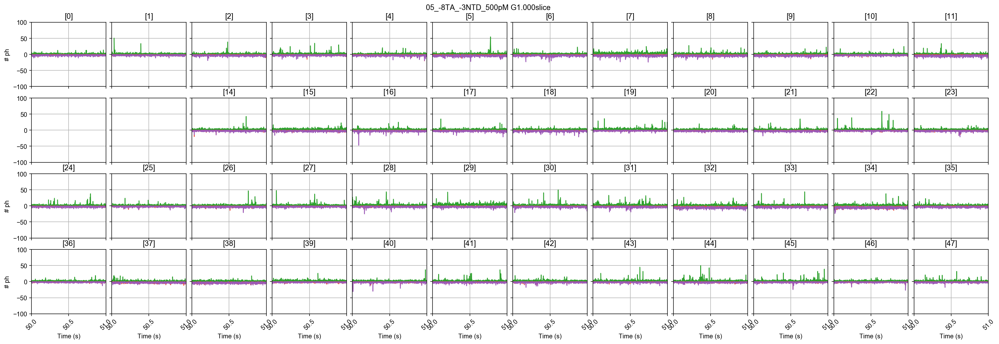

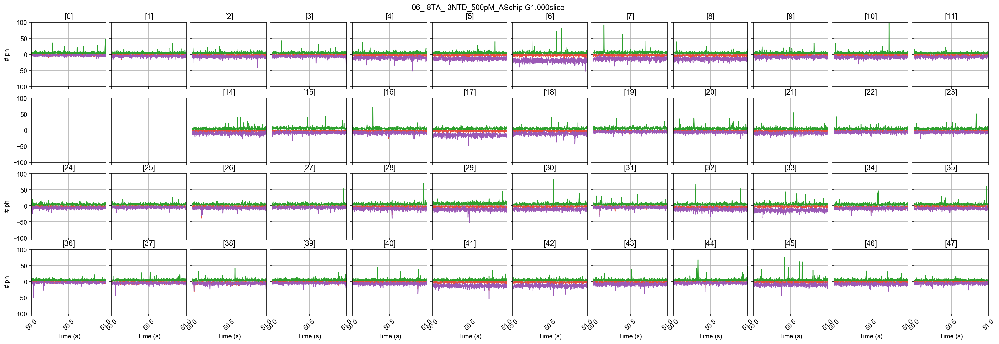

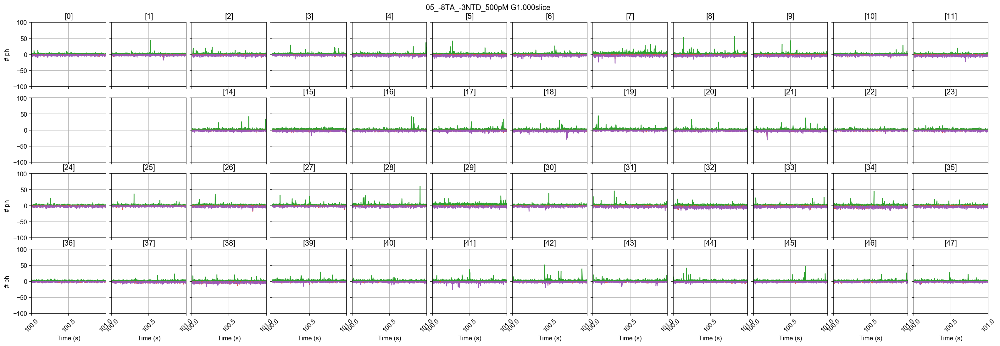

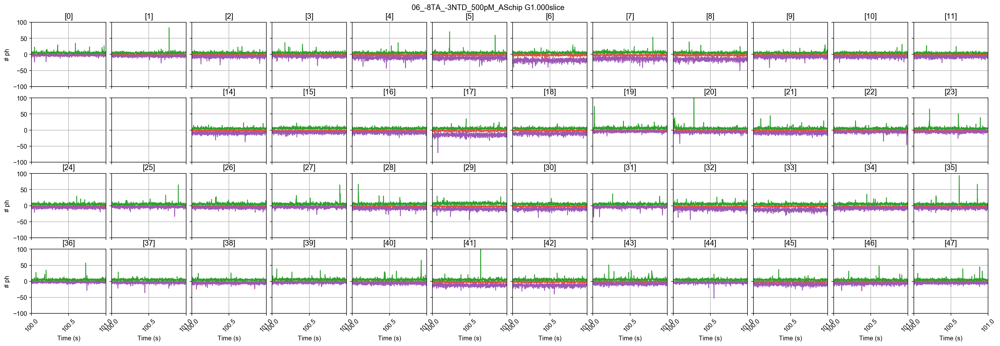

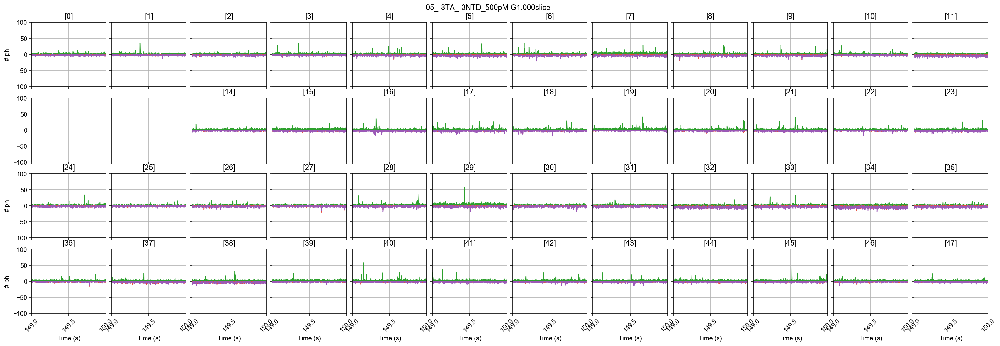

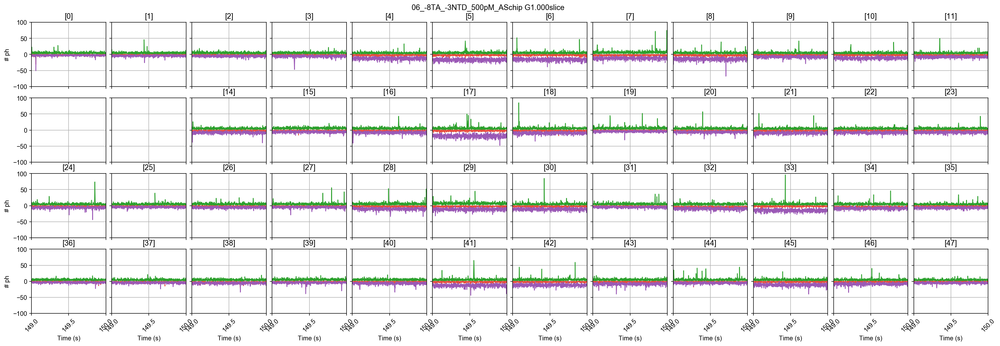

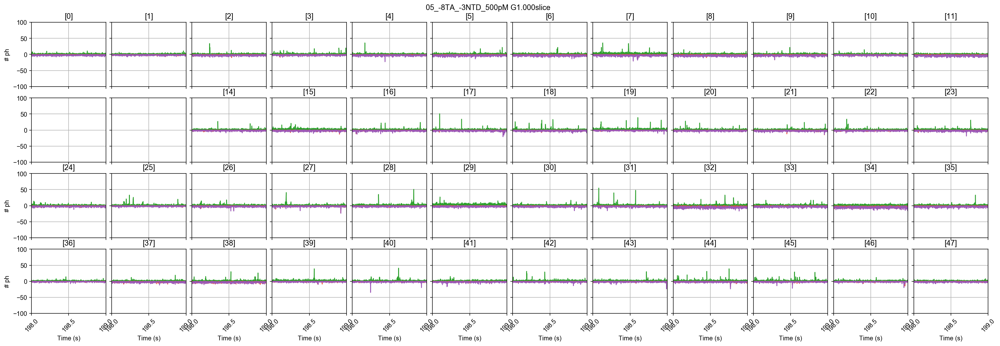

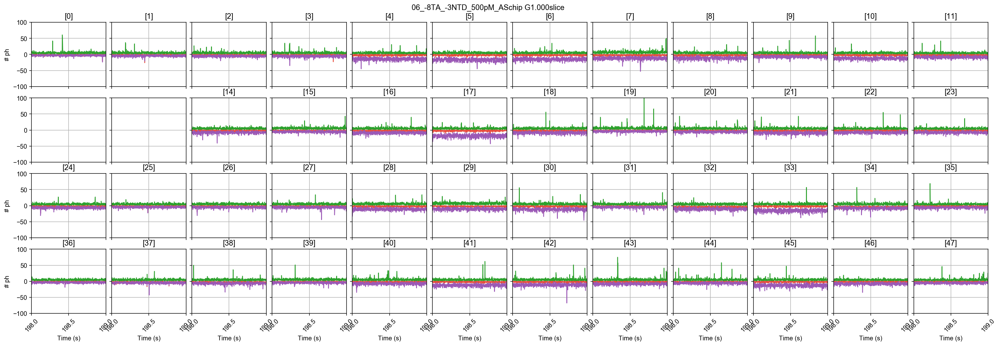

In [24]:
if plot_timetraces:
    num_time_points = 5
    kws = dict(figsize=(24, 8), skip_ch=skip_ch, xrotation=45)
    
    # Timepoints equally distributed along the measurement
    time_points = np.round(np.linspace(d0.time_min+1, d0.time_max-2, num=num_time_points))

    for i in time_points:
        dplot(d0, timetrace, tmin=i, tmax=i+1, **kws)
        plt.ylim(-100, 100)
        plt.savefig(f'{save_dir}/no_flow_timetrace={i}-{i+1}.png', dpi=1200)
        
        dplot(d1, timetrace, tmin=i, tmax=i+1, **kws)
        plt.ylim(-100, 100)
        plt.savefig(f'{save_dir}/Streets_chip_with_flow_timetrace={i}-{i+1}.png', dpi=1200);

# Background

In [25]:
d0.calc_bg(bg.exp_fit, time_s=10, tail_min_us='auto', F_bg=1.7) # no flow
d1.calc_bg(bg.exp_fit, time_s=10, tail_min_us='auto', F_bg=1.7) # with flow

 - Calculating BG rates ... [DONE]
 - Calculating BG rates ... [DONE]


## Plot background rates

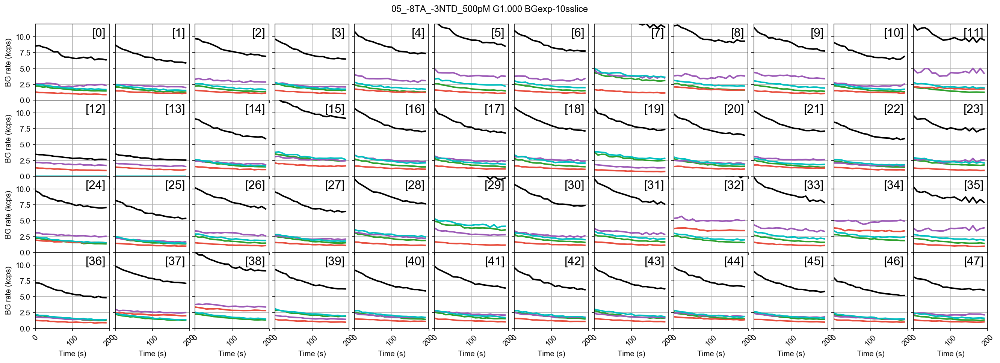

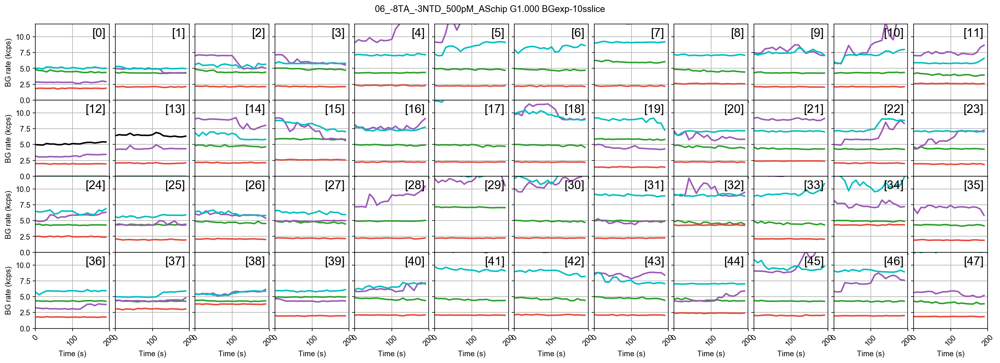

In [26]:
ax = dplot(d0, timetrace_bg, show_da=True, hspace=0, wspace=0.08,
           plot_style=dict(marker=None), title='right top', 
           title_kws=dict(fontsize=16), xrotation=45)
plt.xlim(0)
plt.ylim(0, 12)
plt.savefig(f'{save_dir}/{mlabels[0]}_background_48-spots_all_streams.png', bbox_to_anchor='tight', dpi = 1200)

ax = dplot(d1, timetrace_bg, show_da=True, hspace=0, wspace=0.08,
           plot_style=dict(marker=None), title='right top', 
           title_kws=dict(fontsize=16), xrotation=45)
plt.xlim(0)
plt.ylim(0, 12)
plt.savefig(f'{save_dir}/{mlabels[1]}_background_48-spots_all_streams.png', bbox_to_anchor='tight', dpi = 1200);

In [27]:
bg_AexDem_nf = d0.bg_from(Ph_sel(Aex='Dem'))
bg_AexAem_nf = d0.bg_from(Ph_sel(Aex='Aem'))
bg_DexDem_nf = d0.bg_from(Ph_sel(Dex='Dem'))
bg_DexAem_nf = d0.bg_from(Ph_sel(Dex='Aem'))

bg_AexDem_f = d1.bg_from(Ph_sel(Aex='Dem'))
bg_AexAem_f = d1.bg_from(Ph_sel(Aex='Aem'))
bg_DexDem_f = d1.bg_from(Ph_sel(Dex='Dem'))
bg_DexAem_f = d1.bg_from(Ph_sel(Dex='Aem'))

In [28]:
import matplotlib.patches as mpatches

In [29]:
green_patch = mpatches.Patch(color=green, label='no flow')
red_patch = mpatches.Patch(color=red, label='no flow')
blue_patch = mpatches.Patch(color=blue, label='flow rate = 10μL/hr')
purple_patch = mpatches.Patch(color=purple, label='flow rate = 10μL/hr')

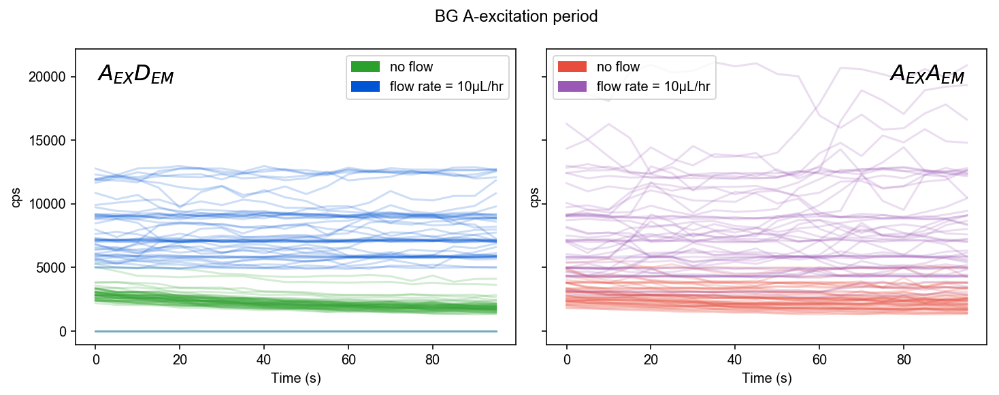

In [30]:
fig, ax = plt.subplots(1, 2, figsize=(12, 4), sharex=True, sharey=True)
fig.suptitle("BG A-excitation period")
t0 = np.arange(len(bg_AexDem_nf[0])) * 5
t1 = np.arange(len(bg_AexDem_f[0])) * 5
ax[0].plot(t0, np.array(bg_AexDem_nf).T, color=green, alpha=0.2)
ax[1].plot(t0, np.array(bg_AexAem_nf).T, color=red, alpha=0.2)
ax[0].plot(t1, np.array(bg_AexDem_f).T, color=blue, alpha=0.2)
ax[1].plot(t1, np.array(bg_AexAem_f).T, color=purple, alpha=0.2)
plt.setp(ax, xlabel='Time (s)', ylabel='cps')
plt.subplots_adjust(wspace=0.07)
ax[0].text(0.05, 0.95, '$A_{EX}D_{EM}$', va='top', fontsize=16, transform=ax[0].transAxes)
ax[1].text(0.95, 0.95, '$A_{EX}A_{EM}$', va='top', ha='right', fontsize=16, transform=ax[1].transAxes)
ax[0].text(0.05, 0.95, '$A_{EX}D_{EM}$', va='top', fontsize=16, transform=ax[0].transAxes)
ax[1].text(0.95, 0.95, '$A_{EX}A_{EM}$', va='top', ha='right', fontsize=16, transform=ax[1].transAxes)
ax[0].legend(handles=[green_patch, blue_patch], loc='upper right')
ax[1].legend(handles=[red_patch, purple_patch], loc='upper left')
plt.savefig(f'{save_dir}/{mlabels[0]}_{mlabels[1]}_background_AexDem_AexAem.png', bbox_to_anchor='tight', dpi = 1200);

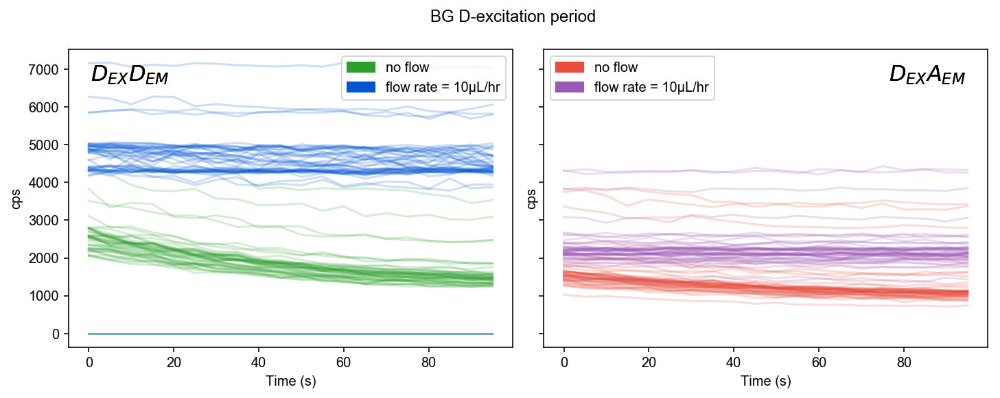

In [31]:
fig, ax = plt.subplots(1, 2, figsize=(12, 4), sharex=True, sharey=True)
fig.suptitle("BG D-excitation period")
t0 = np.arange(len(bg_DexDem_nf[0])) * 5
t1 = np.arange(len(bg_DexDem_f[0])) * 5
ax[0].plot(t0, np.array(bg_DexDem_nf).T, color=green, alpha=0.2)
ax[1].plot(t0, np.array(bg_DexAem_nf).T, color=red, alpha=0.2)
ax[0].plot(t1, np.array(bg_DexDem_f).T, color=blue, alpha=0.2)
ax[1].plot(t1, np.array(bg_DexAem_f).T, color=purple, alpha=0.2)
plt.setp(ax, xlabel='Time (s)', ylabel='cps')
plt.subplots_adjust(wspace=0.07)
ax[0].text(0.05, 0.95, '$D_{EX}D_{EM}$', va='top', fontsize=16, transform=ax[0].transAxes)
ax[1].text(0.95, 0.95, '$D_{EX}A_{EM}$', va='top', ha='right', fontsize=16, transform=ax[1].transAxes)
ax[0].text(0.05, 0.95, '$D_{EX}D_{EM}$', va='top', fontsize=16, transform=ax[0].transAxes)
ax[1].text(0.95, 0.95, '$D_{EX}A_{EM}$', va='top', ha='right', fontsize=16, transform=ax[1].transAxes)
ax[0].legend(handles=[green_patch, blue_patch], loc='upper right')
ax[1].legend(handles=[red_patch, purple_patch], loc='upper left')
plt.savefig(f'{save_dir}/{mlabels[0]}_{mlabels[1]}_background_DexDem_DexAem.png', bbox_to_anchor='tight', dpi = 1200);

## Plot interphoton delays

In [32]:
plot_style = dict(marker='o', markersize=1, linestyle='none', alpha=0.6)

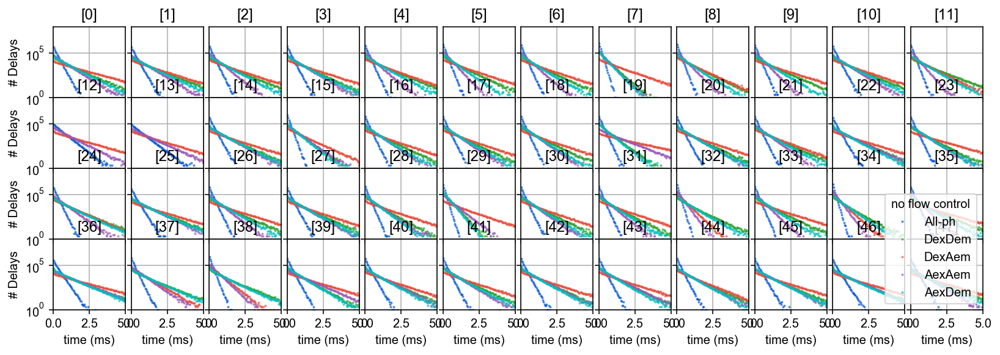

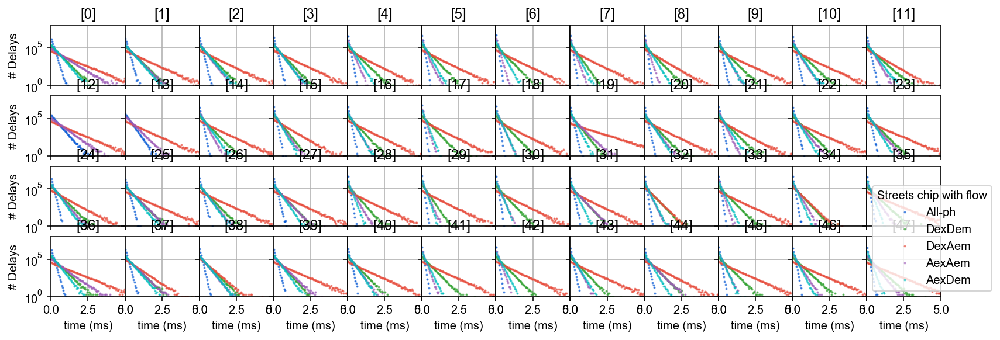

In [33]:
dplot(d0, hist_interphoton, binwidth=50e-6, show_da=True, 
      suptitle=False, hspace=0, wspace=0.08, figsize=(12, 4), 
      legend=True, xrotation=45, plot_style=plot_style)
plt.xlim(50e-6, 5)
plt.ylim(1, 1e8)
plt.legend(title='no flow control')

dplot(d1, hist_interphoton, binwidth=50e-6, show_da=True, 
      suptitle=False, wspace=0, figsize=(12, 4), 
      legend=True, xrotation=45, plot_style=plot_style)
plt.xlim(50e-6, 5)
plt.ylim(1, 1e8)
plt.legend(title='Streets chip with flow');

In [34]:
def _normalize_kwargs(kwargs, kind='patch'):
    """Convert matplotlib keywords from short to long form."""
    if kwargs is None:
        return {}

    if kind == 'line2d':
        long_names = dict(c='color', ls='linestyle', lw='linewidth',
                          mec='markeredgecolor', mew='markeredgewidth',
                          mfc='markerfacecolor', ms='markersize',)
    elif kind == 'patch':
        long_names = dict(c='color', ls='linestyle', lw='linewidth',
                          ec='edgecolor', fc='facecolor',)
    for short_name in long_names:
        if short_name in kwargs:
            kwargs[long_names[short_name]] = kwargs.pop(short_name)
    return kwargs

In [35]:
_ph_sel_color_dict = {Ph_sel('all'): blue, 
                      Ph_sel(Dex='Dem'): green,
                      Ph_sel(Dex='Aem'): red, 
                      Ph_sel(Aex='Aem'): purple,
                      Ph_sel(Aex='Dem'): 'c', }
_ph_sel_label_dict = {Ph_sel('all'): 'All-ph', 
                      Ph_sel(Dex='Dem'): 'DexDem',
                      Ph_sel(Dex='Aem'): 'DexAem', 
                      Ph_sel(Aex='Aem'): 'AexAem',
                      Ph_sel(Aex='Dem'): 'AexDem'}

In [36]:
def hist_interphoton_single(d0, d1, i=0, binwidth=1e-4, tmax=None, bins=None,
                            ph_sel=Ph_sel('all'), period=None,
                            yscale='log', xscale='linear', xunit='ms',
                            plot_style=None):
    
    unit_dict = {'s': 1, 'ms': 1e3, 'us': 1e6, 'ns': 1e9}
    assert xunit in unit_dict
    scalex = unit_dict[xunit]

    # Compute interphoton delays
    if period is None:
        ph0_times = d0.get_ph_times(ich=i, ph_sel=ph_sel)
        ph1_times = d1.get_ph_times(ich=i, ph_sel=ph_sel)
    else:
        ph0_times = d0.get_ph_times_period(ich=i, period=period, ph_sel=ph_sel)
        ph1_times = d1.get_ph_times_period(ich=i, period=period, ph_sel=ph_sel)
    delta_ph0_t = np.diff(ph0_times) * d0.clk_p
    delta_ph1_t = np.diff(ph1_times) * d1.clk_p
    if tmax is None:
        tmax0 = delta_ph0_t.max()
        tmax1 = delta_ph1_t.max()
        
    # Compute bin edges if not passed in
    if bins is None:
        # Shift by half clk_p to avoid "beatings" in the distribution
        # due to floating point inaccuracies.
        bins0 = np.arange(0, tmax0 + binwidth, binwidth) - 0.5 * d0.clk_p
        bins1 = np.arange(0, tmax1 + binwidth, binwidth) - 0.5 * d1.clk_p
    else:
        warnings.warn('Using `bins` and ignoring `tmax` and `binwidth`.')
    t0_ax = bins0[:-1] + 0.5 * binwidth
    t1_ax = bins1[:-1] + 0.5 * binwidth

    # Compute interphoton histogram
    counts0, _ = np.histogram(delta_ph0_t, bins=bins0)
    counts1, _ = np.histogram(delta_ph1_t, bins=bins1)

    # Max index with counts > 0
    n0_trim = np.trim_zeros(counts0).size + 1
    n1_trim = np.trim_zeros(counts1).size + 1

    # Plot histograms
    plot_style_ = dict(lw=4, alpha=0.7)
    
    #if ph_sel in _ph_sel_color_dict:
        #plot_style_['color'] = _ph_sel_color_dict[ph_sel]
        #plot_style_['label'] = _ph_sel_label_dict[ph_sel]
    
    plot_style_.update(_normalize_kwargs(plot_style, kind='line2d'))
    plot(t0_ax[:n0_trim] * scalex, counts0[:n0_trim], **plot_style_)
    plot(t1_ax[:n1_trim] * scalex, counts1[:n1_trim], **plot_style_)

    if yscale == 'log':
        gca().set_yscale(yscale)
        plt.ylim(1)
        _plot_status['hist_interphoton_single'] = {'autoscale': False}
    if xscale == 'log':
        gca().set_xscale(yscale)
        plt.xlim(0.5 * binwidth)
        _plot_status['hist_interphoton_single'] = {'autoscale': False}
    plt.xlabel('Inter-photon delays (%s)' % xunit.replace('us', 'μs'))
    plt.ylabel('# Delays')
    # Return internal variables so that other functions can extend the plot
    return dict(counts0=counts0, counts1=counts1, n0_trim=n0_trim, n1_trim=n1_trim, plot_style_=plot_style_,
                t0_ax=t0_ax, t1_ax=t1_ax, scalex=scalex)

In [37]:
def hist_interphoton(d0, d1, i=0, binwidth=1e-4, tmax=None, bins=None, period=None,
                     yscale='log', xscale='linear', xunit='ms', plot_style=None,
                     show_da=False, legend=True):
   
    # Plot multiple timetraces
    ph_sel_list = [Ph_sel('all'), Ph_sel(Dex='Dem'), Ph_sel(Dex='Aem')]
    if d0.alternated:
        ph_sel_list.append(Ph_sel(Aex='Aem'))
        if show_da:
            ph_sel_list.append(Ph_sel(Aex='Dem'))

    for ix, ph_sel in enumerate(ph_sel_list):
        if not bl.mask_empty(d0.get_ph_mask(i, ph_sel=ph_sel)):
            hist_interphoton_single(d0, d1, i=i, binwidth=binwidth, tmax=None, bins=None, 
                                    period=period, ph_sel=ph_sel,
                                    yscale=yscale, xscale=xscale, xunit=xunit,
                                    plot_style=plot_style)
                   
            
    if legend:
        plt.legend(loc='best')

    if yscale == 'log' or xscale == 'log':
        _plot_status['hist_interphoton'] = {'autoscale': False}


In [38]:
legend_list = ['All-ph: no flow', 
               'All-ph: Streets chip with flow', 
               'DexDem: no flow', 
               'DexDem: Streets chip with flow', 
               'DexAem: no flow', 
               'DexAem: Streets chip with flow',
               'AexAem: no flow', 
               'AexAem: Streets chip with flow']

No handles with labels found to put in legend.


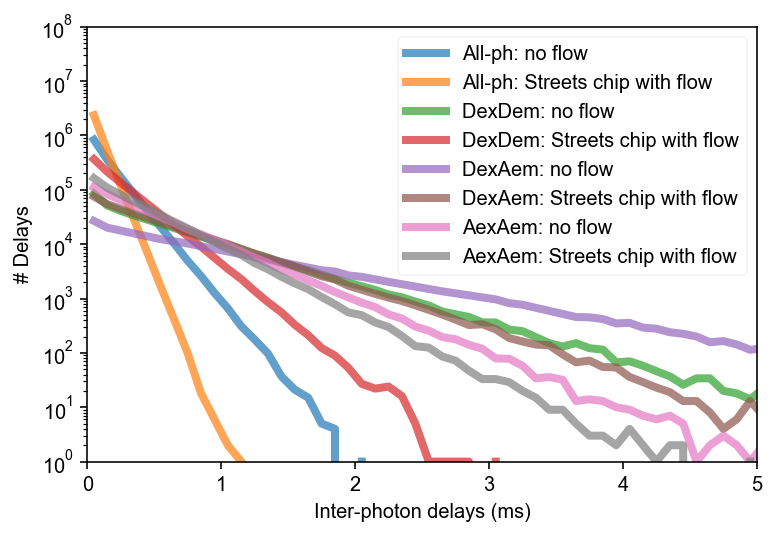

In [39]:
hist_interphoton(d0, d1, i=0, binwidth=1e-4, tmax=None, bins=None, period=None,
                     yscale='log', xscale='linear', xunit='ms', plot_style=None,
                     show_da=False)
plt.xlim(50e-6, 5)
plt.ylim(1, 1e8)
plt.legend(legend_list, framealpha=0.2)
plt.savefig(f'{save_dir}/{mlabels[0]}_{mlabels[1]}_interphoton_delay_distribution_nt.png', 
            bbox_to_anchor='tight', dpi = 1200);

# Burst searches

In order to compare the control measurement without flow to the measurement acquired with the Streets chip under flow conditions at differing powers, it is necessary to adjust the burst searchers. 

**2 burst searches using a fixed threshold**
   - 50 kcps for samples with flow and without flow
   - 75 kcps for samples with flow and without flow

In [40]:
Dex_nf = d0.setup['excitation_input_powers'][0] * 1e3
Dex_f = d1.setup['excitation_input_powers'][0] * 1e3
Aex_nf = d0.setup['excitation_input_powers'][1] * 1e3
Aex_f = d1.setup['excitation_input_powers'][1] * 1e3
power_nf = f'D{Dex_nf:.0f}mW_A{Aex_nf:.0f}mW'
power_f = f'D{Dex_f:.0f}mW_A{Aex_f:.0f}mW'
power_nf, power_nf

('D300mW_A600mW', 'D300mW_A600mW')

In [41]:
Dex_ratio = 500 / 300 # [mW]
Aex_ratio = 800 / 600 # [mW]
Dex_ratio, Aex_ratio

(1.6666666666666667, 1.3333333333333333)

In [42]:
power_ratio = (Dex_ratio + Aex_ratio) / 2
power_ratio

1.5

In [43]:
power_ratio * 50e3

75000.0

**Compare burst search results for measurement with and without flow**
  
1. No flow control, th = 50kcps (`d0`)
2. No flow control, th = 75kcps (`d0`)
3. Streets chip with flow, th=50kcps (`d1`)
4. Streets chip with flow, th=75kcps (`d1`)


In [44]:
bsearch_params_50kcps = dict(m=10, ph_sel=Ph_sel('all'), pax=True, min_rate_cps=50e3) #d0, no flow
bsearch_params_75kcps = dict(m=10, ph_sel=Ph_sel('all'), pax=True, min_rate_cps=75e3) #d2, with flow

In [45]:
d50nf = d0         
d75nf = d0.copy() 

d50f = d1          
d75f = d1.copy()   

Deep copy executed.
Deep copy executed.


In [46]:
d_list = [d50nf, d75nf, d50f, d75f]
d_list

[05_-8TA_-3NTD_500pM G1.000 BGexp-10sslice,
 05_-8TA_-3NTD_500pM G1.000 BGexp-10sslice,
 06_-8TA_-3NTD_500pM_ASchip G1.000 BGexp-10sslice,
 06_-8TA_-3NTD_500pM_ASchip G1.000 BGexp-10sslice]

In [47]:
d50nf.burst_search(**bsearch_params_50kcps) 
d75nf.burst_search(**bsearch_params_75kcps) 

d50f.burst_search(**bsearch_params_50kcps) 
d75f.burst_search(**bsearch_params_75kcps) 

 - Performing burst search (verbose=False) ...[DONE]
 - Calculating burst periods ...[DONE]
 - Counting D and A ph and calculating FRET ... 
   - Applying background correction.
   [DONE Counting D/A]
 - Performing burst search (verbose=False) ...[DONE]
 - Calculating burst periods ...[DONE]
 - Counting D and A ph and calculating FRET ... 
   - Applying background correction.
   [DONE Counting D/A]
 - Performing burst search (verbose=False) ...[DONE]
 - Calculating burst periods ...[DONE]
 - Counting D and A ph and calculating FRET ... 
   - Applying background correction.
   [DONE Counting D/A]
 - Performing burst search (verbose=False) ...[DONE]
 - Calculating burst periods ...[DONE]
 - Counting D and A ph and calculating FRET ... 
   - Applying background correction.
   [DONE Counting D/A]


In [48]:
d50nf.calc_max_rate(m=bsearch_params_50kcps['m'])
d75nf.calc_max_rate(m=bsearch_params_75kcps['m'])
d50f.calc_max_rate(m=bsearch_params_50kcps['m'])
d75f.calc_max_rate(m=bsearch_params_75kcps['m'])

In [49]:
fig_name_nf_50kcps = f'{save_dir}/{f0}_bsearch_params'
for k, v in bsearch_params_50kcps.items():
    fig_name_nf_50kcps += f'_{k}_{v}'
fig_name_nf_50kcps

'./figures/05_-8TA_-3NTD_500pM_bsearch_params_m_10_ph_sel_all_pax_True_min_rate_cps_50000.0'

In [50]:
fig_name_nf_75kcps = f'{save_dir}/{f0}_bsearch_params'
for k, v in bsearch_params_75kcps.items():
    fig_name_nf_75kcps += f'_{k}_{v}'
fig_name_nf_75kcps

'./figures/05_-8TA_-3NTD_500pM_bsearch_params_m_10_ph_sel_all_pax_True_min_rate_cps_75000.0'

In [51]:
fig_name_f_50kcps = f'{save_dir}/{f1}_bsearch_params'
for k, v in bsearch_params_50kcps.items():
    fig_name_f_50kcps += f'_{k}_{v}'
fig_name_f_50kcps

'./figures/06_-8TA_-3NTD_500pM_ASchip_bsearch_params_m_10_ph_sel_all_pax_True_min_rate_cps_50000.0'

In [52]:
fig_name_f_75kcps = f'{save_dir}/{f1}_bsearch_params'
for k, v in bsearch_params_75kcps.items():
    fig_name_f_75kcps += f'_{k}_{v}'
fig_name_f_75kcps

'./figures/06_-8TA_-3NTD_500pM_ASchip_bsearch_params_m_10_ph_sel_all_pax_True_min_rate_cps_75000.0'

# Burst size distributions

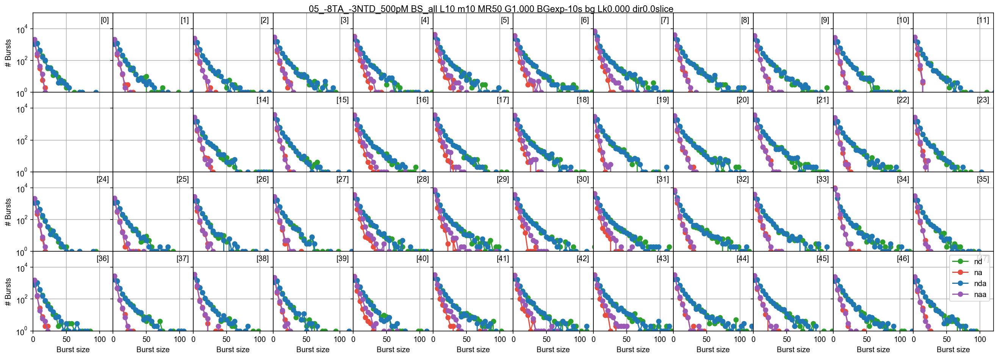

In [53]:
kws = dict(skip_ch=skip_ch, hspace=0, wspace=0, top=0.96, 
           title_bg=False, title_nbursts=False, title='in')

dplot(d50nf, hist_size_all, **kws)
plt.xlim(0, 120)
plt.ylim(1, 1e5)
plt.legend()
plt.savefig(f'{fig_name_nf_50kcps}_burst_size_all_ph-streams_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

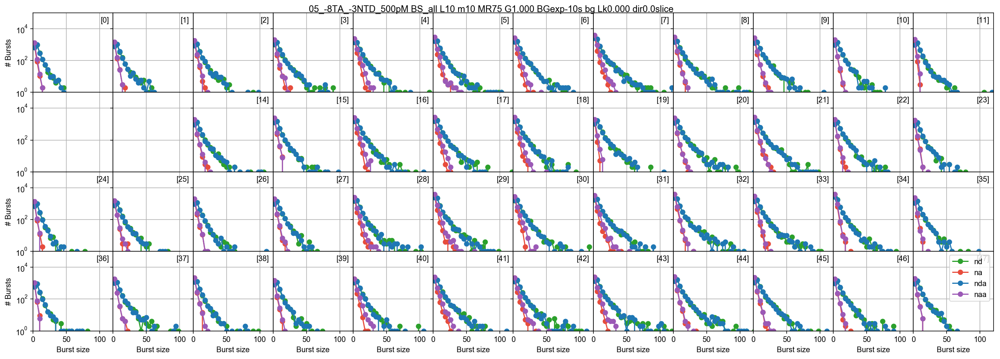

In [54]:
kws = dict(skip_ch=skip_ch, hspace=0, wspace=0, top=0.96, 
           title_bg=False, title_nbursts=False, title='in')

dplot(d75nf, hist_size_all, **kws)
plt.xlim(0, 120)
plt.ylim(1, 1e5)
plt.legend()
plt.savefig(f'{fig_name_nf_75kcps}_burst_size_all_ph-streams_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

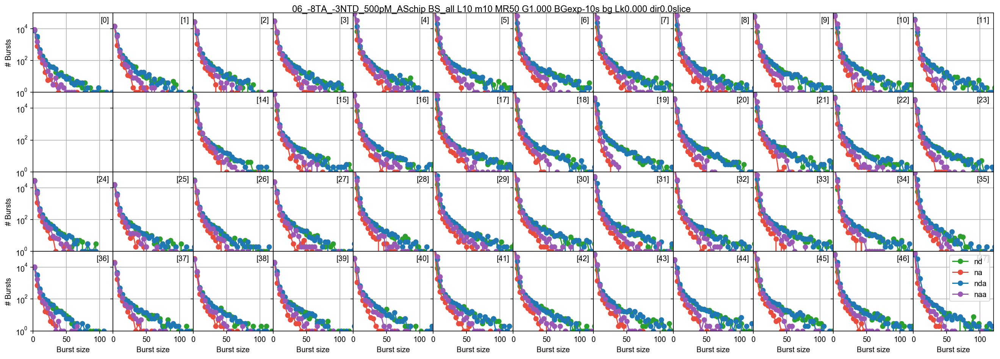

In [55]:
kws = dict(skip_ch=skip_ch, hspace=0, wspace=0, top=0.96, 
           title_bg=False, title_nbursts=False, title='in')

dplot(d50f, hist_size_all, **kws)
plt.xlim(0, 120)
plt.ylim(1, 1e5)
plt.legend()
plt.savefig(f'{fig_name_f_50kcps}_burst_size_all_ph-streams_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

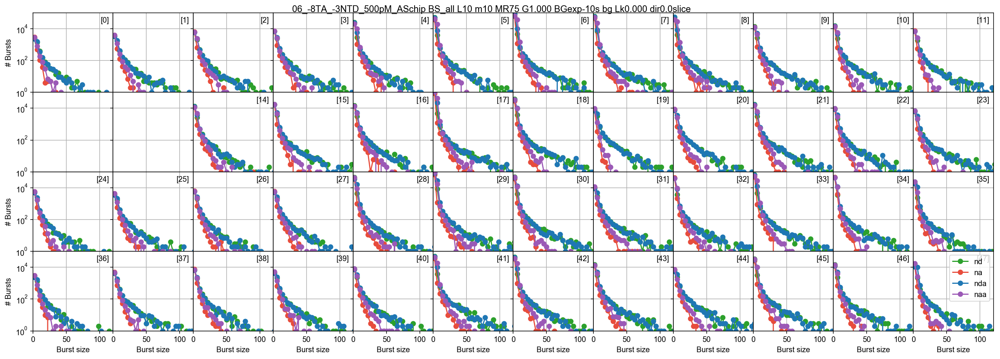

In [56]:
kws = dict(skip_ch=skip_ch, hspace=0, wspace=0, top=0.96, 
           title_bg=False, title_nbursts=False, title='in')

dplot(d75f, hist_size_all, **kws)
plt.xlim(0, 120)
plt.ylim(1, 1e5)
plt.legend()
plt.savefig(f'{fig_name_f_75kcps}_burst_size_all_ph-streams_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

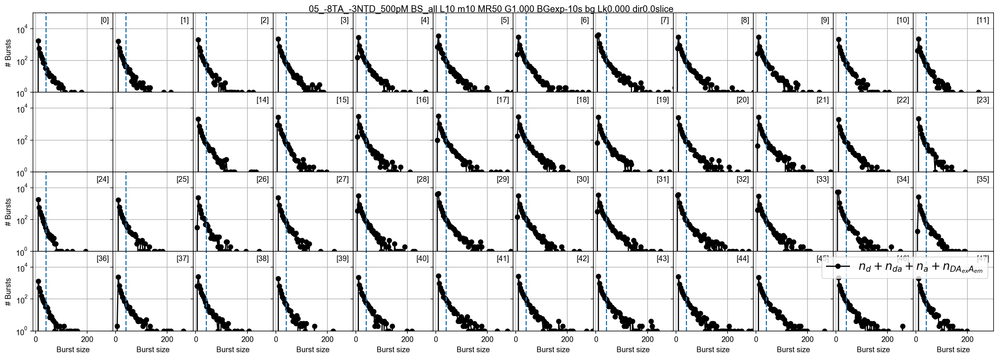

In [57]:
size_th = 40
size_sel_kws = dict(ph_sel=Ph_sel(Dex='DAem', Aex='DAem'),
                    na_comp=False, naa_comp=False, naa_aexonly=False)
dplot(d50nf, hist_size, vline=size_th, **size_sel_kws, **kws);
plt.xlim(-10, 300)
plt.ylim(1, 1e5)
plt.legend(fontsize=15, loc='upper right')
Math(d0._burst_sizes_pax_formula(**size_sel_kws))
plt.savefig(f'{fig_name_nf_50kcps}_burst_size_all_photons_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

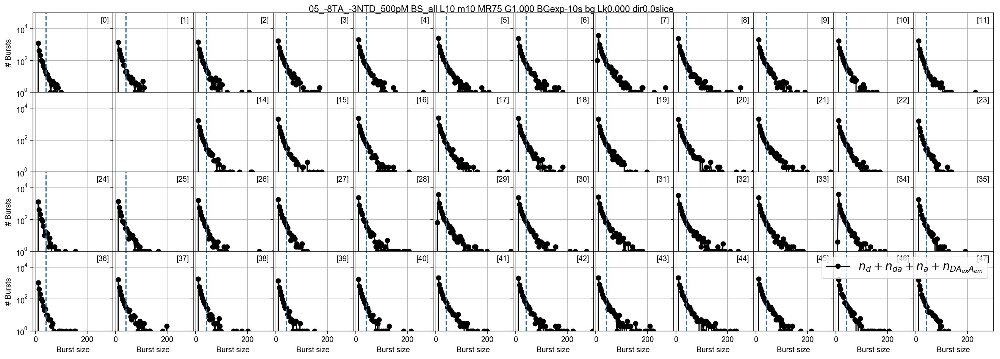

In [58]:
size_th = 40
size_sel_kws = dict(ph_sel=Ph_sel(Dex='DAem', Aex='DAem'),
                    na_comp=False, naa_comp=False, naa_aexonly=False)
dplot(d75nf, hist_size, vline=size_th, **size_sel_kws, **kws);
plt.xlim(-10, 300)
plt.ylim(1, 1e5)
plt.legend(fontsize=15, loc='upper right')
Math(d0._burst_sizes_pax_formula(**size_sel_kws))
plt.savefig(f'{fig_name_nf_75kcps}_burst_size_all_photons_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

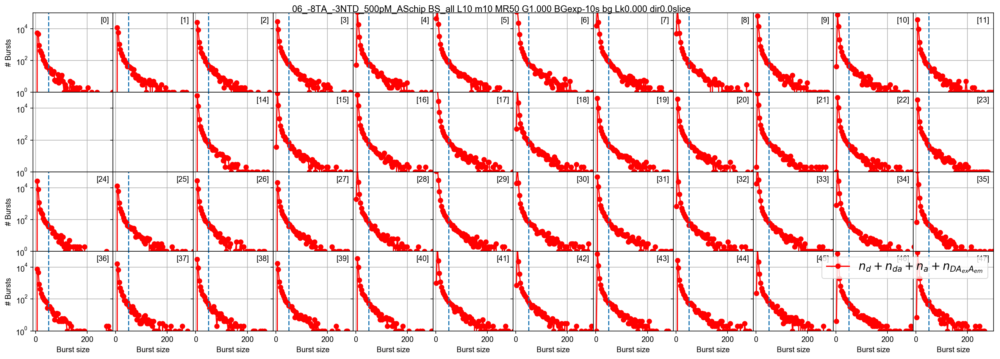

In [59]:
kws = dict(skip_ch=skip_ch, hspace=0, wspace=0, top=0.96, 
           title_bg=False, title_nbursts=False, title='in', color='r')

size_th = 50
size_sel_kws = dict(ph_sel=Ph_sel(Dex='DAem', Aex='DAem'),
                    na_comp=False, naa_comp=False, naa_aexonly=False)
dplot(d50f, hist_size, vline=size_th, **size_sel_kws, **kws);
plt.xlim(-10, 300)
plt.ylim(1, 1e5)
plt.legend(fontsize=15, loc='upper right')
Math(d1._burst_sizes_pax_formula(**size_sel_kws))
plt.savefig(f'{fig_name_f_50kcps}_burst_size_all_photons_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

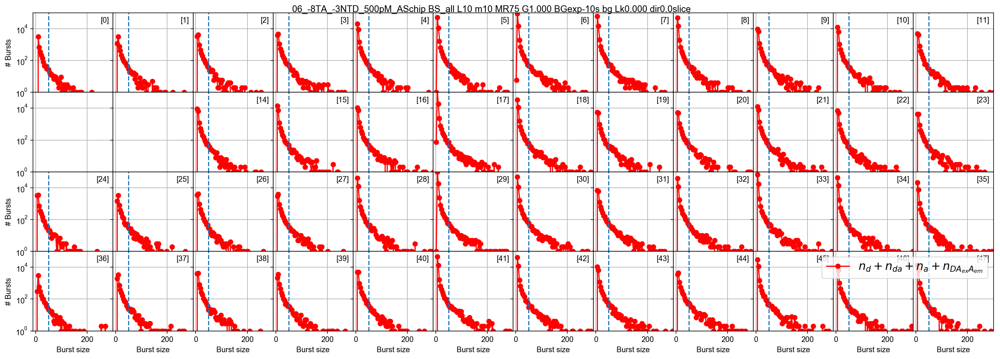

In [60]:
kws = dict(skip_ch=skip_ch, hspace=0, wspace=0, top=0.96, 
           title_bg=False, title_nbursts=False, title='in', color='r')

size_th = 50
size_sel_kws = dict(ph_sel=Ph_sel(Dex='DAem', Aex='DAem'),
                    na_comp=False, naa_comp=False, naa_aexonly=False)
dplot(d75f, hist_size, vline=size_th, **size_sel_kws, **kws);
plt.xlim(-10, 300)
plt.ylim(1, 1e5)
plt.legend(fontsize=15, loc='upper right')
Math(d1._burst_sizes_pax_formula(**size_sel_kws))
plt.savefig(f'{fig_name_f_75kcps}_burst_size_all_photons_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

In [61]:
bs_mean_nf_50kcps = []
bs_mean_nf_75kcps = []
bs_mean_f_50kcps = []
bs_mean_f_75kcps = []

for i in range(48):
    sizes_ch = d50nf.burst_sizes_pax_ich(i, **size_sel_kws) 
    tail = sizes_ch > size_th
    bs_mean_nf_50kcps.append(sizes_ch[tail].mean() - size_th)
    
for i in range(48):
    sizes_ch = d75nf.burst_sizes_pax_ich(i, **size_sel_kws) 
    tail = sizes_ch > size_th
    bs_mean_nf_75kcps.append(sizes_ch[tail].mean() - size_th)
    
for i in range(48):
    sizes_ch = d50f.burst_sizes_pax_ich(i, **size_sel_kws) 
    tail = sizes_ch > size_th
    bs_mean_f_50kcps.append(sizes_ch[tail].mean() - size_th)
    
for i in range(48):
    sizes_ch = d75f.burst_sizes_pax_ich(i, **size_sel_kws) 
    tail = sizes_ch > size_th
    bs_mean_f_75kcps.append(sizes_ch[tail].mean() - size_th)

/Users/maya/anaconda3/envs/py37-fb/lib/python3.7/site-packages/ipykernel_launcher.py:9: RuntimeWarning: Mean of empty slice.
  if __name__ == '__main__':
/Users/maya/anaconda3/envs/py37-fb/lib/python3.7/site-packages/numpy/core/_methods.py:85: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/maya/anaconda3/envs/py37-fb/lib/python3.7/site-packages/ipykernel_launcher.py:14: RuntimeWarning: Mean of empty slice.
  


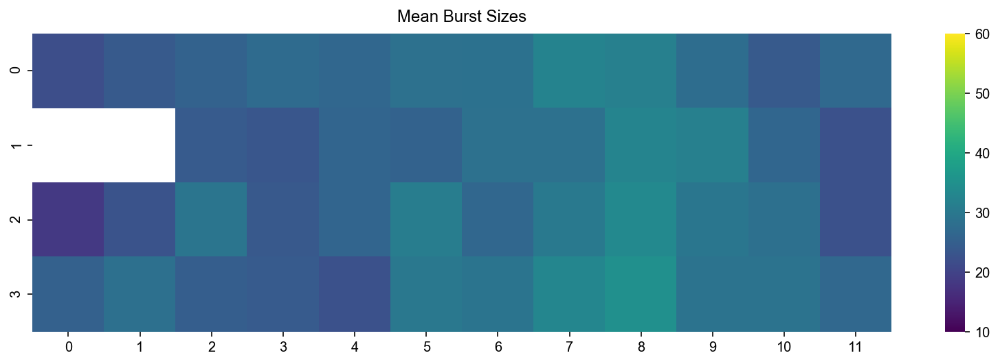

In [62]:
heatmap48(bs_mean_nf_50kcps, cmap='viridis', skip_ch=skip_ch,
          title="Mean Burst Sizes", vmin=10, vmax=60)
plt.savefig(f'{fig_name_nf_50kcps}_heatmap_burst_sizes.png', 
            bbox_to_anchor='tight', dpi = 1200);

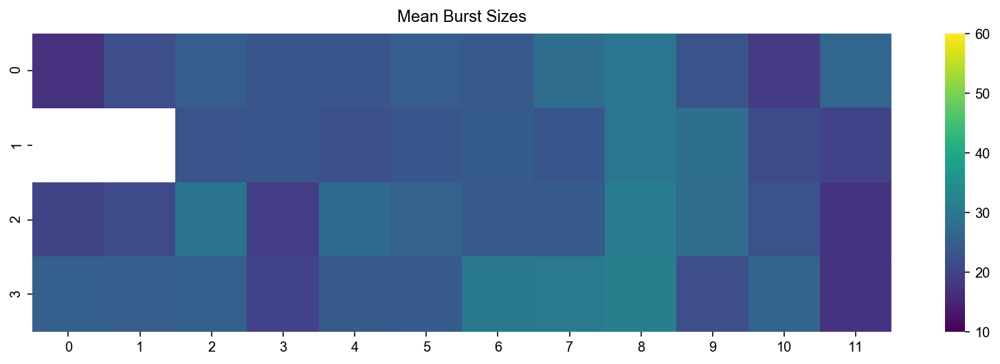

In [63]:
heatmap48(bs_mean_nf_75kcps, cmap='viridis', skip_ch=skip_ch,
          title="Mean Burst Sizes", vmin=10, vmax=60)
plt.savefig(f'{fig_name_nf_75kcps}_heatmap_burst_sizes.png', 
            bbox_to_anchor='tight', dpi = 1200);

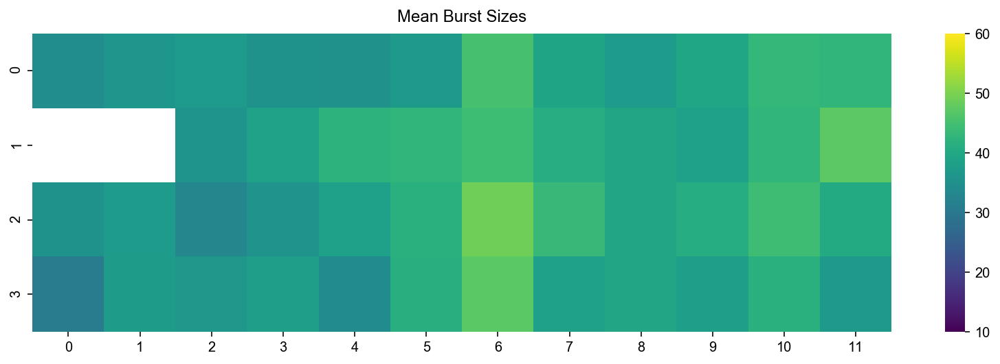

In [64]:
heatmap48(bs_mean_f_50kcps, cmap='viridis', skip_ch=skip_ch,
          title="Mean Burst Sizes", vmin=10, vmax=60)
plt.savefig(f'{fig_name_f_50kcps}_heatmap_burst_sizes.png', 
            bbox_to_anchor='tight', dpi = 1200);

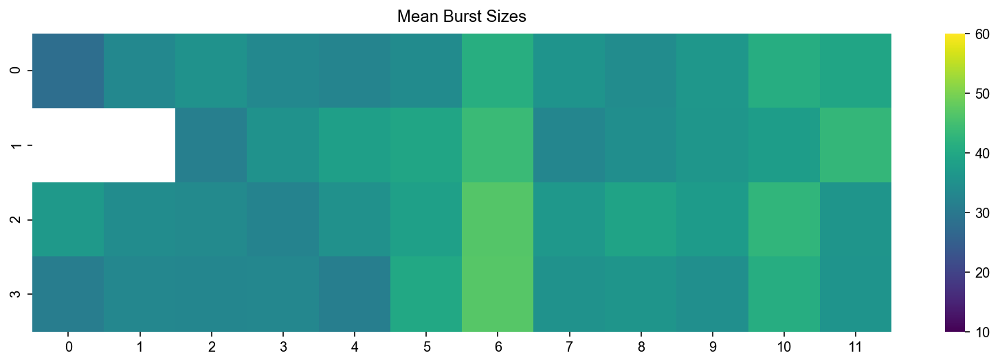

In [65]:
heatmap48(bs_mean_f_75kcps, cmap='viridis', skip_ch=skip_ch,
          title="Mean Burst Sizes", vmin=10, vmax=60)
plt.savefig(f'{fig_name_f_75kcps}_heatmap_burst_sizes.png', 
            bbox_to_anchor='tight', dpi = 1200);

# Burst duration distribution 

In [66]:
kws = dict(skip_ch=skip_ch, hspace=0, wspace=0, top=0.96, 
           title_bg=False, title_nbursts=False, title='in', color='k')

In [67]:
width_th = 0.4

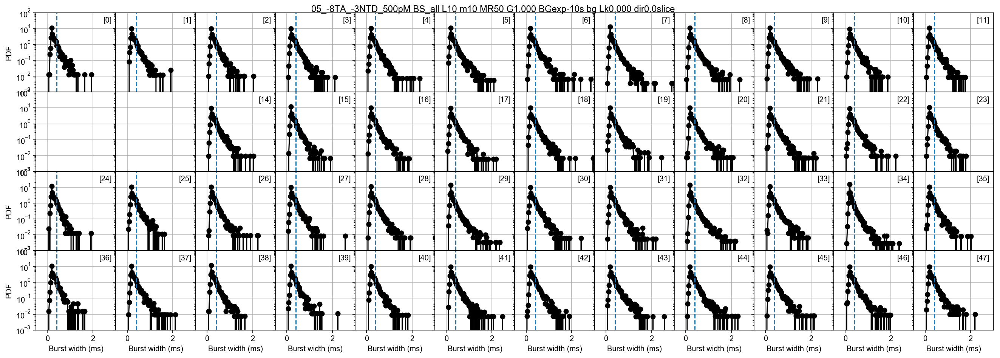

In [68]:
dplot(d50nf, hist_width, vline=width_th, **kws)
plt.xlim(-0.5, 3)
plt.ylim(1e-3, 1e2)
plt.savefig(f'{fig_name_nf_50kcps}_burst_duration_all_photons_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

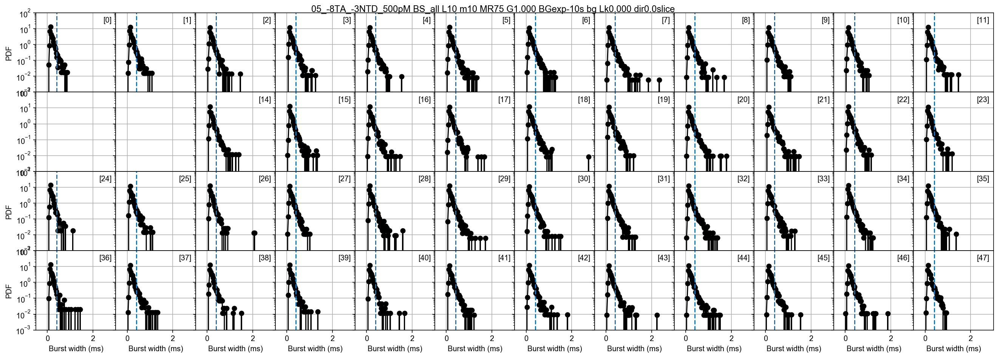

In [69]:
dplot(d75nf, hist_width, vline=width_th, **kws);
plt.xlim(-0.5, 3)
plt.ylim(1e-3, 1e2)
plt.savefig(f'{fig_name_nf_75kcps}_burst_duration_all_photons_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

In [70]:
kws = dict(skip_ch=skip_ch, hspace=0, wspace=0, top=0.96, 
           title_bg=False, title_nbursts=False, title='in', color='r')

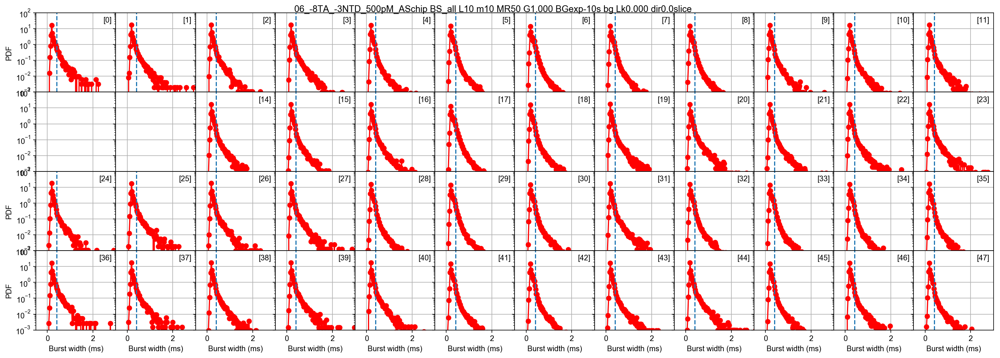

In [71]:
dplot(d50f, hist_width, vline=width_th, **kws);
plt.xlim(-0.5, 3)
plt.ylim(1e-3, 1e2)
plt.savefig(f'{fig_name_f_50kcps}_burst_duration_all_photons_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

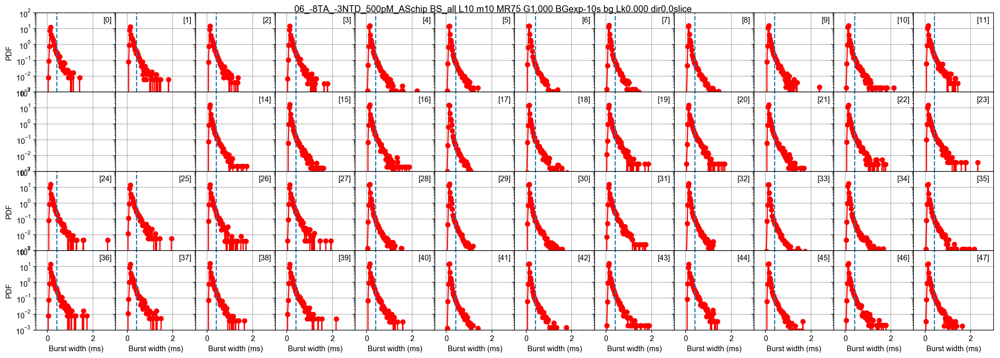

In [72]:
dplot(d75f, hist_width, vline=width_th, **kws);
plt.xlim(-0.5, 3)
plt.ylim(1e-3, 1e2)
plt.savefig(f'{fig_name_f_75kcps}_burst_duration_all_photons_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

In [73]:
bw_mean_nf_50kcps = []
bw_mean_nf_75kcps = []
bw_mean_f_50kcps = []
bw_mean_f_75kcps = []

for i in range(48):
    widths_ch = d50nf.mburst[i].width * d50nf.clk_p * 1e3
    tail = widths_ch > width_th
    bw_mean_nf_50kcps.append(widths_ch[tail].mean() - width_th)
    
for i in range(48):
    widths_ch = d75nf.mburst[i].width * d75nf.clk_p * 1e3
    tail = widths_ch > width_th
    bw_mean_nf_75kcps.append(widths_ch[tail].mean() - width_th)
    
for i in range(48):
    widths_ch = d50f.mburst[i].width * d50f.clk_p * 1e3
    tail = widths_ch > width_th
    bw_mean_f_50kcps.append(widths_ch[tail].mean() - width_th)
    
for i in range(48):
    widths_ch = d75f.mburst[i].width * d75f.clk_p * 1e3
    tail = widths_ch > width_th
    bw_mean_f_75kcps.append(widths_ch[tail].mean() - width_th)

/Users/maya/anaconda3/envs/py37-fb/lib/python3.7/site-packages/ipykernel_launcher.py:14: RuntimeWarning: Mean of empty slice.
  


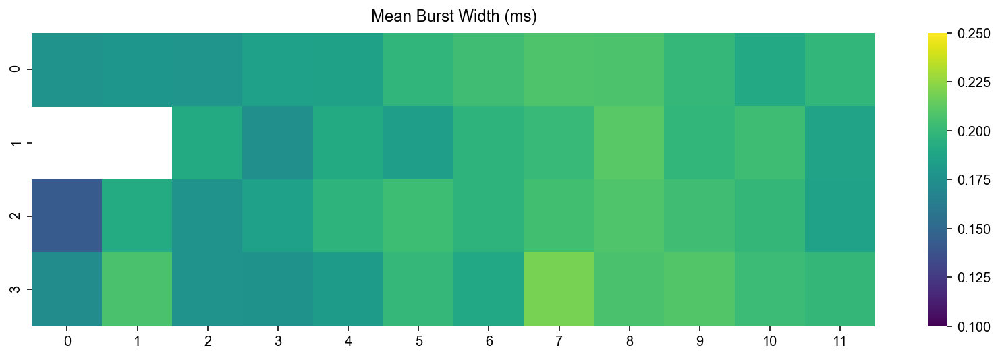

In [74]:
heatmap48(bw_mean_nf_50kcps, cmap='viridis', skip_ch=skip_ch,
          title="Mean Burst Width (ms)", vmin=0.1, vmax=0.25)
plt.savefig(f'{fig_name_nf_50kcps}_heatmap_burst_widths.png', 
            bbox_to_anchor='tight', dpi = 1200);

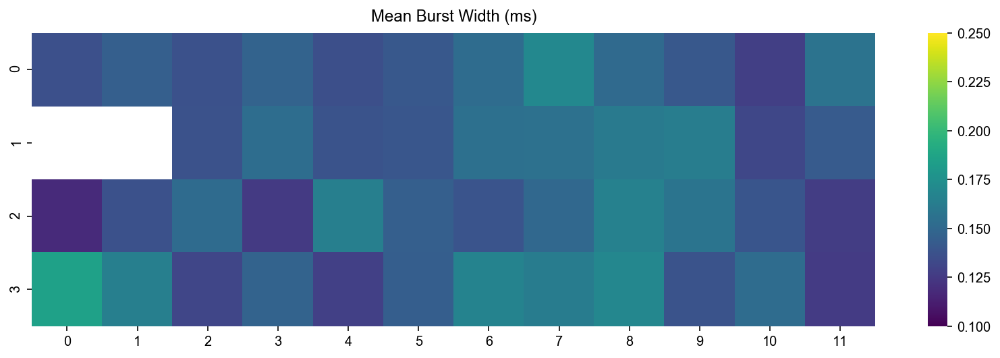

In [75]:
heatmap48(bw_mean_nf_75kcps, cmap='viridis', skip_ch=skip_ch,
          title="Mean Burst Width (ms)", vmin=0.1, vmax=0.25)
plt.savefig(f'{fig_name_nf_75kcps}_heatmap_burst_widths.png', 
            bbox_to_anchor='tight', dpi = 1200);

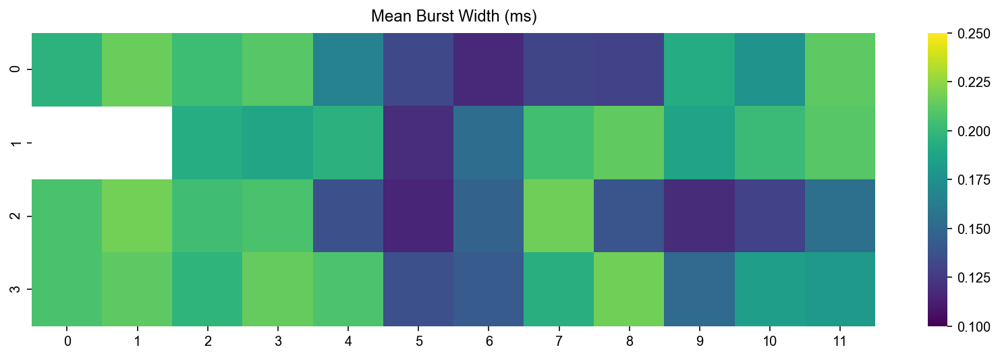

In [76]:
heatmap48(bw_mean_f_50kcps, cmap='viridis', skip_ch=skip_ch,
          title="Mean Burst Width (ms)", vmin=0.1, vmax=0.25)
plt.savefig(f'{fig_name_f_50kcps}_heatmap_burst_widths.png', 
            bbox_to_anchor='tight', dpi = 1200);

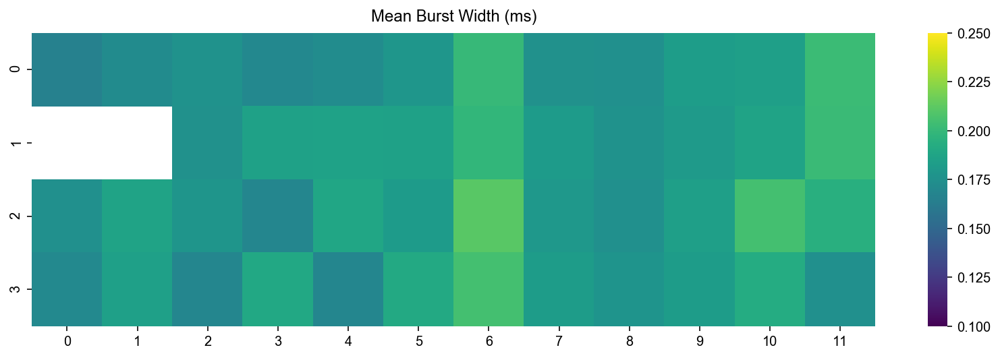

In [77]:
heatmap48(bw_mean_f_75kcps, cmap='viridis', skip_ch=skip_ch,
          title="Mean Burst Width (ms)", vmin=0.1, vmax=0.25)
plt.savefig(f'{fig_name_f_75kcps}_heatmap_burst_widths.png', 
            bbox_to_anchor='tight', dpi = 1200);

# Peak photon rate distribution

In [78]:
%run -i cal_phrates.py 

<Figure size 432x288 with 0 Axes>

In [79]:
# Use recompute=True if changing burst-search parameters
recompute = False
phrates = {}
streams = ('all', 'DexDem', 'AexDem', 'DexAem', 'AexAem', )

In [80]:
phrates_nf_50kcps = {}
for stream in streams:
    print(f' - Computing peak photon rates for {Ph_sel.from_str(stream)} stream.')
    cal_phrate(d50nf, stream=Ph_sel.from_str(stream), 
               bsearch_params=bsearch_params_50kcps, 
               phrates=phrates_nf_50kcps, recompute=recompute)
    

 - Computing peak photon rates for all stream.
   Valid fraction (mean of all ch): 100.0
 - Computing peak photon rates for DexDem stream.
   Valid fraction (mean of all ch): 21.1
 - Computing peak photon rates for AexDem stream.
   Valid fraction (mean of all ch): 21.5
 - Computing peak photon rates for DexAem stream.
   Valid fraction (mean of all ch): 2.5
 - Computing peak photon rates for AexAem stream.
   Valid fraction (mean of all ch): 4.1


In [81]:
phrates_nf_75kcps = {}
for stream in streams:
    print(f' - Computing peak photon rates for {Ph_sel.from_str(stream)} stream.')
    cal_phrate(d75nf, stream=Ph_sel.from_str(stream), 
               bsearch_params=bsearch_params_75kcps, 
               phrates=phrates_nf_75kcps, recompute=recompute)
    

 - Computing peak photon rates for all stream.
   Valid fraction (mean of all ch): 100.0
 - Computing peak photon rates for DexDem stream.
   Valid fraction (mean of all ch): 21.0
 - Computing peak photon rates for AexDem stream.
   Valid fraction (mean of all ch): 21.3
 - Computing peak photon rates for DexAem stream.
   Valid fraction (mean of all ch): 1.4
 - Computing peak photon rates for AexAem stream.
   Valid fraction (mean of all ch): 2.3


In [82]:
phrates_f_50kcps = {}
for stream in streams:
    print(f' - Computing peak photon rates for {Ph_sel.from_str(stream)} stream.')
    cal_phrate(d50f, stream=Ph_sel.from_str(stream), 
               bsearch_params=bsearch_params_50kcps, 
               phrates=phrates_f_50kcps, recompute=recompute)
    

 - Computing peak photon rates for all stream.
   Valid fraction (mean of all ch): 100.0
 - Computing peak photon rates for DexDem stream.
   Valid fraction (mean of all ch): 2.3
 - Computing peak photon rates for AexDem stream.
   Valid fraction (mean of all ch): 3.8
 - Computing peak photon rates for DexAem stream.
   Valid fraction (mean of all ch): 1.3
 - Computing peak photon rates for AexAem stream.
   Valid fraction (mean of all ch): 5.4


In [83]:
phrates_f_75kcps = {}
for stream in streams:
    print(f' - Computing peak photon rates for {Ph_sel.from_str(stream)} stream.')
    cal_phrate(d75f, stream=Ph_sel.from_str(stream), 
               bsearch_params=bsearch_params_75kcps, 
               phrates=phrates_f_75kcps, recompute=recompute)
    

 - Computing peak photon rates for all stream.
   Valid fraction (mean of all ch): 100.0
 - Computing peak photon rates for DexDem stream.
   Valid fraction (mean of all ch): 6.0
 - Computing peak photon rates for AexDem stream.
   Valid fraction (mean of all ch): 6.9
 - Computing peak photon rates for DexAem stream.
   Valid fraction (mean of all ch): 1.8
 - Computing peak photon rates for AexAem stream.
   Valid fraction (mean of all ch): 5.1


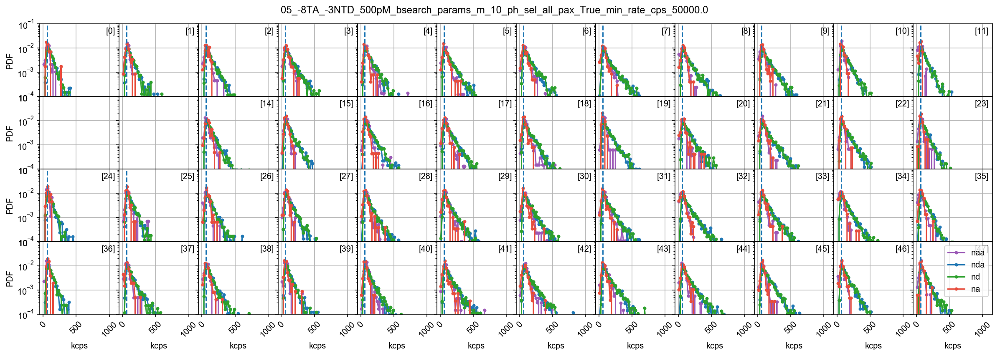

In [84]:
kws = dict(figsize=(18, 6), skip_ch=skip_ch, wspace=0, hspace=0, grid=True, 
           title=None, title_nbursts=False, title_bg=False, xrotation=45)

ax = dplot(phrates_nf_50kcps['AexAemB'], hist_burst_phrate, 
           plot_style=dict(color=bpl.purple, label='naa', ms=3), **kws)
dplot(phrates_nf_50kcps['AexDemB'], hist_burst_phrate, 
      plot_style=dict(color='C0', label='nda', ms=3), AX=ax, **kws)
dplot(phrates_nf_50kcps['DexDemB'], hist_burst_phrate, 
      plot_style=dict(color=bpl.green, label='nd', ms=3), AX=ax, **kws)
kws.update(vline=60, title='in', title_nbursts=False, title_bg=False,)
dplot(phrates_nf_50kcps['DexAemB'], hist_burst_phrate, 
      plot_style=dict(color=bpl.red, label='na', ms=3), AX=ax, **kws)
plt.xlim(-50, 1150)
plt.ylim(1e-4, 1e-1)
plt.setp(ax[:, 0], ylabel='PDF')
plt.setp(ax[-1], xlabel='kcps')
plt.suptitle(f'{fig_name_nf_50kcps[10:]}')
plt.legend()
plt.savefig(f'{fig_name_nf_50kcps}_peak_phrate_all_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

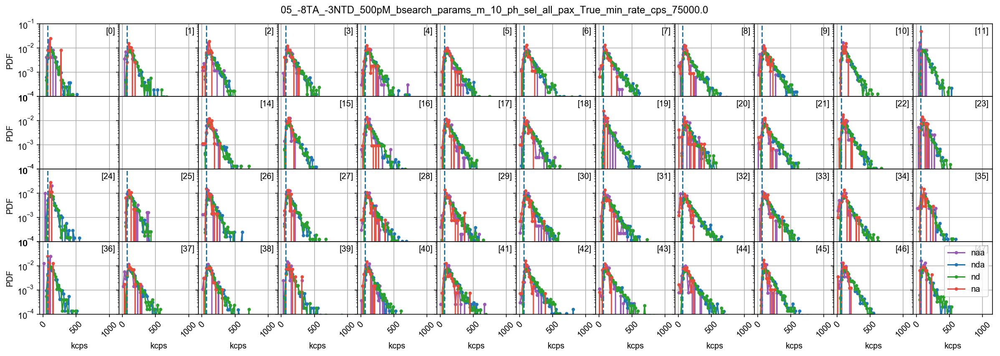

In [85]:
kws = dict(figsize=(18, 6), skip_ch=skip_ch, wspace=0, hspace=0, grid=True, 
           title=None, title_nbursts=False, title_bg=False, xrotation=45)

ax = dplot(phrates_nf_75kcps['AexAemB'], hist_burst_phrate, 
           plot_style=dict(color=bpl.purple, label='naa', ms=3), **kws)
dplot(phrates_nf_75kcps['AexDemB'], hist_burst_phrate, 
      plot_style=dict(color='C0', label='nda', ms=3), AX=ax, **kws)
dplot(phrates_nf_75kcps['DexDemB'], hist_burst_phrate, 
      plot_style=dict(color=bpl.green, label='nd', ms=3), AX=ax, **kws)
kws.update(vline=65, title='in', title_nbursts=False, title_bg=False,)
dplot(phrates_nf_75kcps['DexAemB'], hist_burst_phrate, 
      plot_style=dict(color=bpl.red, label='na', ms=3), AX=ax, **kws)
plt.xlim(-50, 1150)
plt.ylim(1e-4, 1e-1)
plt.setp(ax[:, 0], ylabel='PDF')
plt.setp(ax[-1], xlabel='kcps')
plt.suptitle(f'{fig_name_nf_75kcps[10:]}')
plt.legend()
plt.savefig(f'{fig_name_nf_75kcps}_peak_phrate_all_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

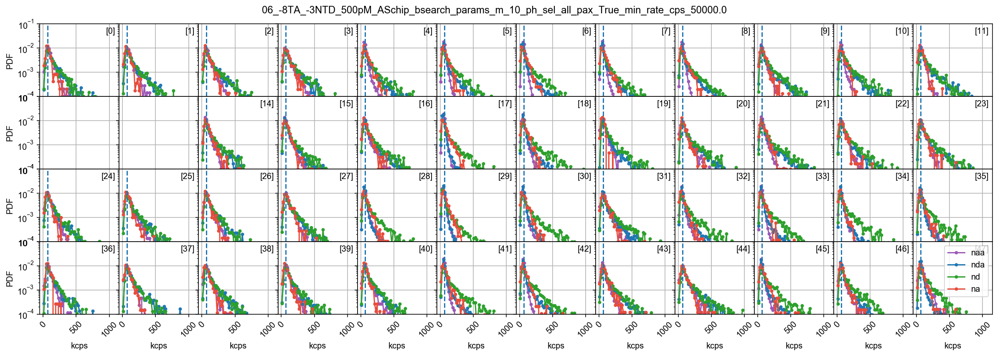

In [86]:
kws = dict(figsize=(18, 6), skip_ch=skip_ch, wspace=0, hspace=0, grid=True, 
           title=None, title_nbursts=False, title_bg=False, xrotation=45)

ax = dplot(phrates_f_50kcps['AexAemB'], hist_burst_phrate, 
           plot_style=dict(color=bpl.purple, label='naa', ms=3), **kws)
dplot(phrates_f_50kcps['AexDemB'], hist_burst_phrate, 
      plot_style=dict(color='C0', label='nda', ms=3), AX=ax, **kws)
dplot(phrates_f_50kcps['DexDemB'], hist_burst_phrate, 
      plot_style=dict(color=bpl.green, label='nd', ms=3), AX=ax, **kws)
kws.update(vline=65, title='in', title_nbursts=False, title_bg=False,)
dplot(phrates_f_50kcps['DexAemB'], hist_burst_phrate, 
      plot_style=dict(color=bpl.red, label='na', ms=3), AX=ax, **kws)
plt.xlim(-50, 1150)
plt.ylim(1e-4, 1e-1)
plt.setp(ax[:, 0], ylabel='PDF')
plt.setp(ax[-1], xlabel='kcps')
plt.suptitle(f'{fig_name_f_50kcps[10:]}')
plt.legend()
plt.savefig(f'{fig_name_f_50kcps}_peak_phrate_all_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

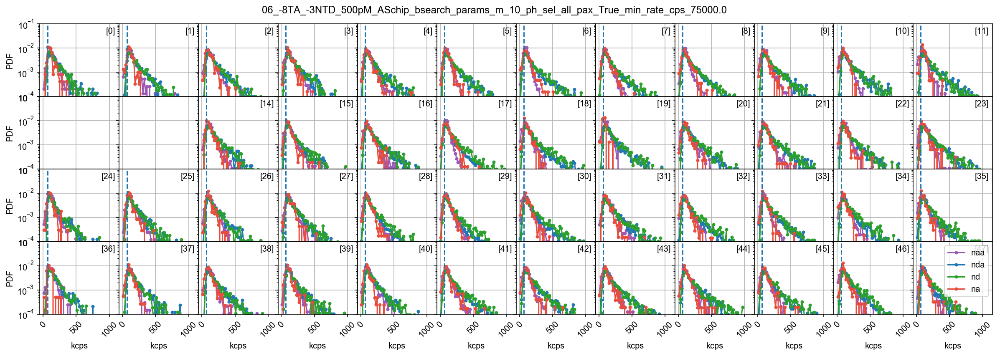

In [87]:
kws = dict(figsize=(18, 6), skip_ch=skip_ch, wspace=0, hspace=0, grid=True, 
           title=None, title_nbursts=False, title_bg=False, xrotation=45)

ax = dplot(phrates_f_75kcps['AexAemB'], hist_burst_phrate, 
           plot_style=dict(color=bpl.purple, label='naa', ms=3), **kws)
dplot(phrates_f_75kcps['AexDemB'], hist_burst_phrate, 
      plot_style=dict(color='C0', label='nda', ms=3), AX=ax, **kws)
dplot(phrates_f_75kcps['DexDemB'], hist_burst_phrate, 
      plot_style=dict(color=bpl.green, label='nd', ms=3), AX=ax, **kws)
kws.update(vline=65, title='in', title_nbursts=False, title_bg=False,)
dplot(phrates_f_75kcps['DexAemB'], hist_burst_phrate, 
      plot_style=dict(color=bpl.red, label='na', ms=3), AX=ax, **kws)
plt.xlim(-50, 1150)
plt.ylim(1e-4, 1e-1)
plt.setp(ax[:, 0], ylabel='PDF')
plt.setp(ax[-1], xlabel='kcps')
plt.suptitle(f'{fig_name_f_75kcps[10:]}')
plt.legend()
plt.savefig(f'{fig_name_f_75kcps}_peak_phrate_all_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

# Burst selection


In [88]:
size_th1 = 40 

In [89]:
size_th2 = size_th1 * power_ratio
size_th2

60.0

In [90]:
#Size selection on all bursts from the `nd`, `nda`, `na`, and `naa` photon streams
size_sel_kws = dict(ph_sel=Ph_sel(Dex='DAem', Aex='DAem'), gamma=1,
                    na_comp=False, naa_comp=False, naa_aexonly=False)

Math(d0._burst_sizes_pax_formula(**size_sel_kws))

<IPython.core.display.Math object>

In [91]:
# minimum size = 40 photons 

d50nfs40 = d50nf.select_bursts(select_bursts.size, th1=size_th1, **size_sel_kws)
Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(d50nfs40.nd, d50nfs40.na, d50nfs40.naa)]
d50nfs40.add(Su=Su)

d75nfs40 = d75nf.select_bursts(select_bursts.size, th1=size_th1, **size_sel_kws)
Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(d75nfs40.nd, d75nfs40.na, d75nfs40.naa)]
d75nfs40.add(Su=Su)

d50fs40 = d50f.select_bursts(select_bursts.size, th1=size_th1, **size_sel_kws)
Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(d50fs40.nd, d50fs40.na, d50fs40.naa)]
d50fs40.add(Su=Su)

d75fs40 = d75f.select_bursts(select_bursts.size, th1=size_th1, **size_sel_kws)
Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(d75fs40.nd, d75fs40.na, d75fs40.naa)]
d75fs40.add(Su=Su)

In [92]:
# minimum size = 60 photons 

d50nfs60 = d50nf.select_bursts(select_bursts.size, th1=size_th2, **size_sel_kws)
Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(d50nfs60.nd, d50nfs60.na, d50nfs60.naa)]
d50nfs60.add(Su=Su)

d75nfs60 = d75nf.select_bursts(select_bursts.size, th1=size_th2, **size_sel_kws)
Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(d75nfs60.nd, d75nfs60.na, d75nfs60.naa)]
d75nfs60.add(Su=Su)

d50fs60 = d50f.select_bursts(select_bursts.size, th1=size_th2, **size_sel_kws)
Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(d50fs60.nd, d50fs60.na, d50fs60.naa)]
d50fs60.add(Su=Su)

d75fs60 = d75f.select_bursts(select_bursts.size, th1=size_th2, **size_sel_kws)
Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(d75fs60.nd, d75fs60.na, d75fs60.naa)]
d75fs60.add(Su=Su)

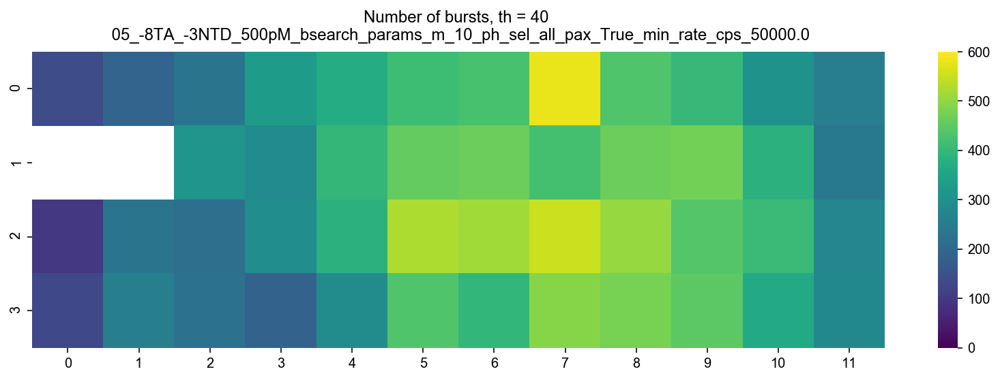

In [93]:
heatmap48(d50nfs40.num_bursts, cmap='viridis', skip_ch=skip_ch,
          title=f"Number of bursts, th = {size_th1} \n {fig_name_nf_50kcps[10:]}", vmin=0, vmax=600)
plt.savefig(f'{fig_name_nf_50kcps}_size_sel_all_{size_th1}_heatmap_number_bursts.png', 
            bbox_to_anchor='tight', dpi = 1200);

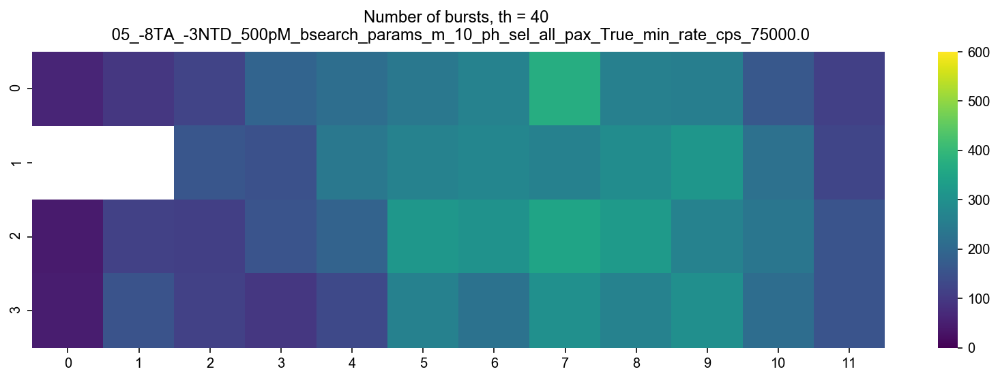

In [94]:
heatmap48(d75nfs40.num_bursts, cmap='viridis', skip_ch=skip_ch,
          title=f"Number of bursts, th = {size_th1} \n {fig_name_nf_75kcps[10:]}", vmin=0, vmax=600)
plt.savefig(f'{fig_name_nf_75kcps}_size_sel_all_{size_th1}_heatmap_number_bursts.png', 
            bbox_to_anchor='tight', dpi = 1200);

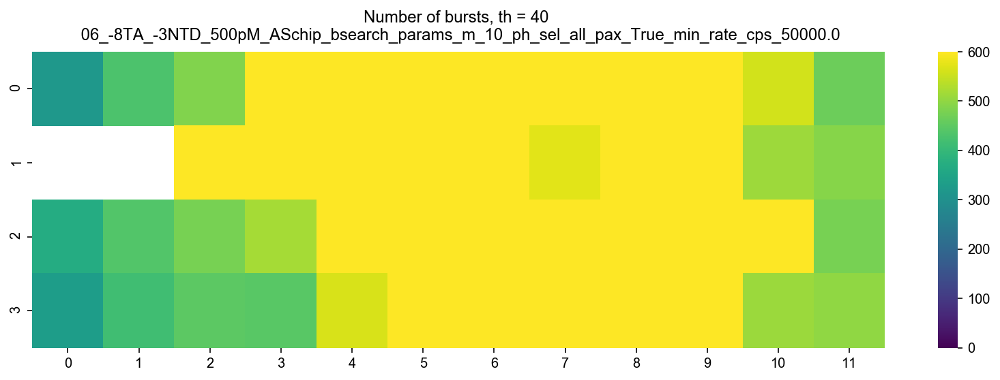

In [95]:
heatmap48(d50fs40.num_bursts, cmap='viridis', skip_ch=skip_ch,
          title=f"Number of bursts, th = {size_th1} \n {fig_name_f_50kcps[10:]}", vmin=0, vmax=600)
plt.savefig(f'{fig_name_f_50kcps}_size_sel_all_{size_th1}_heatmap_number_bursts.png', 
            bbox_to_anchor='tight', dpi = 1200);

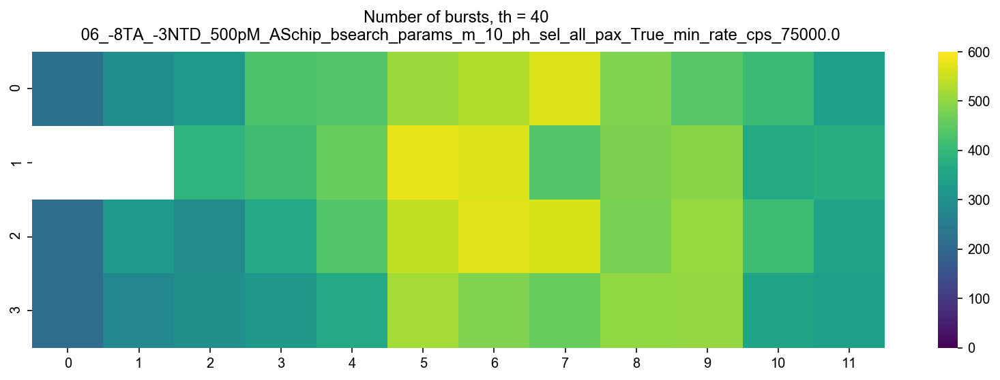

In [96]:
heatmap48(d75fs40.num_bursts, cmap='viridis', skip_ch=skip_ch,
          title=f"Number of bursts, th = {size_th1} \n {fig_name_f_75kcps[10:]}", vmin=0, vmax=600)
plt.savefig(f'{fig_name_f_75kcps}_size_sel_all_{size_th1}_heatmap_number_bursts.png', 
            bbox_to_anchor='tight', dpi = 1200);

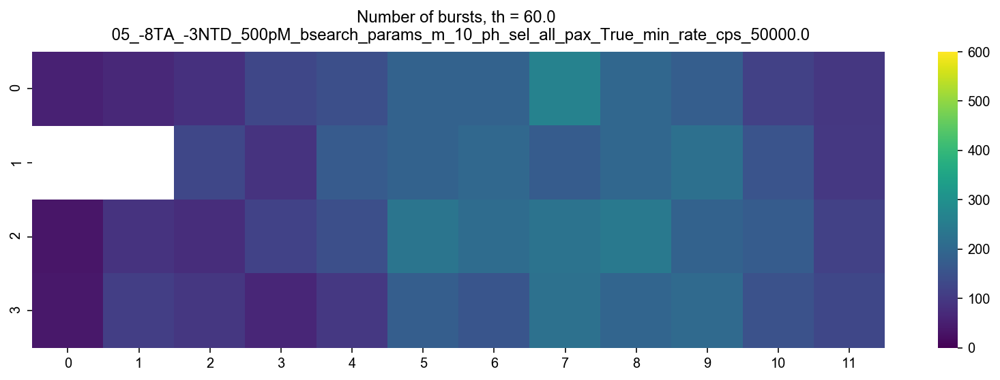

In [97]:
heatmap48(d50nfs60.num_bursts, cmap='viridis', skip_ch=skip_ch,
          title=f"Number of bursts, th = {size_th2} \n {fig_name_nf_50kcps[10:]}", vmin=0, vmax=600)
plt.savefig(f'{fig_name_nf_50kcps}_size_sel_all_{size_th2}_heatmap_number_bursts.png', 
            bbox_to_anchor='tight', dpi = 1200);

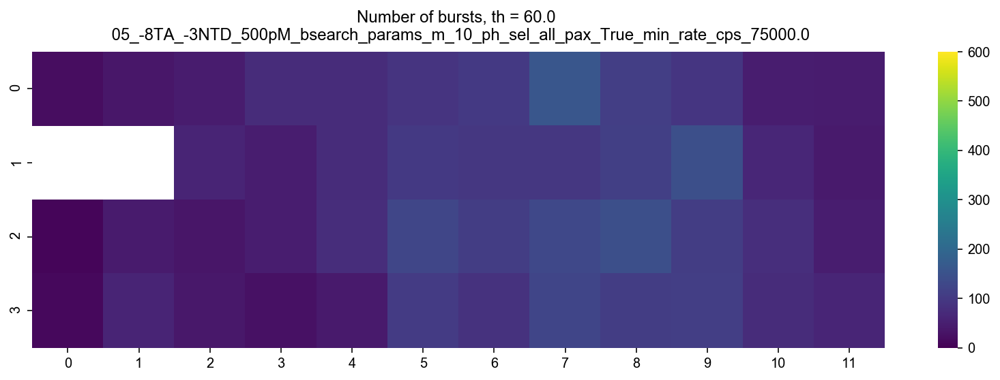

In [98]:
heatmap48(d75nfs60.num_bursts, cmap='viridis', skip_ch=skip_ch,
          title=f"Number of bursts, th = {size_th2} \n {fig_name_nf_75kcps[10:]}", vmin=0, vmax=600)
plt.savefig(f'{fig_name_nf_75kcps}_size_sel_all_{size_th2}_heatmap_number_bursts.png', 
            bbox_to_anchor='tight', dpi = 1200);

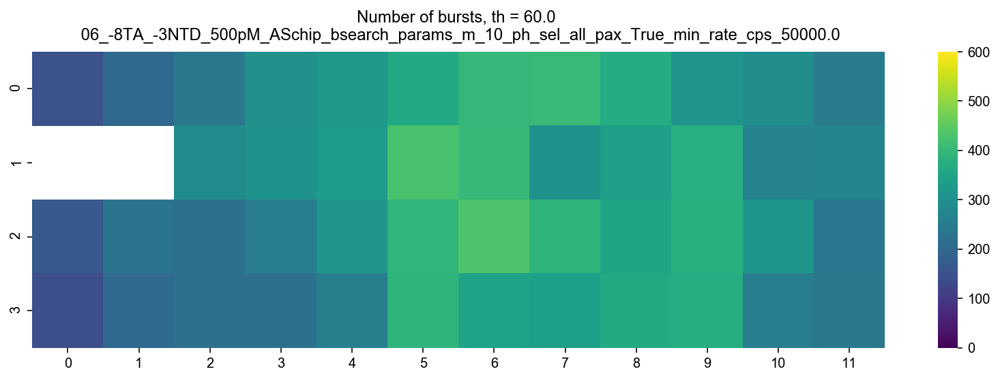

In [99]:
heatmap48(d50fs60.num_bursts, cmap='viridis', skip_ch=skip_ch,
          title=f"Number of bursts, th = {size_th2} \n {fig_name_f_50kcps[10:]}", vmin=0, vmax=600)
plt.savefig(f'{fig_name_f_50kcps}_size_sel_all_{size_th2}_heatmap_number_bursts.png', 
            bbox_to_anchor='tight', dpi = 1200);

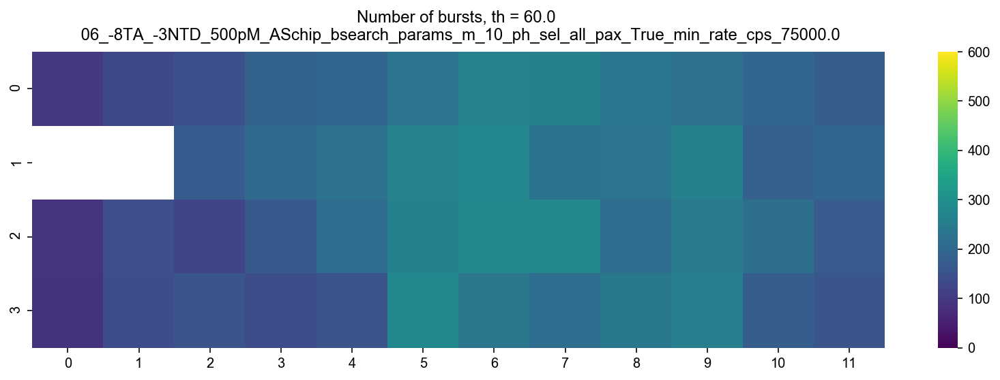

In [100]:
heatmap48(d75fs60.num_bursts, cmap='viridis', skip_ch=skip_ch,
          title=f"Number of bursts, th = {size_th2} \n {fig_name_f_75kcps[10:]}", vmin=0, vmax=600)
plt.savefig(f'{fig_name_f_75kcps}_size_sel_all_{size_th2}_heatmap_number_bursts.png', 
            bbox_to_anchor='tight', dpi = 1200);

## Size selected $E_{PR}-S_u$ histograms

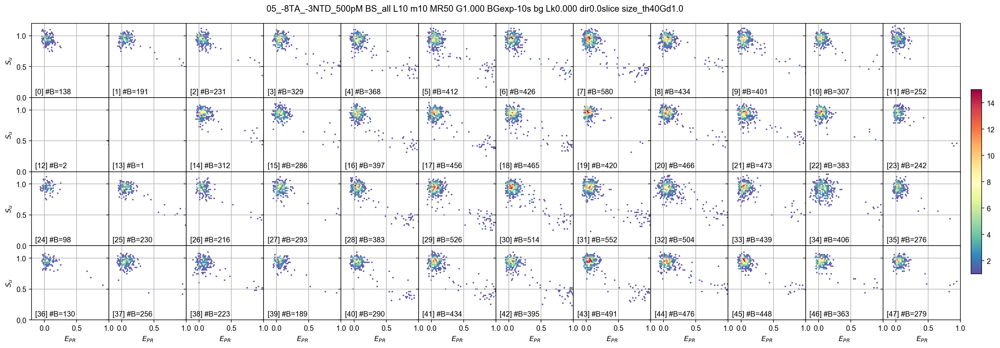

In [101]:
ax = dplot(d50nfs40, hexbin_alex, S_name='Su', vmax=15, 
           wspace=0, hspace=0, gridsize=60, title='bottom left', title_bg=False)
ax0 = ax[0, 0]
fig = ax0.figure
cax = fig.add_axes([0.97, 0.25, 0.01, 0.5])
plt.setp(ax[:, 0], ylabel='$S_u$')
plt.setp(ax[-1], xlabel='$E_{PR}$')
plt.colorbar(cax=cax)
ax0.set_xticks([0, 0.5, 1])
ax0.set_yticks([0, 0.5, 1])
ax0.set_xlim(-0.2, 1)
ax0.set_ylim(0, 1.2)
plt.savefig(f'{fig_name_nf_50kcps}_size_sel_{size_th1}_alex_hist_Su_size_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

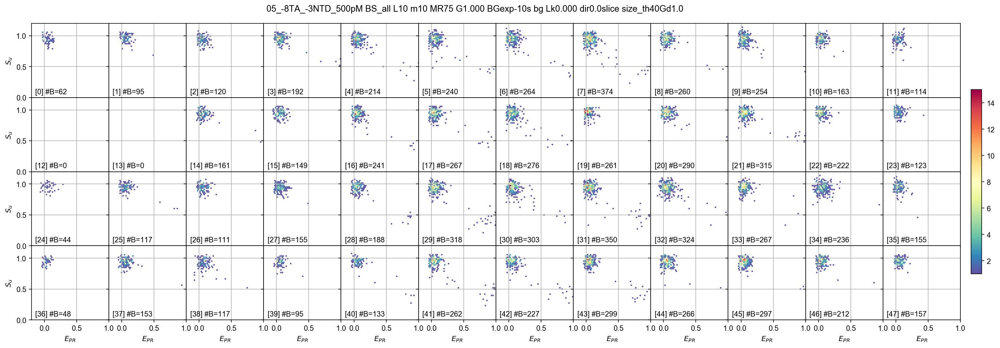

In [102]:
ax = dplot(d75nfs40, hexbin_alex, S_name='Su', vmax=15, 
           wspace=0, hspace=0, gridsize=60, title='bottom left', title_bg=False)
ax0 = ax[0, 0]
fig = ax0.figure
cax = fig.add_axes([0.97, 0.25, 0.01, 0.5])
plt.setp(ax[:, 0], ylabel='$S_u$')
plt.setp(ax[-1], xlabel='$E_{PR}$')
plt.colorbar(cax=cax)
ax0.set_xticks([0, 0.5, 1])
ax0.set_yticks([0, 0.5, 1])
ax0.set_xlim(-0.2, 1)
ax0.set_ylim(0, 1.2)
plt.savefig(f'{fig_name_nf_75kcps}_size_sel_{size_th1}_alex_hist_Su_size_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

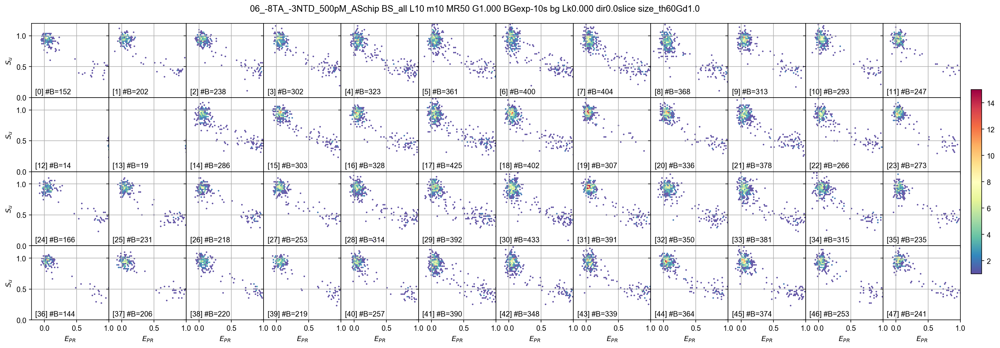

In [103]:
ax = dplot(d50fs60, hexbin_alex, S_name='Su', vmax=15, 
           wspace=0, hspace=0, gridsize=60, title='bottom left', title_bg=False);
ax0 = ax[0, 0]
fig = ax0.figure
cax = fig.add_axes([0.97, 0.25, 0.01, 0.5])
plt.setp(ax[:, 0], ylabel='$S_u$');
plt.setp(ax[-1], xlabel='$E_{PR}$');
plt.colorbar(cax=cax)
ax0.set_xticks([0, 0.5, 1])
ax0.set_yticks([0, 0.5, 1]);
ax0.set_xlim(-0.2, 1)
ax0.set_ylim(0, 1.2);
plt.savefig(f'{fig_name_f_50kcps}_size_sel_{size_th2}_alex_hist_Su_size_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

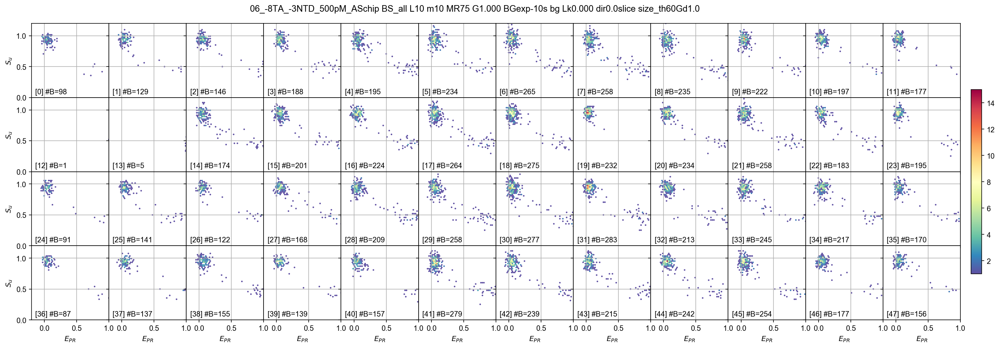

In [104]:
ax = dplot(d75fs60, hexbin_alex, S_name='Su', vmax=15, 
           wspace=0, hspace=0, gridsize=60, title='bottom left', title_bg=False);
ax0 = ax[0, 0]
fig = ax0.figure
cax = fig.add_axes([0.97, 0.25, 0.01, 0.5])
plt.setp(ax[:, 0], ylabel='$S_u$');
plt.setp(ax[-1], xlabel='$E_{PR}$');
plt.colorbar(cax=cax)
ax0.set_xticks([0, 0.5, 1])
ax0.set_yticks([0, 0.5, 1]);
ax0.set_xlim(-0.2, 1)
ax0.set_ylim(0, 1.2);
plt.savefig(f'{fig_name_f_75kcps}_size_sel_{size_th1}_alex_hist_Su_size_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

## Burst statistics after size selection

### Burst size distribution

In [105]:
kws = dict(figsize=(18, 6), skip_ch=skip_ch, wspace=0, hspace=0, grid=True, 
           title=None, title_nbursts=False, title_bg=False, xrotation=45, color='k')

In [106]:
size_sel_kws = dict(ph_sel=Ph_sel(Dex='DAem', Aex='DAem'),
                    na_comp=False, naa_comp=False, naa_aexonly=False)

Math(d0._burst_sizes_pax_formula(**size_sel_kws))

<IPython.core.display.Math object>

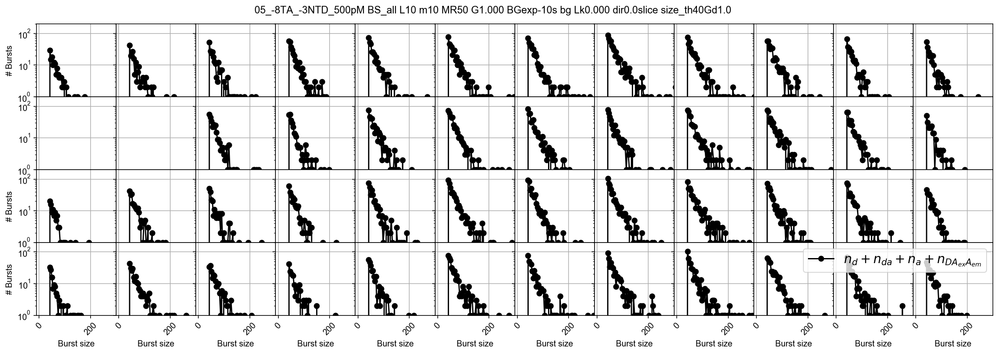

In [107]:
dplot(d50nfs40, hist_size, **size_sel_kws, **kws);
plt.xlim(-10, 300)
plt.ylim(1, 2e2)
plt.legend(fontsize=15, loc='upper right')
Math(d0._burst_sizes_pax_formula(**size_sel_kws))
plt.savefig(f'{fig_name_nf_50kcps}_burst_size_all_photons_size_sel_{size_th1}_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

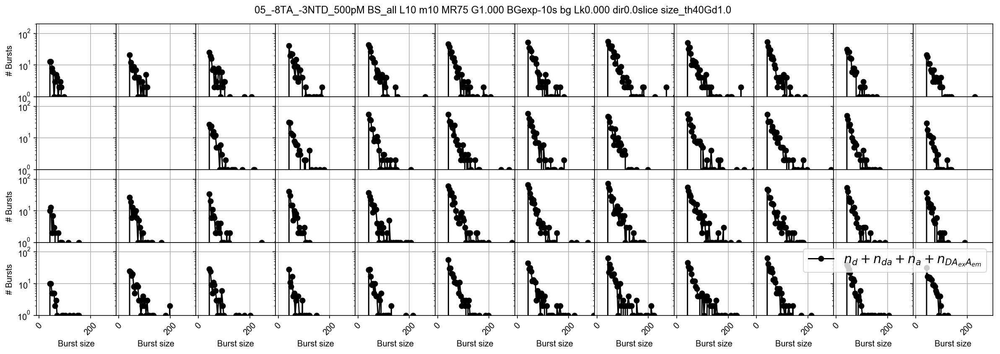

In [108]:
size_sel_kws = dict(ph_sel=Ph_sel(Dex='DAem', Aex='DAem'),
                    na_comp=False, naa_comp=False, naa_aexonly=False)
dplot(d75nfs40, hist_size, **size_sel_kws, **kws);
plt.xlim(-10, 300)
plt.ylim(1, 2e2)
plt.legend(fontsize=15, loc='upper right')
Math(d0._burst_sizes_pax_formula(**size_sel_kws))
plt.savefig(f'{fig_name_nf_75kcps}_burst_size_all_photons_size_sel_{size_th1}_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

In [109]:
kws = dict(figsize=(18, 6), skip_ch=skip_ch, wspace=0, hspace=0, grid=True, 
           title=None, title_nbursts=False, title_bg=False, xrotation=45, color='r')

In [110]:
size_sel_kws = dict(ph_sel=Ph_sel(Dex='DAem', Aex='DAem'),
                    na_comp=False, naa_comp=False, naa_aexonly=False)

Math(d1._burst_sizes_pax_formula(**size_sel_kws))

<IPython.core.display.Math object>

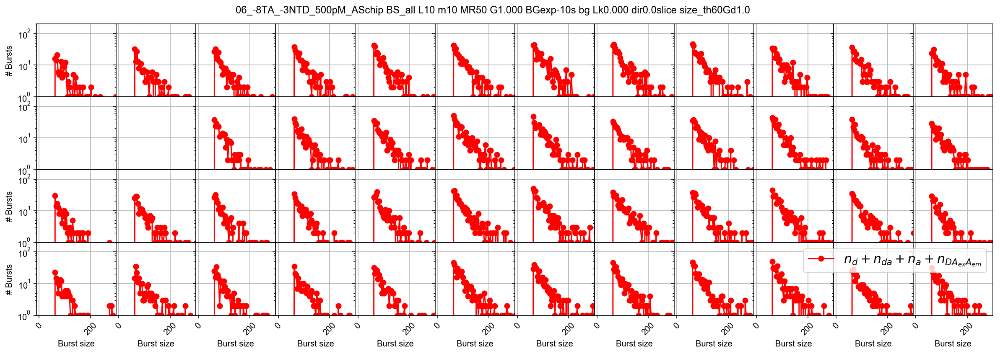

In [111]:
dplot(d50fs60, hist_size, **size_sel_kws, **kws);
plt.xlim(-10, 300)
plt.ylim(1, 2e2)
plt.legend(fontsize=15, loc='upper right')
Math(d1._burst_sizes_pax_formula(**size_sel_kws))
plt.savefig(f'{fig_name_f_50kcps}_burst_size_all_photons_size_sel_{size_th2}_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

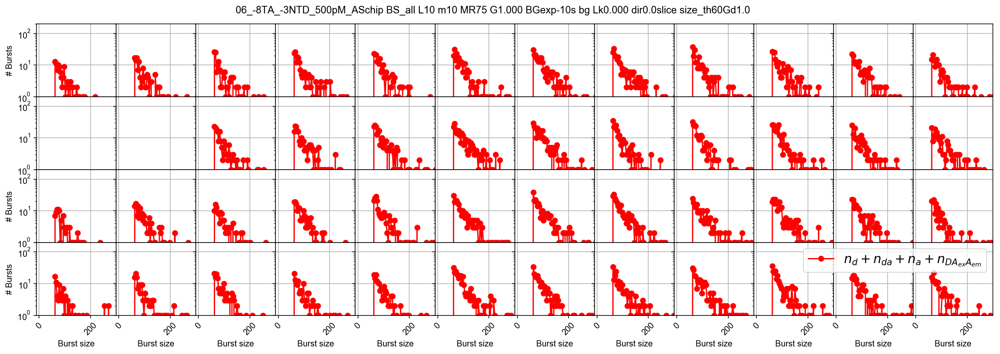

In [112]:
dplot(d75fs60, hist_size, **size_sel_kws, **kws);
plt.xlim(-10, 300)
plt.ylim(1, 2e2)
plt.legend(fontsize=15, loc='upper right')
Math(d1._burst_sizes_pax_formula(**size_sel_kws))
plt.savefig(f'{fig_name_f_75kcps}_burst_size_all_photons_size_sel_{size_th2}_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

### Burst duration distribution

In [113]:
kws = dict(figsize=(18, 6), skip_ch=skip_ch, wspace=0, hspace=0, grid=True, 
           title=None, title_nbursts=False, title_bg=False, xrotation=45, color='k')

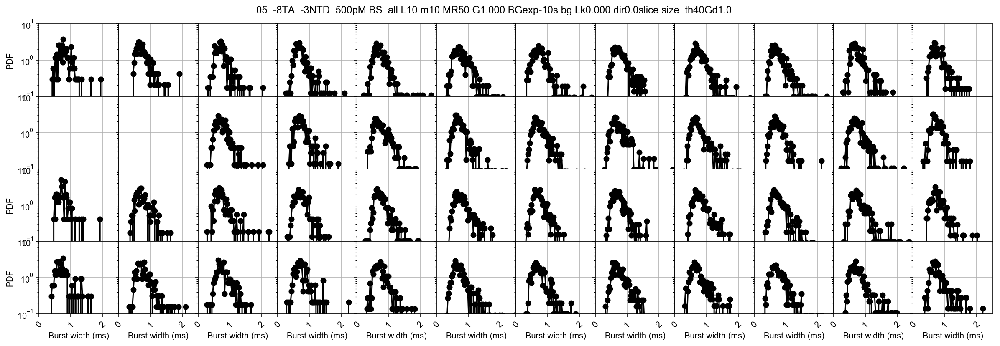

In [114]:
dplot(d50nfs40, hist_width, **kws);
plt.xlim(0, 2.5)
plt.ylim(1e-1, 1e1)
plt.savefig(f'{fig_name_nf_50kcps}_burst_duration_all_photons_size_sel_{size_th1}_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

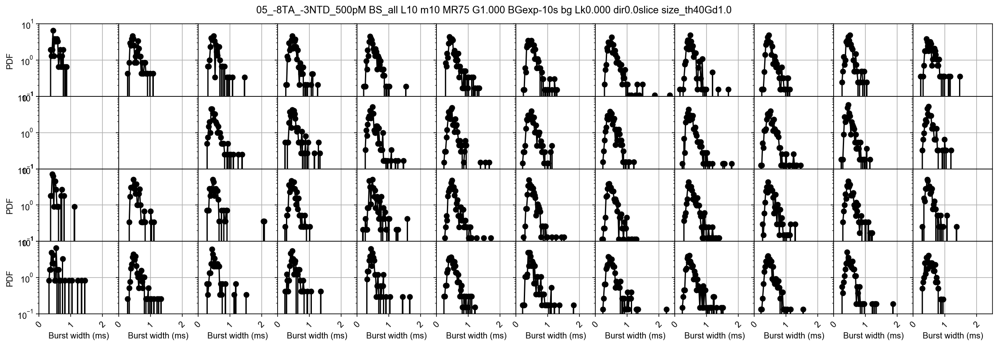

In [115]:
dplot(d75nfs40, hist_width, **kws);
plt.xlim(0, 2.5)
plt.ylim(1e-1, 1e1)
plt.savefig(f'{fig_name_nf_75kcps}_burst_duration_all_photons_size_sel_{size_th1}_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

In [116]:
kws = dict(figsize=(18, 6), skip_ch=skip_ch, wspace=0, hspace=0, grid=True, 
           title=None, title_nbursts=False, title_bg=False, xrotation=45, color='r')

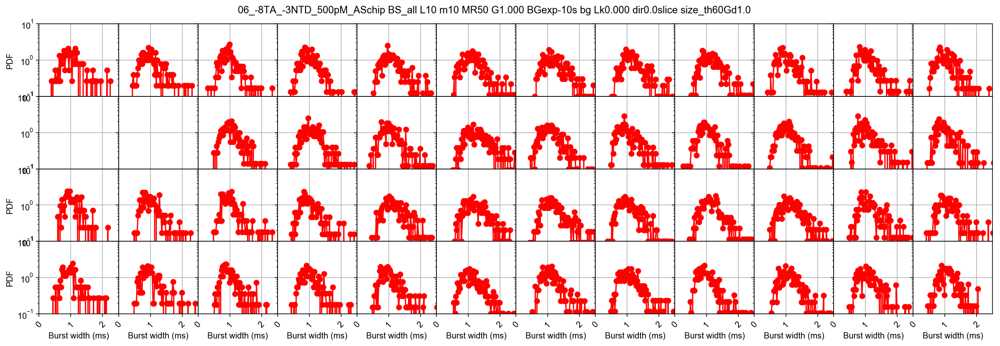

In [117]:
dplot(d50fs60, hist_width, **kws);
plt.xlim(0, 2.5)
plt.ylim(1e-1, 1e1)
plt.savefig(f'{fig_name_f_50kcps}_burst_duration_all_photons_size_sel_{size_th2}_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

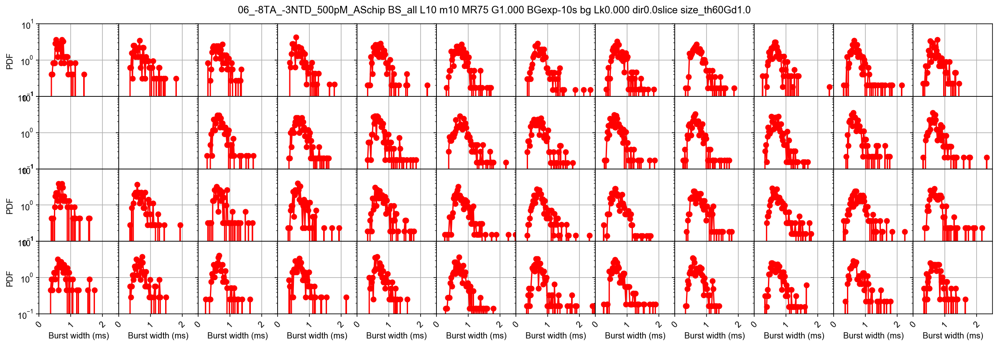

In [118]:
dplot(d75fs60, hist_width, **kws);
plt.xlim(0, 2.5)
plt.ylim(1e-1, 1e1)
plt.savefig(f'{fig_name_f_75kcps}_burst_duration_all_photons_size_sel_{size_th2}_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

### Peak photon rates

In [119]:
phrates_nfs40_50kcps = {}
for stream in streams:
    print(f' - Computing peak photon rates for {Ph_sel.from_str(stream)} stream.')
    cal_phrate(d50nfs40, stream=Ph_sel.from_str(stream), 
               bsearch_params=bsearch_params_50kcps, 
               phrates=phrates_nfs40_50kcps, recompute=recompute)
    

 - Computing peak photon rates for all stream.
   Valid fraction (mean of all ch): 100.0
 - Computing peak photon rates for DexDem stream.
   Valid fraction (mean of all ch): 21.1
 - Computing peak photon rates for AexDem stream.
   Valid fraction (mean of all ch): 21.5
 - Computing peak photon rates for DexAem stream.
   Valid fraction (mean of all ch): 2.5
 - Computing peak photon rates for AexAem stream.
   Valid fraction (mean of all ch): 4.1


In [120]:
phrates_nfs40_75kcps = {}
for stream in streams:
    print(f' - Computing peak photon rates for {Ph_sel.from_str(stream)} stream.')
    cal_phrate(d75nfs40, stream=Ph_sel.from_str(stream), 
               bsearch_params=bsearch_params_75kcps, 
               phrates=phrates_nfs40_75kcps, recompute=recompute)
    

 - Computing peak photon rates for all stream.
   Valid fraction (mean of all ch): 100.0
 - Computing peak photon rates for DexDem stream.
   Valid fraction (mean of all ch): 21.0
 - Computing peak photon rates for AexDem stream.
   Valid fraction (mean of all ch): 21.3
 - Computing peak photon rates for DexAem stream.
   Valid fraction (mean of all ch): 1.4
 - Computing peak photon rates for AexAem stream.
   Valid fraction (mean of all ch): 2.3


In [121]:
phrates_fs60_50kcps = {}
for stream in streams:
    print(f' - Computing peak photon rates for {Ph_sel.from_str(stream)} stream.')
    cal_phrate(d50fs60, stream=Ph_sel.from_str(stream), 
               bsearch_params=bsearch_params_50kcps, 
               phrates=phrates_fs60_50kcps, recompute=recompute)
    

 - Computing peak photon rates for all stream.
   Valid fraction (mean of all ch): 100.0
 - Computing peak photon rates for DexDem stream.
   Valid fraction (mean of all ch): 2.3
 - Computing peak photon rates for AexDem stream.
   Valid fraction (mean of all ch): 3.8
 - Computing peak photon rates for DexAem stream.
   Valid fraction (mean of all ch): 1.3
 - Computing peak photon rates for AexAem stream.
   Valid fraction (mean of all ch): 5.4


In [122]:
phrates_fs60_75kcps = {}
for stream in streams:
    print(f' - Computing peak photon rates for {Ph_sel.from_str(stream)} stream.')
    cal_phrate(d75fs60, stream=Ph_sel.from_str(stream), 
               bsearch_params=bsearch_params_75kcps, 
               phrates=phrates_fs60_75kcps, recompute=recompute)
    

 - Computing peak photon rates for all stream.
   Valid fraction (mean of all ch): 100.0
 - Computing peak photon rates for DexDem stream.
   Valid fraction (mean of all ch): 6.0
 - Computing peak photon rates for AexDem stream.
   Valid fraction (mean of all ch): 6.9
 - Computing peak photon rates for DexAem stream.
   Valid fraction (mean of all ch): 1.8
 - Computing peak photon rates for AexAem stream.
   Valid fraction (mean of all ch): 5.1


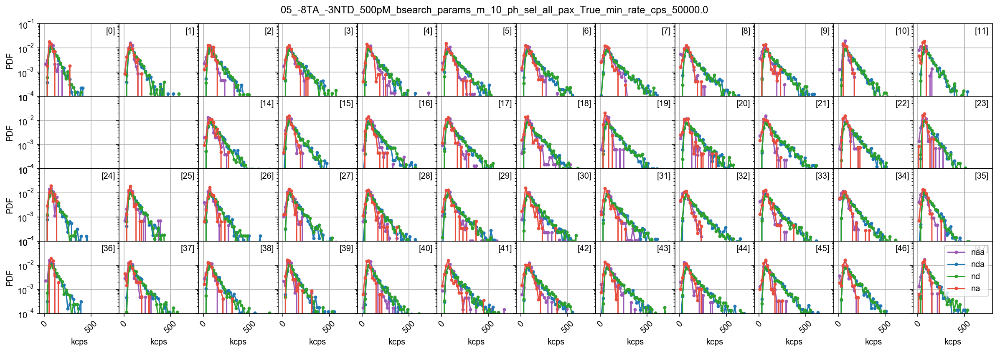

In [123]:
kws = dict(figsize=(18, 6), skip_ch=skip_ch, wspace=0, hspace=0, grid=True, 
           title=None, title_nbursts=False, title_bg=False, xrotation=45)

ax = dplot(phrates_nfs40_50kcps['AexAemB'], hist_burst_phrate, 
           plot_style=dict(color=bpl.purple, label='naa', ms=3), **kws)
dplot(phrates_nfs40_50kcps['AexDemB'], hist_burst_phrate, 
      plot_style=dict(color='C0', label='nda', ms=3), AX=ax, **kws)
dplot(phrates_nfs40_50kcps['DexDemB'], hist_burst_phrate, 
      plot_style=dict(color=bpl.green, label='nd', ms=3), AX=ax, **kws)
kws.update(title='in', title_nbursts=False, title_bg=False,)
dplot(phrates_nfs40_50kcps['DexAemB'], hist_burst_phrate, 
      plot_style=dict(color=bpl.red, label='na', ms=3), AX=ax, **kws)
plt.xlim(-50, 800)
plt.ylim(1e-4, 1e-1)
plt.setp(ax[:, 0], ylabel='PDF')
plt.setp(ax[-1], xlabel='kcps')
plt.suptitle(f'{fig_name_nf_50kcps[10:]}')
plt.legend()
plt.savefig(f'{fig_name_nf_50kcps}_peak_phrate_all_size_sel_{size_th1}_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

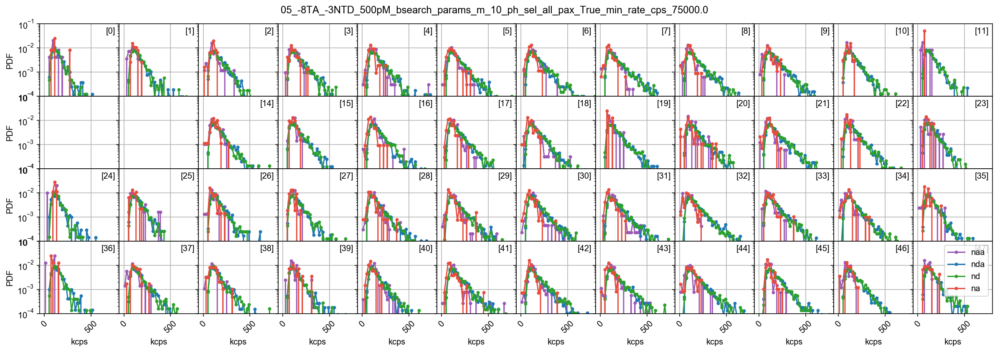

In [124]:
kws = dict(figsize=(18, 6), skip_ch=skip_ch, wspace=0, hspace=0, grid=True, 
           title=None, title_nbursts=False, title_bg=False, xrotation=45)

ax = dplot(phrates_nfs40_75kcps['AexAemB'], hist_burst_phrate, 
           plot_style=dict(color=bpl.purple, label='naa', ms=3), **kws)
dplot(phrates_nfs40_75kcps['AexDemB'], hist_burst_phrate, 
      plot_style=dict(color='C0', label='nda', ms=3), AX=ax, **kws)
dplot(phrates_nfs40_75kcps['DexDemB'], hist_burst_phrate, 
      plot_style=dict(color=bpl.green, label='nd', ms=3), AX=ax, **kws)
kws.update(title='in', title_nbursts=False, title_bg=False,)
dplot(phrates_nfs40_75kcps['DexAemB'], hist_burst_phrate, 
      plot_style=dict(color=bpl.red, label='na', ms=3), AX=ax, **kws)
plt.xlim(-50, 800)
plt.ylim(1e-4, 1e-1)
plt.setp(ax[:, 0], ylabel='PDF')
plt.setp(ax[-1], xlabel='kcps')
plt.suptitle(f'{fig_name_nf_75kcps[10:]}')
plt.legend()
plt.savefig(f'{fig_name_nf_75kcps}_peak_phrate_all_size_sel_{size_th1}_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

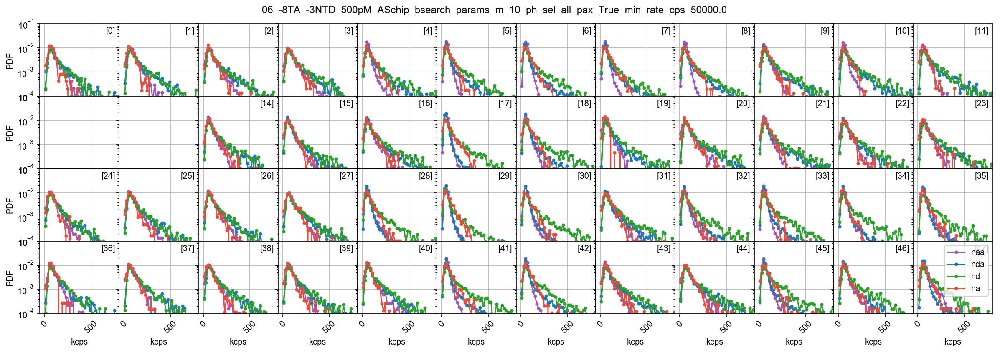

In [125]:
kws = dict(figsize=(18, 6), skip_ch=skip_ch, wspace=0, hspace=0, grid=True, 
           title=None, title_nbursts=False, title_bg=False, xrotation=45)

ax = dplot(phrates_fs60_50kcps['AexAemB'], hist_burst_phrate, 
           plot_style=dict(color=bpl.purple, label='naa', ms=3), **kws)
dplot(phrates_fs60_50kcps['AexDemB'], hist_burst_phrate, 
      plot_style=dict(color='C0', label='nda', ms=3), AX=ax, **kws)
dplot(phrates_fs60_50kcps['DexDemB'], hist_burst_phrate, 
      plot_style=dict(color=bpl.green, label='nd', ms=3), AX=ax, **kws)
kws.update(title='in', title_nbursts=False, title_bg=False,)
dplot(phrates_fs60_50kcps['DexAemB'], hist_burst_phrate, 
      plot_style=dict(color=bpl.red, label='na', ms=3), AX=ax, **kws)
plt.xlim(-50, 800)
plt.ylim(1e-4, 1e-1)
plt.setp(ax[:, 0], ylabel='PDF')
plt.setp(ax[-1], xlabel='kcps')
plt.suptitle(f'{fig_name_f_50kcps[10:]}')
plt.legend()
plt.savefig(f'{fig_name_f_50kcps}_peak_phrate_all_size_sel_{size_th2}_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

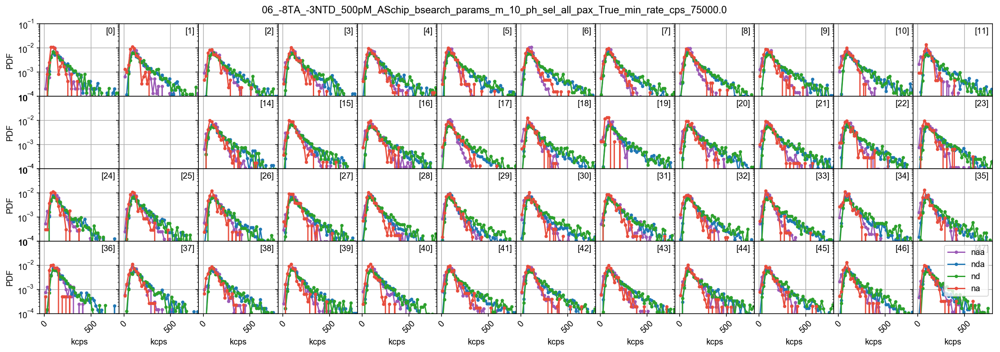

In [126]:
kws = dict(figsize=(18, 6), skip_ch=skip_ch, wspace=0, hspace=0, grid=True, 
           title=None, title_nbursts=False, title_bg=False, xrotation=45)

ax = dplot(phrates_fs60_75kcps['AexAemB'], hist_burst_phrate, 
           plot_style=dict(color=bpl.purple, label='naa', ms=3), **kws)
dplot(phrates_fs60_75kcps['AexDemB'], hist_burst_phrate, 
      plot_style=dict(color='C0', label='nda', ms=3), AX=ax, **kws)
dplot(phrates_fs60_75kcps['DexDemB'], hist_burst_phrate, 
      plot_style=dict(color=bpl.green, label='nd', ms=3), AX=ax, **kws)
kws.update(title='in', title_nbursts=False, title_bg=False,)
dplot(phrates_fs60_75kcps['DexAemB'], hist_burst_phrate, 
      plot_style=dict(color=bpl.red, label='na', ms=3), AX=ax, **kws)
plt.xlim(-50, 800)
plt.ylim(1e-4, 1e-1)
plt.setp(ax[:, 0], ylabel='PDF')
plt.setp(ax[-1], xlabel='kcps')
plt.suptitle(f'{fig_name_f_75kcps[10:]}')
plt.legend()
plt.savefig(f'{fig_name_f_75kcps}_peak_phrate_all_size_sel_{size_th2}_48spots.png', 
            bbox_to_anchor='tight', dpi = 1200);

# Collapse

Pooling data from all 48 spots

In [127]:
# pooled data before size selection

d50nfc = d50nf.collapse(update_gamma=False)
d75nfc = d75nf.collapse(update_gamma=False)

d50fc = d50f.collapse(update_gamma=False)
d75fc = d75f.collapse(update_gamma=False)

In [128]:
# check that chi_ch is set to 1 here
d50nfc.chi_ch, d75nfc.chi_ch, d50fc.chi_ch, d75fc.chi_ch

(1.0, 1.0, 1.0, 1.0)

In [129]:
burst_sums = []

for d in d_list:
    sum = d.num_bursts.sum()
    burst_sums.append(sum)
    
burst_sums

[260600, 185173, 5707133, 1605305]

In [130]:
no_flow_bsearch_ratio = burst_sums[1]/ burst_sums[0] 
print(f'Number of bursts decrease {no_flow_bsearch_ratio:.1f}x when using 75kcps burst search (compared to 50kcps)')

Number of bursts decrease 0.7x when using 75kcps burst search (compared to 50kcps)


In [131]:
flow_bsearch_ratio = burst_sums[3]/ burst_sums[2] 
print(f'Number of bursts decrease {flow_bsearch_ratio:.1f}x when using 75kcps burst search (compared to 50kcps)')

Number of bursts decrease 0.3x when using 75kcps burst search (compared to 50kcps)


In [132]:
no_flow_vs_flow_ratio_50v50 = burst_sums[2] / burst_sums[0] 
print(f'Number of bursts increase {no_flow_vs_flow_ratio_50v50:.0f}x when flow is applied using the same burst search parameters')

Number of bursts increase 22x when flow is applied using the same burst search parameters


In [133]:
no_flow_vs_flow_ratio_50v75 = burst_sums[3] / burst_sums[0] 
print(f'Number of bursts increase {no_flow_vs_flow_ratio_50v75:.0f}x when flow is applied using a burst search parameter scaled by {power_ratio}x for measurement with flow')

Number of bursts increase 6x when flow is applied using a burst search parameter scaled by 1.5x for measurement with flow


## Burst selection matrix

In [134]:
# pooled data after size selection 

d50nfs40c = d50nfs40.collapse(update_gamma=False)
d75nfs40c = d75nfs40.collapse(update_gamma=False)
d50nfs60c = d50nfs60.collapse(update_gamma=False)
d75nfs60c = d75nfs60.collapse(update_gamma=False)

d50fs40c = d50fs40.collapse(update_gamma=False)
d75fs40c = d75fs40.collapse(update_gamma=False)
d50fs60c = d50fs60.collapse(update_gamma=False)
d75fs60c = d75fs60.collapse(update_gamma=False)

In [135]:
import collections

In [136]:
dsc_dict = collections.OrderedDict(nf50s40c=d50nfs40c, nf75s40c=d75nfs40c, nf50s60c=d50nfs60c, 
                nf75s60c=d75nfs60c, f50s40c=d50fs40c, f75s40c=d75fs40c, 
                f50s60c=d50fs60c, f75s60c=d75fs60c)
dsc_dict.keys()

odict_keys(['nf50s40c', 'nf75s40c', 'nf50s60c', 'nf75s60c', 'f50s40c', 'f75s40c', 'f50s60c', 'f75s60c'])

In [137]:
naa_sel_kws = dict(ph_sel=Ph_sel(Aex='Aem'), gamma=1,
                   na_comp=False, naa_comp=False, naa_aexonly=False)

Math(d0._burst_sizes_pax_formula(**naa_sel_kws))

<IPython.core.display.Math object>

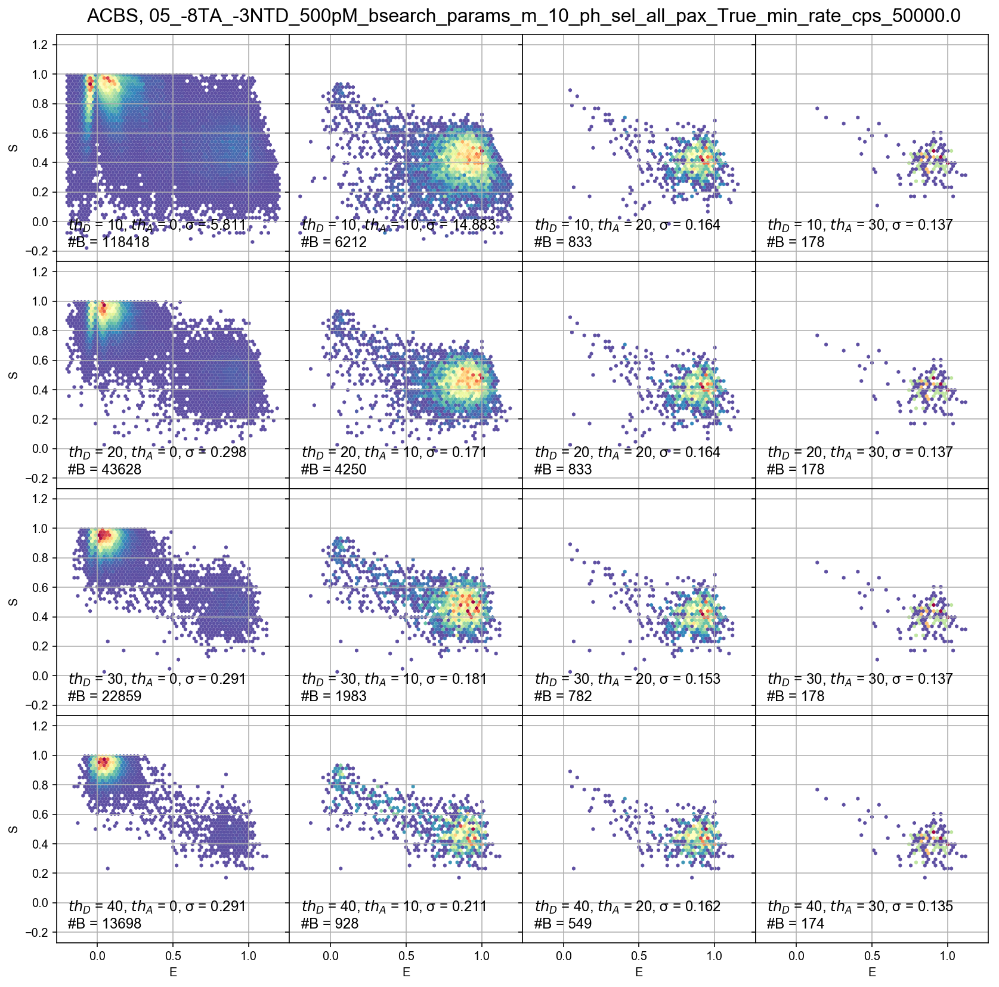

In [138]:
Th = (10, 20, 30, 40)
Th_naa = np.array((0, 10, 20, 30)) 
fig, AX = plt.subplots(len(Th), len(Th_naa), figsize=(3.5*len(Th_naa), 3.5*len(Th)), sharex=True, sharey=True)
for irow, th in enumerate(Th):
    for icol, th_naa in enumerate(Th_naa):
        ax = AX[irow,icol]
        d50nfs = d50nf.select_bursts(select_bursts.size, th1=th_naa, **naa_sel_kws)
        d50nfss = d50nfs.select_bursts(select_bursts.size, th1=th, **size_sel_kws)
        d50nfssc = d50nfss.collapse(update_gamma=False)
        Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(d50nfssc.nd, d50nfssc.na, d50nfssc.naa)]
        d50nfssc.add(Su=Su)
        E = d50nfssc.E[0]
        E_std = E[E > 0.2].std()
        dplot(d50nfssc, hexbin_alex, S_name='Su', gridsize=60, ax=ax)
        ax.text(0.05, 0.05, '$th_D$ = %d, $th_A$ = %d, σ = %.3f\n#B = %d' % (th, th_naa, E_std, d50nfssc.num_bursts), 
                va='bottom', ha='left', transform=ax.transAxes, fontsize=12)
        ax.set_title('')
plt.setp(AX[:-1], xlabel='')
plt.setp(AX[:, 1:], ylabel='')
plt.subplots_adjust(hspace=0, wspace=0)
plt.text(0.15, 0.89, f'ACBS, {fig_name_nf_50kcps[10:]}', transform=fig.transFigure, fontsize=16)
plt.savefig(f'{fig_name_nf_50kcps}_ACBS_size_sel_matrix_alex_hist_Su_48spot.png', 
            bbox_to_anchor='tight', dpi = 1200);

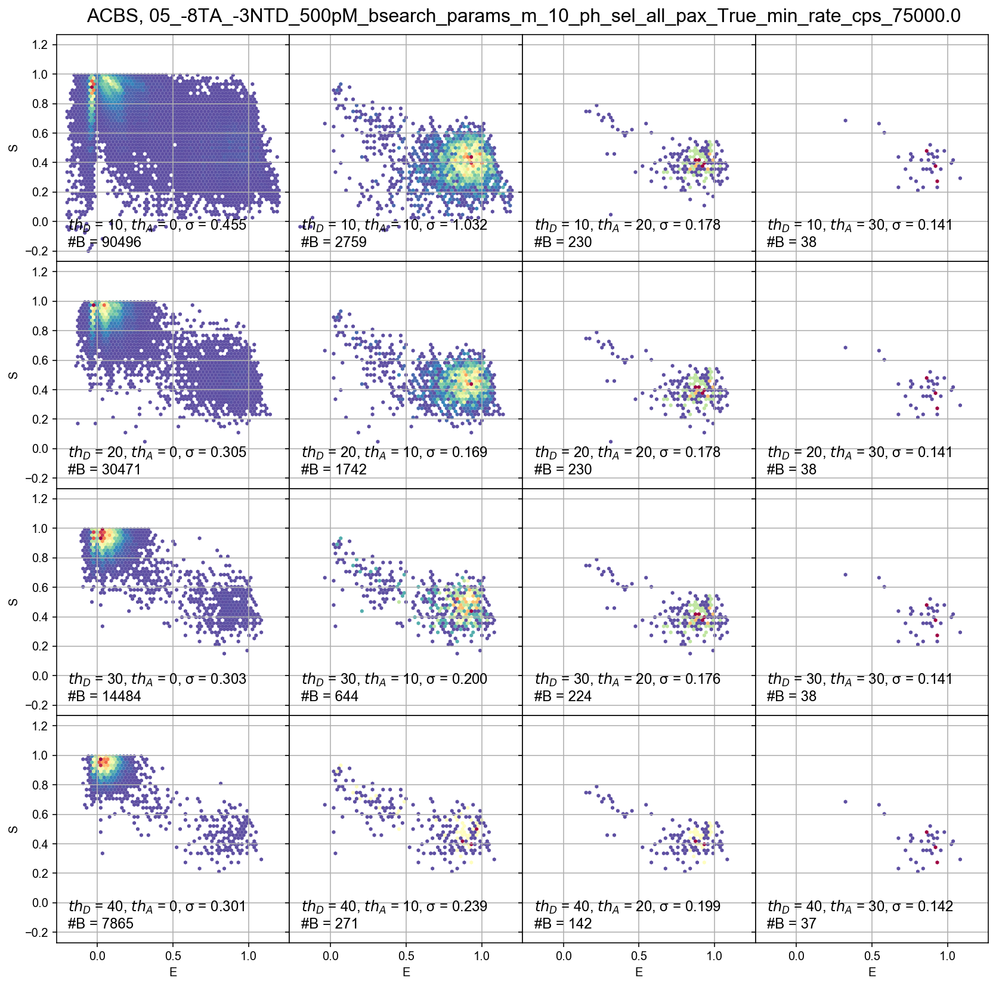

In [139]:
Th = (10, 20, 30, 40)
Th_naa = np.array((0, 10, 20, 30)) 
fig, AX = plt.subplots(len(Th), len(Th_naa), figsize=(3.5*len(Th_naa), 3.5*len(Th)), sharex=True, sharey=True)
for irow, th in enumerate(Th):
    for icol, th_naa in enumerate(Th_naa):
        ax = AX[irow,icol]
        d75nfs = d75nf.select_bursts(select_bursts.size, th1=th_naa, **naa_sel_kws)
        d75nfss = d75nfs.select_bursts(select_bursts.size, th1=th, **size_sel_kws)
        d75nfssc = d75nfss.collapse(update_gamma=False)
        Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(d75nfssc.nd, d75nfssc.na, d75nfssc.naa)]
        d75nfssc.add(Su=Su)
        E = d75nfssc.E[0]
        E_std = E[E > 0.2].std()
        dplot(d75nfssc, hexbin_alex, S_name='Su', gridsize=60, ax=ax)
        ax.text(0.05, 0.05, '$th_D$ = %d, $th_A$ = %d, σ = %.3f\n#B = %d' % (th, th_naa, E_std, d75nfssc.num_bursts), 
                va='bottom', ha='left', transform=ax.transAxes, fontsize=12)
        ax.set_title('')
plt.setp(AX[:-1], xlabel='')
plt.setp(AX[:, 1:], ylabel='')
plt.subplots_adjust(hspace=0, wspace=0)
plt.text(0.15, 0.89, f'ACBS, {fig_name_nf_75kcps[10:]}', transform=fig.transFigure, fontsize=16)
plt.savefig(f'{fig_name_nf_75kcps}_ACBS_size_sel_matrix_alex_hist_Su_48spot.png', 
            bbox_to_anchor='tight', dpi = 1200);

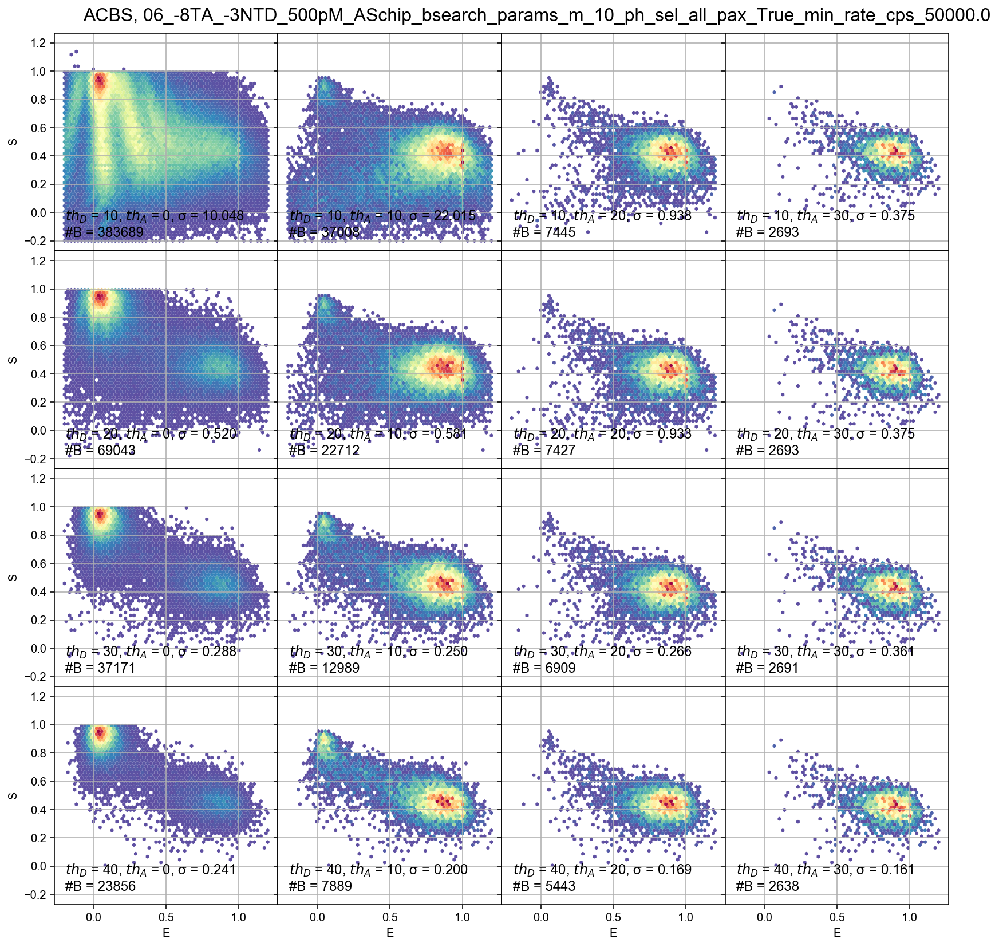

In [140]:
Th = (10, 20, 30, 40)
Th_naa = np.array((0, 10, 20, 30)) 
fig, AX = plt.subplots(len(Th), len(Th_naa), figsize=(3.5*len(Th_naa), 3.5*len(Th)), sharex=True, sharey=True)
for irow, th in enumerate(Th):
    for icol, th_naa in enumerate(Th_naa):
        ax = AX[irow,icol]
        d50fs = d50f.select_bursts(select_bursts.size, th1=th_naa, **naa_sel_kws)
        d50fss = d50fs.select_bursts(select_bursts.size, th1=th, **size_sel_kws)
        d50fssc = d50fss.collapse(update_gamma=False)
        Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(d50fssc.nd, d50fssc.na, d50fssc.naa)]
        d50fssc.add(Su=Su)
        E = d50fssc.E[0]
        E_std = E[E > 0.2].std()
        dplot(d50fssc, hexbin_alex, S_name='Su', gridsize=60, ax=ax)
        ax.text(0.05, 0.05, '$th_D$ = %d, $th_A$ = %d, σ = %.3f\n#B = %d' % (th, th_naa, E_std, d50fssc.num_bursts), 
                va='bottom', ha='left', transform=ax.transAxes, fontsize=12)
        ax.set_title('')
plt.setp(AX[:-1], xlabel='')
plt.setp(AX[:, 1:], ylabel='')
plt.subplots_adjust(hspace=0, wspace=0)
plt.text(0.15, 0.89, f'ACBS, {fig_name_f_50kcps[10:]}', transform=fig.transFigure, fontsize=16)
plt.savefig(f'{fig_name_f_50kcps}_ACBS_size_sel_matrix_alex_hist_Su_48spot.png', 
            bbox_to_anchor='tight', dpi = 1200);

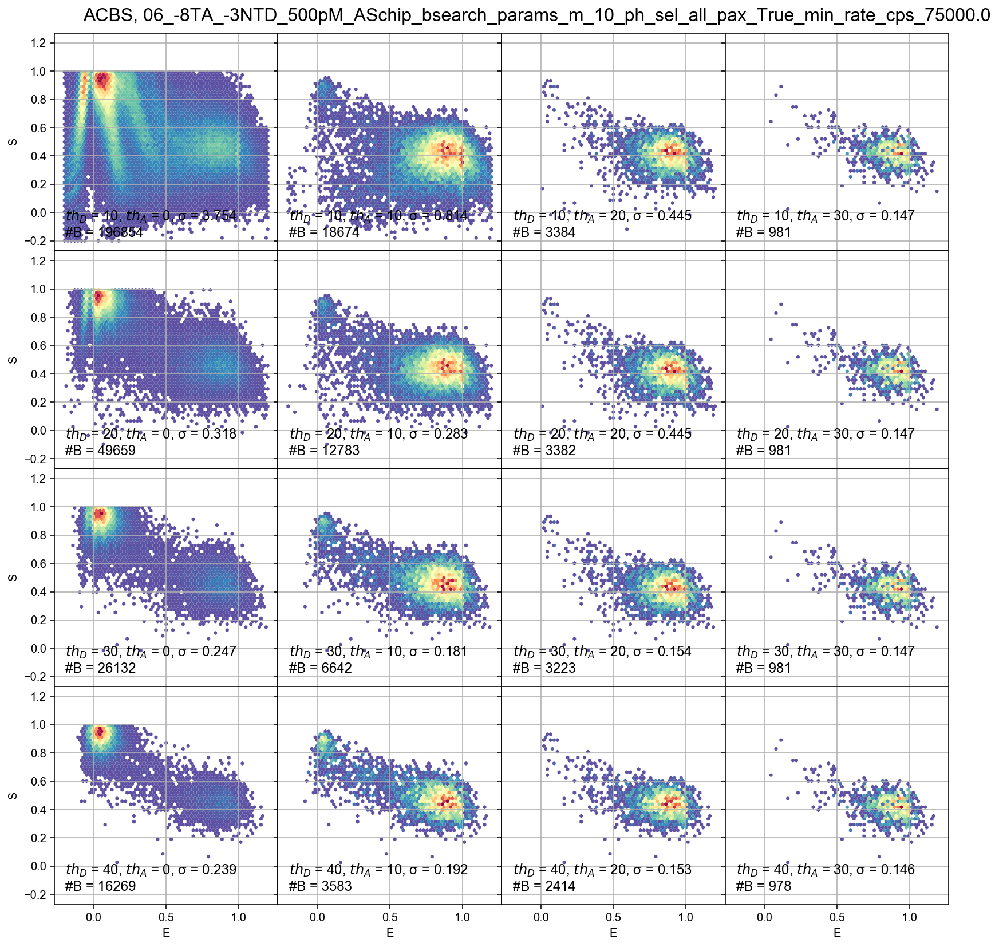

In [141]:
Th = (10, 20, 30, 40)
Th_naa = np.array((0, 10, 20, 30)) 
fig, AX = plt.subplots(len(Th), len(Th_naa), figsize=(3.5*len(Th_naa), 3.5*len(Th)), sharex=True, sharey=True)
for irow, th in enumerate(Th):
    for icol, th_naa in enumerate(Th_naa):
        ax = AX[irow,icol]
        d75fs = d75f.select_bursts(select_bursts.size, th1=th_naa, **naa_sel_kws)
        d75fss = d75fs.select_bursts(select_bursts.size, th1=th, **size_sel_kws)
        d75fssc = d75fss.collapse(update_gamma=False)
        Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(d75fssc.nd, d75fssc.na, d75fssc.naa)]
        d75fssc.add(Su=Su)
        E = d75fssc.E[0]
        E_std = E[E > 0.2].std()
        dplot(d75fssc, hexbin_alex, S_name='Su', gridsize=60, ax=ax)
        ax.text(0.05, 0.05, '$th_D$ = %d, $th_A$ = %d, σ = %.3f\n#B = %d' % (th, th_naa, E_std, d75fssc.num_bursts), 
                va='bottom', ha='left', transform=ax.transAxes, fontsize=12)
        ax.set_title('')
plt.setp(AX[:-1], xlabel='')
plt.setp(AX[:, 1:], ylabel='')
plt.subplots_adjust(hspace=0, wspace=0)
plt.text(0.15, 0.89, f'ACBS, {fig_name_f_75kcps[10:]}', transform=fig.transFigure, fontsize=16)
plt.savefig(f'{fig_name_f_75kcps}_ACBS_size_sel_matrix_alex_hist_Su_48spot.png', 
            bbox_to_anchor='tight', dpi = 1200);

## Pooled $E_{PR} - S_u$ histograms 

In [142]:
#Size selection on all bursts from the `nd`, `nda`, `na`, and `naa` photon streams

size_sel_kws = dict(ph_sel=Ph_sel(Dex='DAem', Aex='DAem'), gamma=1,
                    na_comp=False, naa_comp=False, naa_aexonly=False)

Math(d0._burst_sizes_pax_formula(**size_sel_kws))

<IPython.core.display.Math object>

In [143]:
for d in dsc_dict.values():
    Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(d.nd, d.na, d.naa)]
    d.add(Su=Su)

/Users/maya/anaconda3/envs/py37-fb/lib/python3.7/site-packages/seaborn/axisgrid.py:1847: UserWarning: JointGrid annotation is deprecated and will be removed in a future release.
  warnings.warn(UserWarning(msg))
/Users/maya/anaconda3/envs/py37-fb/lib/python3.7/site-packages/seaborn/axisgrid.py:1847: UserWarning: JointGrid annotation is deprecated and will be removed in a future release.
  warnings.warn(UserWarning(msg))
/Users/maya/anaconda3/envs/py37-fb/lib/python3.7/site-packages/seaborn/axisgrid.py:1847: UserWarning: JointGrid annotation is deprecated and will be removed in a future release.
  warnings.warn(UserWarning(msg))
/Users/maya/anaconda3/envs/py37-fb/lib/python3.7/site-packages/seaborn/axisgrid.py:1847: UserWarning: JointGrid annotation is deprecated and will be removed in a future release.
  warnings.warn(UserWarning(msg))


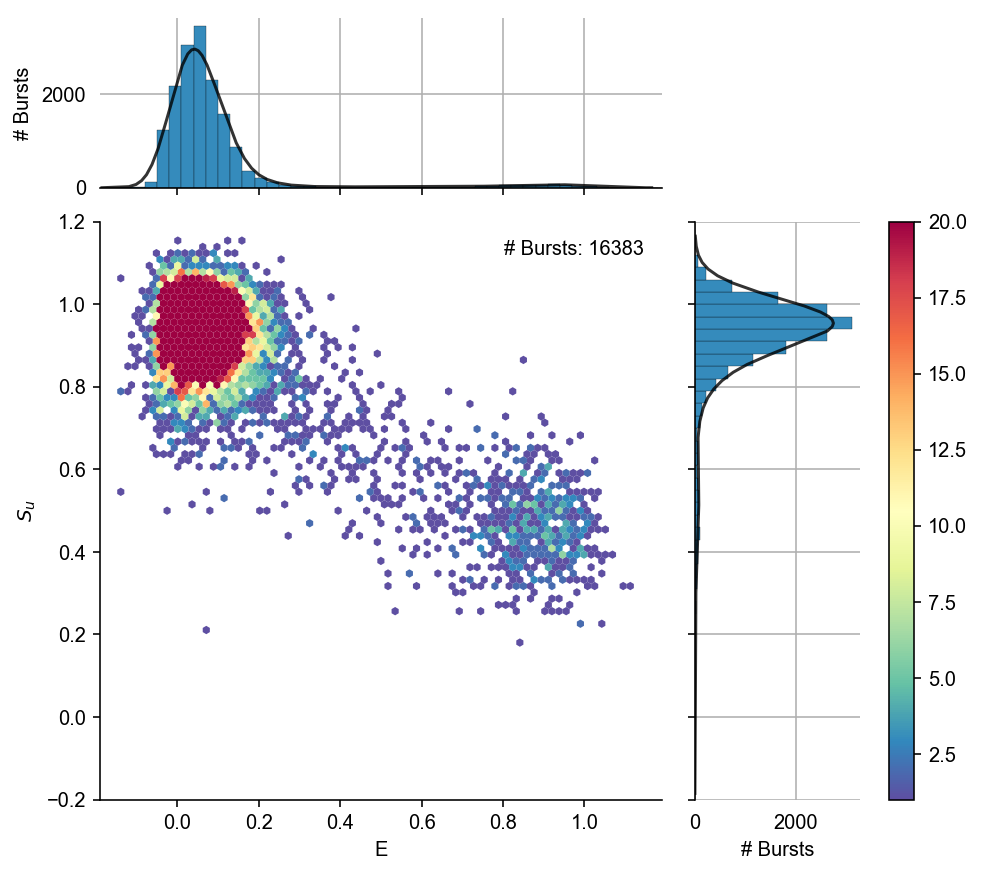

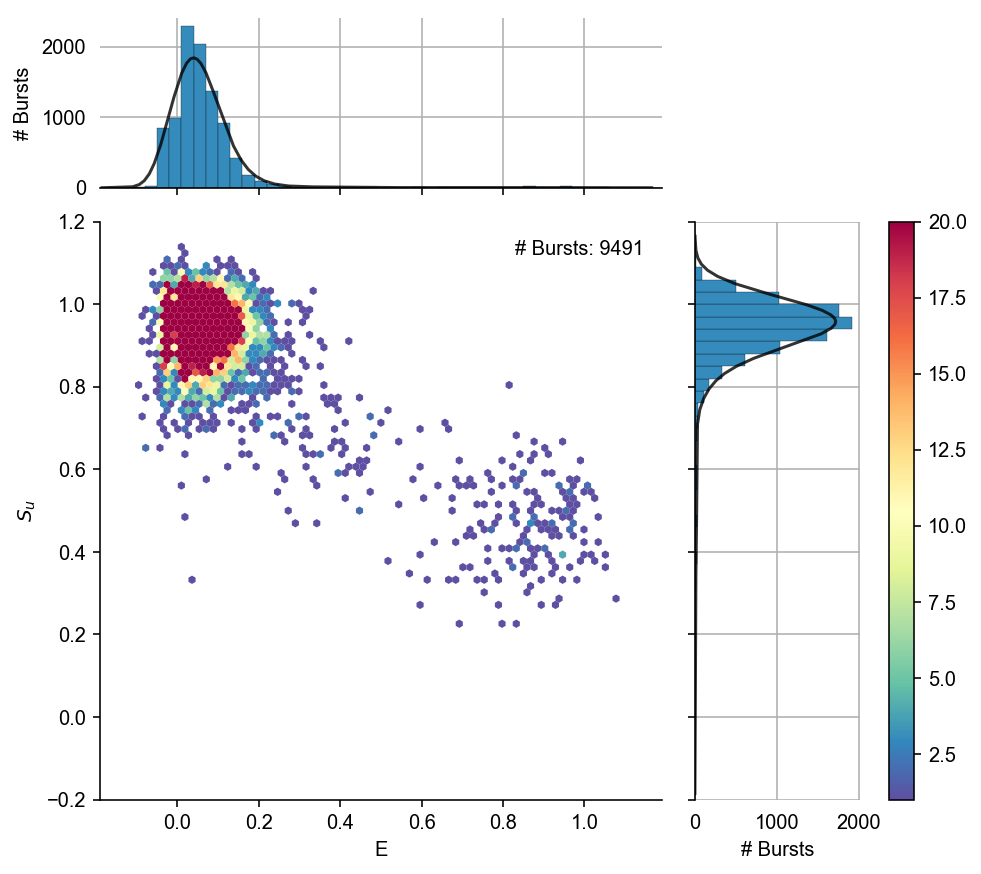

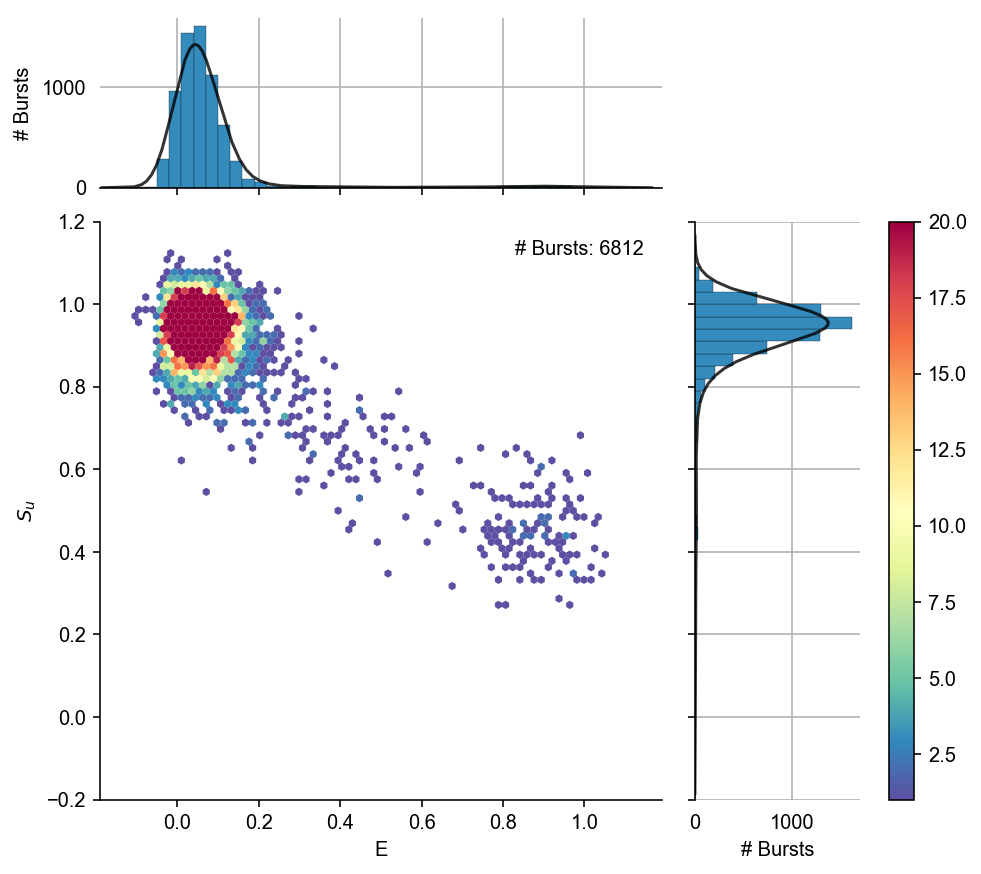

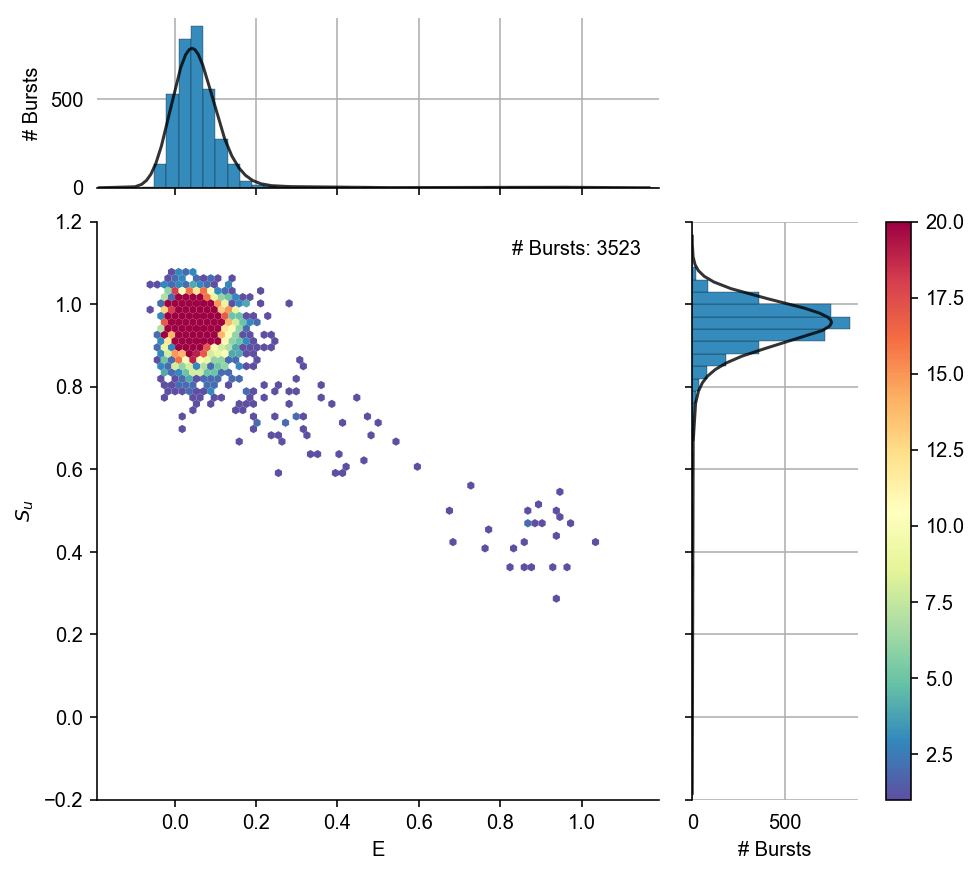

In [144]:
g = alex_jointplot(d50nfs40c, S_name='Su', vmax=20, gridsize=80)
g.ax_joint.set_ylabel('$S_u$')
plt.savefig(f'{fig_name_nf_50kcps}_Dex_th_{size_th1}_alex_hist_Su_48spot.png', 
            bbox_to_anchor='tight', dpi = 1200)

g = alex_jointplot(d75nfs40c, S_name='Su', vmax=20, gridsize=80)
g.ax_joint.set_ylabel('$S_u$')
plt.savefig(f'{fig_name_nf_75kcps}_Dex_th_{size_th1}_alex_hist_Su_48spot.png', 
            bbox_to_anchor='tight', dpi = 1200)

g = alex_jointplot(d50nfs60c, S_name='Su', vmax=20, gridsize=80)
g.ax_joint.set_ylabel('$S_u$')
plt.savefig(f'{fig_name_nf_50kcps}_Dex_th_{size_th2}_alex_hist_Su_48spot.png', 
            bbox_to_anchor='tight', dpi = 1200)

g = alex_jointplot(d75nfs60c, S_name='Su', vmax=20, gridsize=80)
g.ax_joint.set_ylabel('$S_u$')
plt.savefig(f'{fig_name_nf_75kcps}_Dex_th_{size_th2}_alex_hist_Su_48spot.png', 
            bbox_to_anchor='tight', dpi = 1200)

/Users/maya/anaconda3/envs/py37-fb/lib/python3.7/site-packages/seaborn/axisgrid.py:1847: UserWarning: JointGrid annotation is deprecated and will be removed in a future release.
  warnings.warn(UserWarning(msg))
/Users/maya/anaconda3/envs/py37-fb/lib/python3.7/site-packages/seaborn/axisgrid.py:1847: UserWarning: JointGrid annotation is deprecated and will be removed in a future release.
  warnings.warn(UserWarning(msg))
/Users/maya/anaconda3/envs/py37-fb/lib/python3.7/site-packages/seaborn/axisgrid.py:1847: UserWarning: JointGrid annotation is deprecated and will be removed in a future release.
  warnings.warn(UserWarning(msg))
/Users/maya/anaconda3/envs/py37-fb/lib/python3.7/site-packages/seaborn/axisgrid.py:1847: UserWarning: JointGrid annotation is deprecated and will be removed in a future release.
  warnings.warn(UserWarning(msg))


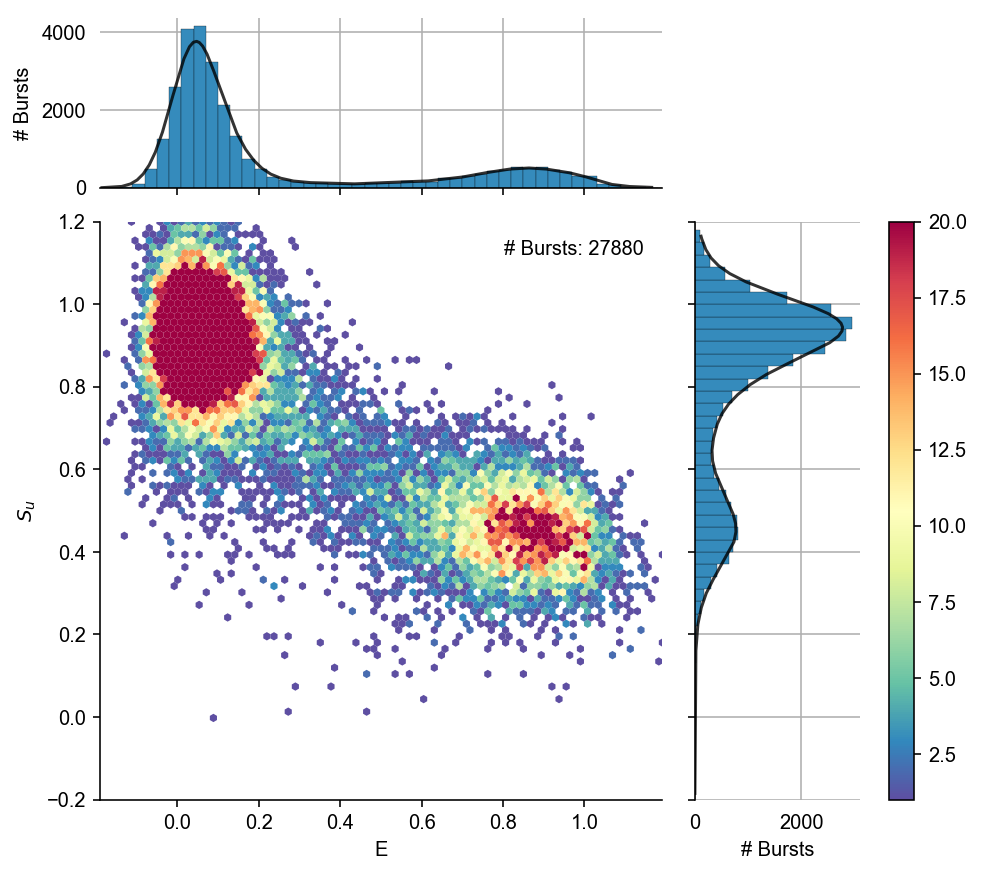

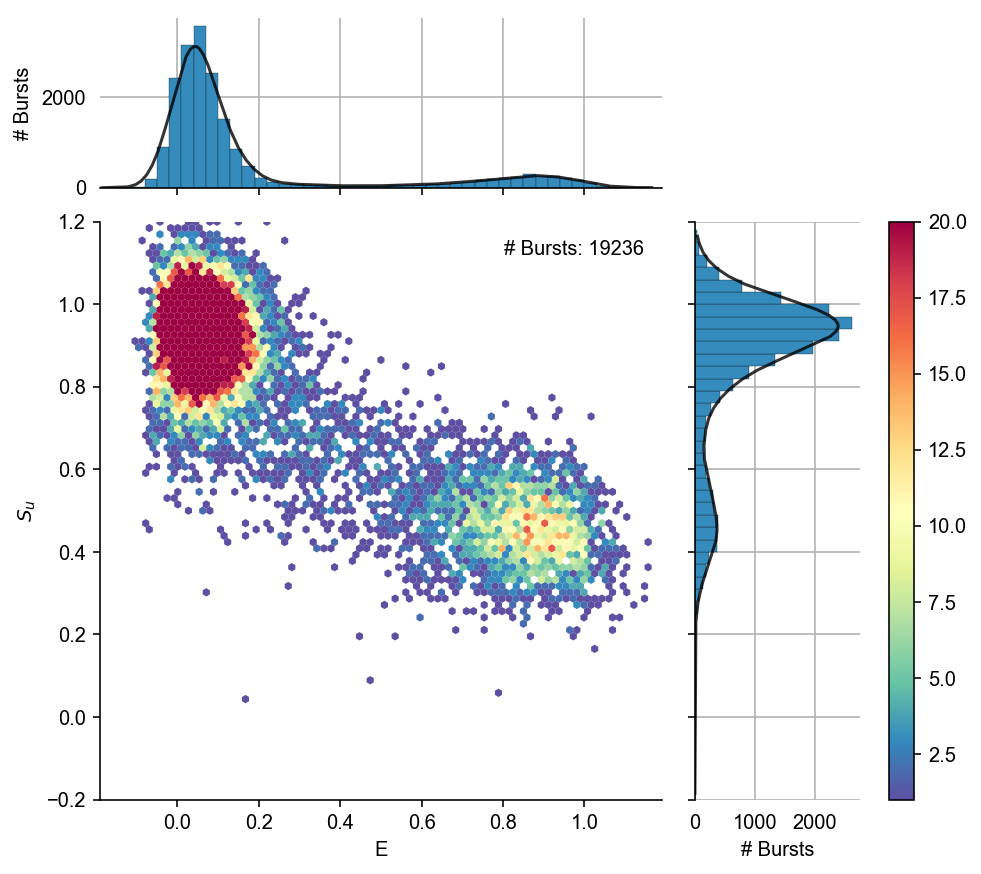

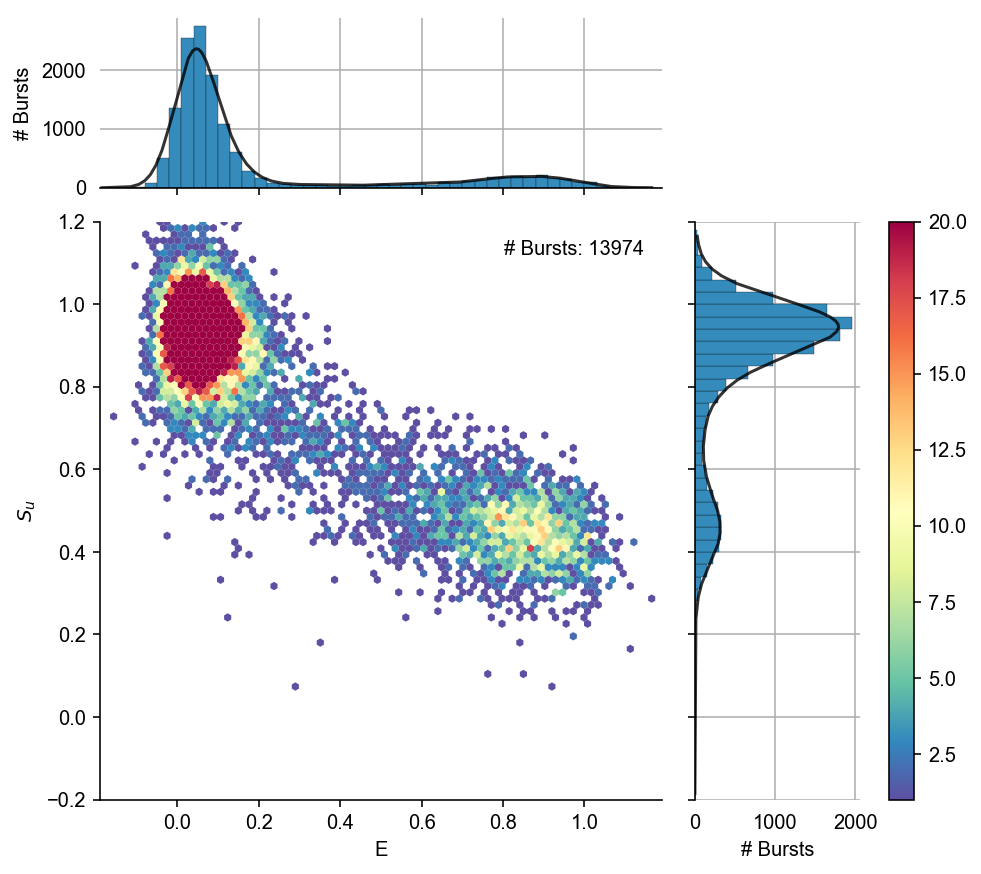

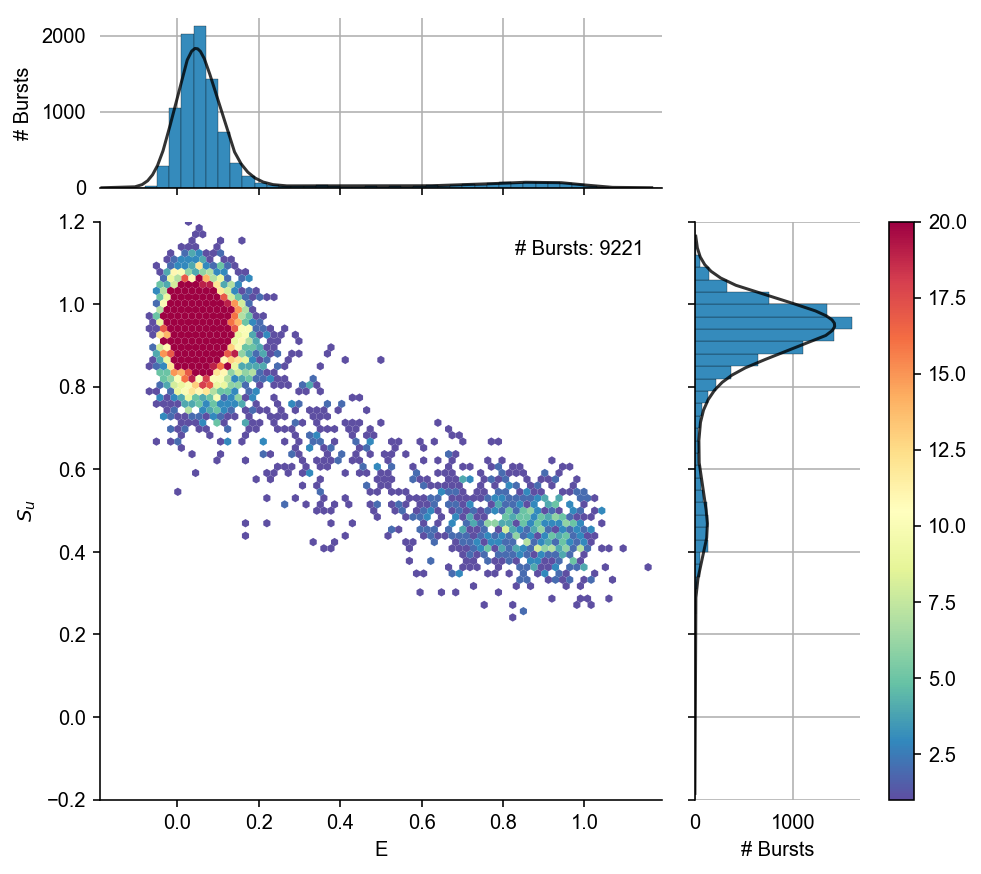

In [145]:
g = alex_jointplot(d50fs40c, S_name='Su', vmax=20, gridsize=80)
g.ax_joint.set_ylabel('$S_u$')
plt.savefig(f'{fig_name_f_50kcps}_Dex_th_{size_th1}_alex_hist_Su_48spot.png', 
            bbox_to_anchor='tight', dpi = 1200)

g = alex_jointplot(d75fs40c, S_name='Su', vmax=20, gridsize=80)
g.ax_joint.set_ylabel('$S_u$')
plt.savefig(f'{fig_name_f_75kcps}_Dex_th_{size_th1}_alex_hist_Su_48spot.png', 
            bbox_to_anchor='tight', dpi = 1200)

g = alex_jointplot(d50fs60c, S_name='Su', vmax=20, gridsize=80)
g.ax_joint.set_ylabel('$S_u$')
plt.savefig(f'{fig_name_f_50kcps}_Dex_th_{size_th2}_alex_hist_Su_48spot.png', 
            bbox_to_anchor='tight', dpi = 1200)

g = alex_jointplot(d75fs60c, S_name='Su', vmax=20, gridsize=80)
g.ax_joint.set_ylabel('$S_u$')
plt.savefig(f'{fig_name_f_75kcps}_Dex_th_{size_th2}_alex_hist_Su_48spot.png', 
            bbox_to_anchor='tight', dpi = 1200)

### Calculate number of FRET bursts and D-only bursts

In [146]:
size_Aex = 15
naa_sel_kws = dict(ph_sel=Ph_sel(Aex='Aem'), gamma=1,
                   na_comp=False, naa_comp=False, naa_aexonly=False)

Math(d0._burst_sizes_pax_formula(**naa_sel_kws))

<IPython.core.display.Math object>

In [147]:
# applying a second size selection to isolate FRET sub-population and calculate number of D-only bursts 
d50nfs40cs15 = d50nfs40c.select_bursts(select_bursts.size, th1=size_Aex, **naa_sel_kws)
d75nfs40cs15 = d75nfs40c.select_bursts(select_bursts.size, th1=size_Aex, **naa_sel_kws)
d50nfs60cs15 = d50nfs60c.select_bursts(select_bursts.size, th1=size_Aex, **naa_sel_kws)
d75nfs60cs15 = d75nfs60c.select_bursts(select_bursts.size, th1=size_Aex, **naa_sel_kws)

d50fs40cs15 = d50fs40c.select_bursts(select_bursts.size, th1=size_Aex, **naa_sel_kws)
d75fs40cs15 = d75fs40c.select_bursts(select_bursts.size, th1=size_Aex, **naa_sel_kws)
d50fs60cs15 = d50fs60c.select_bursts(select_bursts.size, th1=size_Aex, **naa_sel_kws)
d75fs60cs15 = d75fs60c.select_bursts(select_bursts.size, th1=size_Aex, **naa_sel_kws)

In [148]:
dscs_dict = collections.OrderedDict(nf50s40cs15=d50nfs40cs15, nf75s40cs15=d75nfs40cs15, nf50s60cs15=d50nfs60cs15, 
                nf75s60cs15=d75nfs60cs15, f50s40cs15=d50fs40cs15, f75s40cs15=d75fs40cs15, 
                f50s60cs15=d50fs60cs15, f75s60cs15=d75fs60cs15)
dscs_dict.keys()

odict_keys(['nf50s40cs15', 'nf75s40cs15', 'nf50s60cs15', 'nf75s60cs15', 'f50s40cs15', 'f75s40cs15', 'f50s60cs15', 'f75s60cs15'])

In [149]:
for d in dscs_dict.values():
    Su = [(nd + na)/(nd + na + naa) for nd, na, naa in zip(d.nd, d.na, d.naa)]
    d.add(Su=Su)

In [173]:
Donly_bursts = []
for dsc, dscs in zip(dsc_dict.values(), dscs_dict.values()):
    num_bursts = dsc.num_bursts - dscs.num_bursts
    Donly_bursts.append(num_bursts)
    print(f'{num_bursts}, {dsc}, {dscs} \n')

[15658], 05_-8TA_-3NTD_500pM BS_all L10 m10 MR50 G1.000 BGexp-10s bg Lk0.000 dir0.0slice, 05_-8TA_-3NTD_500pM BS_all L10 m10 MR50 G1.000 BGexp-10s bg Lk0.000 dir0.0slice size_th15Gd1.0 

[9281], 05_-8TA_-3NTD_500pM BS_all L10 m10 MR75 G1.000 BGexp-10s bg Lk0.000 dir0.0slice, 05_-8TA_-3NTD_500pM BS_all L10 m10 MR75 G1.000 BGexp-10s bg Lk0.000 dir0.0slice size_th15Gd1.0 

[6599], 05_-8TA_-3NTD_500pM BS_all L10 m10 MR50 G1.000 BGexp-10s bg Lk0.000 dir0.0slice, 05_-8TA_-3NTD_500pM BS_all L10 m10 MR50 G1.000 BGexp-10s bg Lk0.000 dir0.0slice size_th15Gd1.0 

[3468], 05_-8TA_-3NTD_500pM BS_all L10 m10 MR75 G1.000 BGexp-10s bg Lk0.000 dir0.0slice, 05_-8TA_-3NTD_500pM BS_all L10 m10 MR75 G1.000 BGexp-10s bg Lk0.000 dir0.0slice size_th15Gd1.0 

[21380], 06_-8TA_-3NTD_500pM_ASchip BS_all L10 m10 MR50 G1.000 BGexp-10s bg Lk0.000 dir0.0slice, 06_-8TA_-3NTD_500pM_ASchip BS_all L10 m10 MR50 G1.000 BGexp-10s bg Lk0.000 dir0.0slice size_th15Gd1.0 

[16261], 06_-8TA_-3NTD_500pM_ASchip BS_all L10 m10 MR7

# Save burst search results to CSV

Burst search results are loaded into a DataFrame and saved as .CSV

In [151]:
Path('results/').mkdir(exist_ok=True)

## Save burst results for all 48-spots

In [153]:
fname_bursts_nf50 = f'results/{f0}_bsearch_params'
for k, v in bsearch_params_50kcps.items():
    fname_bursts_nf50 += f'_{k}_{v}'
# for k, v in sel_nf_params.items():
#     fname_bursts_50kcps += f'_{k}_{v}'
fname_bursts_nf50

'results/05_-8TA_-3NTD_500pM_bsearch_params_m_10_ph_sel_all_pax_True_min_rate_cps_50000.0'

In [154]:
fname_bursts_nf75 = f'results/{f0}_bsearch_params'
for k, v in bsearch_params_75kcps.items():
    fname_bursts_nf75 += f'_{k}_{v}'
# for k, v in sel_f_params.items():
#     fname_bursts_75kcps += f'_{k}_{v}'
fname_bursts_nf75

'results/05_-8TA_-3NTD_500pM_bsearch_params_m_10_ph_sel_all_pax_True_min_rate_cps_75000.0'

In [155]:
fname_bursts_f50 = f'results/{f1}_bsearch_params'
for k, v in bsearch_params_50kcps.items():
    fname_bursts_f50 += f'_{k}_{v}'
# for k, v in sel_f_params.items():
#     fname_bursts_75kcps += f'_{k}_{v}'
fname_bursts_f50

'results/06_-8TA_-3NTD_500pM_ASchip_bsearch_params_m_10_ph_sel_all_pax_True_min_rate_cps_50000.0'

In [156]:
fname_bursts_f75 = f'results/{f1}_bsearch_params'
for k, v in bsearch_params_75kcps.items():
    fname_bursts_f75 += f'_{k}_{v}'
# for k, v in sel_f_params.items():
#     fname_bursts_75kcps += f'_{k}_{v}'
fname_bursts_f75

'results/06_-8TA_-3NTD_500pM_ASchip_bsearch_params_m_10_ph_sel_all_pax_True_min_rate_cps_75000.0'

In [157]:
bursts_dnf50 = bext.burst_data(d50nf, include_bg=False)
bursts_dnf75 = bext.burst_data(d75nf, include_bg=False)

bursts_df50 = bext.burst_data(d50f, include_bg=False)
bursts_df75 = bext.burst_data(d75f, include_bg=False)

In [158]:
bursts_dnf50.to_csv(fname_bursts_nf50 + '.csv')
bursts_dnf75.to_csv(fname_bursts_nf75 + '.csv')

bursts_df50.to_csv(fname_bursts_f50 + '.csv')
bursts_df75.to_csv(fname_bursts_f75 + '.csv')

In [159]:
sample_description_noflow = 'no_flow_control'
sample_description_flow = 'Streets_chip'

burst_search_50kcps = '50kcps'
burst_search_75kcps = '75kcps'

In [160]:
df_nf50 = pd.read_csv(fname_bursts_nf50 + '.csv', index_col=0).assign(sample_description=sample_description_noflow).assign(burst_search=burst_search_50kcps)
df_nf50.head()

,size_raw,t_start,t_stop,width_ms,E,S,nd,na,nt,nda,naa,max_rate,nar,spot,sample_description,burst_search
0,10,0.111762,0.111955,0.192625,-0.107546,0.380666,0.571119,-0.247306,8.340388,4.522579,3.493996,33007.461334,-0.247306,0,no_flow_control,50kcps
1,33,0.220837,0.221162,0.325062,0.163274,1.099890,15.276246,2.582661,30.199337,11.194333,1.146097,174228.701000,2.582661,0,no_flow_control,50kcps
2,13,0.231640,0.231863,0.222663,-0.050238,1.055467,9.504240,-0.285870,11.081592,2.448131,-0.584909,58540.852563,-0.285870,0,no_flow_control,50kcps
3,13,0.231704,0.231950,0.246125,-0.068620,0.733929,7.452001,-0.315993,10.879444,2.389980,1.353457,45626.085565,-0.315993,0,no_flow_control,50kcps
4,11,0.235145,0.235333,0.187812,0.365135,1.055256,3.581834,1.758872,9.381851,2.534507,1.506638,39176.666508,1.758872,0,no_flow_control,50kcps


In [161]:
df_nf75 = pd.read_csv(fname_bursts_nf75 + '.csv', index_col=0).assign(sample_description=sample_description_noflow).assign(burst_search=burst_search_75kcps)
df_nf75.head()

,size_raw,t_start,t_stop,width_ms,E,S,nd,na,nt,nda,naa,max_rate,nar,spot,sample_description,burst_search
0,29,0.220978,0.221162,0.183950,0.127527,1.018187,13.590434,1.763831,27.415130,10.544080,1.516784,174228.701000,1.763831,0,no_flow_control,75kcps
1,11,0.231682,0.231815,0.133763,-0.034254,1.037163,8.702177,-0.171734,9.847534,1.668470,-0.351379,58540.852563,-0.171734,0,no_flow_control,75kcps
2,10,0.439758,0.439880,0.122100,0.207899,0.829106,3.728144,0.843239,8.948015,2.697375,1.679257,56996.053784,0.843239,0,no_flow_control,75kcps
3,12,0.442447,0.442582,0.135587,0.149978,1.034197,3.698113,0.825923,10.831810,5.663947,0.643827,75797.463890,0.825923,0,no_flow_control,75kcps
4,10,0.442554,0.442673,0.118688,0.167236,1.296597,-0.264259,0.847620,8.977416,8.705833,-0.311779,58879.885052,0.847620,0,no_flow_control,75kcps


In [162]:
df_f50 = pd.read_csv(fname_bursts_f50 + '.csv', index_col=0).assign(sample_description=sample_description_flow).assign(burst_search=burst_search_50kcps)
df_f50.head()

/Users/maya/anaconda3/envs/py37-fb/lib/python3.7/site-packages/numpy/lib/arraysetops.py:569: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask |= (ar1 == a)


,size_raw,t_start,t_stop,width_ms,E,S,nd,na,nt,nda,naa,max_rate,nar,spot,sample_description,burst_search
0,13,0.107419,0.107582,0.162663,0.130185,1.032662,5.216975,0.703486,10.636592,4.183561,0.532570,52641.675080,0.703486,0,Streets_chip,50kcps
1,21,0.107743,0.108094,0.351037,0.309148,0.923639,4.310176,2.360102,15.899595,6.238065,2.991252,52797.817831,2.360102,0,Streets_chip,50kcps
2,10,0.107972,0.108166,0.194075,0.392701,1.402902,2.065762,1.646225,7.180184,3.025895,0.442302,26544.034747,1.646225,0,Streets_chip,50kcps
3,51,0.108023,0.108628,0.605100,0.126384,1.188518,22.087170,2.896977,42.208189,17.962869,-0.738827,213486.850237,2.896977,0,Streets_chip,50kcps
4,10,0.110811,0.110991,0.180475,0.177344,1.052763,1.131230,0.671016,7.377785,5.094156,0.481384,29650.326545,0.671016,0,Streets_chip,50kcps


In [163]:
df_f75 = pd.read_csv(fname_bursts_f75 + '.csv', index_col=0).assign(sample_description=sample_description_flow).assign(burst_search=burst_search_75kcps)
df_f75.head()

,size_raw,t_start,t_stop,width_ms,E,S,nd,na,nt,nda,naa,max_rate,nar,spot,sample_description,burst_search
0,11,0.107461,0.107582,0.120512,0.166457,1.027762,3.419877,0.780320,9.249012,4.395121,0.653693,52641.675080,0.780320,0,Streets_chip,75kcps
1,10,0.107743,0.107872,0.128387,0.427104,1.033727,2.381968,1.765965,8.134592,2.355595,1.631063,47634.219454,1.765965,0,Streets_chip,75kcps
2,10,0.107810,0.107928,0.118563,0.244887,0.630559,1.429264,0.783875,8.277344,3.404909,2.659297,52797.817831,0.783875,0,Streets_chip,75kcps
3,42,0.108156,0.108523,0.366663,0.119393,1.139134,20.234960,2.331619,36.672571,14.159640,-0.053648,213486.850237,2.331619,0,Streets_chip,75kcps
4,11,0.139401,0.139531,0.129163,0.381152,1.030201,3.378238,1.764553,9.123331,2.351705,1.628836,51768.040091,1.764553,0,Streets_chip,75kcps


## Concatenate DataFrames

In [164]:
dataframe_list = [df_nf50, df_nf75, df_f50, df_f75]

bursts_all = pd.concat(dataframe_list, ignore_index=True)
bursts_all.sample(10).sort_values(['sample_description'])

,size_raw,t_start,t_stop,width_ms,E,S,nd,na,nt,nda,naa,max_rate,nar,spot,sample_description,burst_search
2590194,12,166.377347,166.377550,0.202763,-1.387863,0.085657,-0.941908,-0.447691,4.088468,2.482441,2.995626,9395.113674,-0.447691,17,Streets_chip,50kcps
4751883,12,56.207183,56.207389,0.205838,0.471187,2.344880,-0.007068,2.114621,6.401761,4.753552,-0.459344,17899.142291,2.114621,34,Streets_chip,50kcps
6808428,10,188.807657,188.807777,0.119163,-0.161296,0.469754,-0.566787,-0.270765,5.252213,4.465680,1.624085,25108.115086,-0.270765,17,Streets_chip,75kcps
4012188,10,110.187211,110.187364,0.153075,-0.142690,0.770234,0.251544,-0.344030,5.541297,5.258585,0.375197,25404.709032,-0.344030,30,Streets_chip,50kcps
7481839,18,76.262702,76.262909,0.207550,0.052123,0.902985,8.113823,0.359879,14.550598,4.975223,1.101673,210338.082048,0.359879,37,Streets_chip,75kcps
5896453,11,136.954295,136.954473,0.177638,-0.116949,0.883174,2.232995,-0.344462,6.280423,4.346736,0.045153,21809.924918,-0.344462,45,Streets_chip,50kcps
4470488,10,49.804881,49.805069,0.187800,-0.220379,0.612348,1.105153,-0.395743,4.728285,3.277810,0.741064,15278.299866,-0.395743,33,Streets_chip,50kcps
1389328,12,91.370882,91.371100,0.218413,0.220822,0.736639,1.699079,0.525390,5.609105,2.008628,1.376009,16683.406047,0.525390,7,Streets_chip,50kcps
5001052,10,131.327894,131.328090,0.196025,0.314986,0.675562,0.195957,0.631813,4.974988,2.552101,1.595117,17122.858383,0.631813,35,Streets_chip,50kcps
366320,15,25.621627,25.621832,0.205025,0.818450,0.900497,1.088518,4.682342,12.074131,0.988775,5.314497,81532.714567,4.682342,29,no_flow_control,75kcps


In [165]:
bursts_all.groupby(['spot', 'sample_description', 'burst_search']).head()

,size_raw,t_start,t_stop,width_ms,E,S,nd,na,nt,nda,naa,max_rate,nar,spot,sample_description,burst_search
0,10,0.111762,0.111955,0.192625,-0.107546,0.380666,0.571119,-0.247306,8.340388,4.522579,3.493996,33007.461334,-0.247306,0,no_flow_control,50kcps
1,33,0.220837,0.221162,0.325062,0.163274,1.099890,15.276246,2.582661,30.199337,11.194333,1.146097,174228.701000,2.582661,0,no_flow_control,50kcps
2,13,0.231640,0.231863,0.222663,-0.050238,1.055467,9.504240,-0.285870,11.081592,2.448131,-0.584909,58540.852563,-0.285870,0,no_flow_control,50kcps
3,13,0.231704,0.231950,0.246125,-0.068620,0.733929,7.452001,-0.315993,10.879444,2.389980,1.353457,45626.085565,-0.315993,0,no_flow_control,50kcps
4,11,0.235145,0.235333,0.187812,0.365135,1.055256,3.581834,1.758872,9.381851,2.534507,1.506638,39176.666508,1.758872,0,no_flow_control,50kcps
3213,68,0.144265,0.145182,0.917412,0.053290,1.066670,27.099857,1.658222,60.289507,31.818137,-0.286709,132901.643612,1.658222,1,no_flow_control,50kcps
3214,27,0.145098,0.145516,0.417850,-0.055764,0.874720,8.134550,-0.611134,23.488134,15.006236,0.958482,72557.929809,-0.611134,1,no_flow_control,50kcps
3215,10,0.147578,0.147774,0.195687,0.358651,1.335923,3.594693,1.713794,8.355323,2.534600,0.512237,32190.230764,1.713794,1,no_flow_control,50kcps
3216,34,0.150308,0.150830,0.522188,0.290662,0.969265,13.918446,4.236265,29.611219,6.758092,4.698415,140284.514692,4.236265,1,no_flow_control,50kcps
3217,26,0.151990,0.152368,0.377462,0.186749,1.348662,8.218201,2.447935,22.827575,13.102289,-0.940849,82724.235328,2.447935,1,no_flow_control,50kcps


## size select concatenated DataFrame

In [166]:
size_sel_40 = 40
size_sel_60 = 60

In [167]:
bursts_all_40 = bursts_all.loc[bursts_all.nt >= size_sel_40]
bursts_all_40.head()

,size_raw,t_start,t_stop,width_ms,E,S,nd,na,nt,nda,naa,max_rate,nar,spot,sample_description,burst_search
23,69,0.511645,0.512368,0.722950,0.094894,1.064833,32.390347,3.071824,62.771232,26.208170,1.100891,199809.321597,3.071824,0,no_flow_control,50kcps
62,48,1.121809,1.122652,0.842587,0.093865,1.006482,17.123973,1.918224,40.740463,19.911649,1.786617,80998.998475,1.918224,0,no_flow_control,50kcps
103,52,2.636693,2.637336,0.642750,0.209822,1.131344,14.568913,5.174790,46.462216,24.406945,2.311568,137528.019300,5.174790,0,no_flow_control,50kcps
151,51,4.506936,4.507601,0.665087,0.051904,0.952270,20.519178,1.146112,45.269761,21.351582,2.252890,197528.789294,1.146112,0,no_flow_control,50kcps
234,86,7.428463,7.429538,1.074938,0.095033,0.985605,35.606644,3.619916,76.738589,33.335770,4.176259,233533.476918,3.619916,0,no_flow_control,50kcps


In [168]:
bursts_all_60 = bursts_all.loc[bursts_all.nt >= size_sel_60]
bursts_all_60.head()

,size_raw,t_start,t_stop,width_ms,E,S,nd,na,nt,nda,naa,max_rate,nar,spot,sample_description,burst_search
23,69,0.511645,0.512368,0.722950,0.094894,1.064833,32.390347,3.071824,62.771232,26.208170,1.100891,199809.321597,3.071824,0,no_flow_control,50kcps
234,86,7.428463,7.429538,1.074938,0.095033,0.985605,35.606644,3.619916,76.738589,33.335770,4.176259,233533.476918,3.619916,0,no_flow_control,50kcps
294,80,9.934604,9.935633,1.028775,0.046958,1.010788,33.709425,1.679183,71.136315,34.450183,1.297523,144293.562285,1.679183,0,no_flow_control,50kcps
324,101,10.843292,10.844566,1.274625,0.139118,1.061856,36.203378,6.476608,90.397626,43.952976,3.764664,168723.380815,6.476608,0,no_flow_control,50kcps
364,70,12.367401,12.368417,1.015850,0.122294,1.011911,26.771150,3.785887,61.550125,27.571585,3.421503,96255.398260,3.785887,0,no_flow_control,50kcps


In [169]:
sel_df_list = [bursts_all_40, bursts_all_60]

In [170]:
mask_nf = bursts_all.sample_description == sample_description_noflow
mask_f = bursts_all.sample_description == sample_description_flow

mask_nf40 = bursts_all_40.sample_description == sample_description_noflow
mask_f40 = bursts_all_40.sample_description == sample_description_flow

mask_nf60 = bursts_all_60.sample_description == sample_description_noflow
mask_f60 = bursts_all_60.sample_description == sample_description_flow

In [171]:
mask_bsearch_50 = bursts_all.burst_search == burst_search_50kcps
mask_bsearch_75 = bursts_all.burst_search == burst_search_75kcps

mask_bsearch_50s40 = bursts_all_40.burst_search == burst_search_50kcps
mask_bsearch_75s40 = bursts_all_40.burst_search == burst_search_75kcps

mask_bsearch_50s60 = bursts_all_60.burst_search == burst_search_50kcps
mask_bsearch_75s60 = bursts_all_60.burst_search == burst_search_75kcps

In [174]:
# calculate number of bursts before size selection
num_bursts_nf50 = len(bursts_all.loc[mask_nf & mask_bsearch_50])
num_bursts_nf75 = len(bursts_all.loc[mask_nf & mask_bsearch_75])

num_bursts_f50 = len(bursts_all.loc[mask_f & mask_bsearch_50])
num_bursts_f75 = len(bursts_all.loc[mask_f & mask_bsearch_75])

# calculate number of bursts after size selection
num_bursts_nf50s40 = len(bursts_all_40.loc[mask_nf & mask_bsearch_50s40])
num_bursts_nf75s40 = len(bursts_all_40.loc[mask_nf & mask_bsearch_75s40])

num_bursts_f75s40 = len(bursts_all_40.loc[mask_f & mask_bsearch_75s40])
num_bursts_f75s60 = len(bursts_all_60.loc[mask_f & mask_bsearch_75s60])

In [176]:
lightcoral = '#F08080'

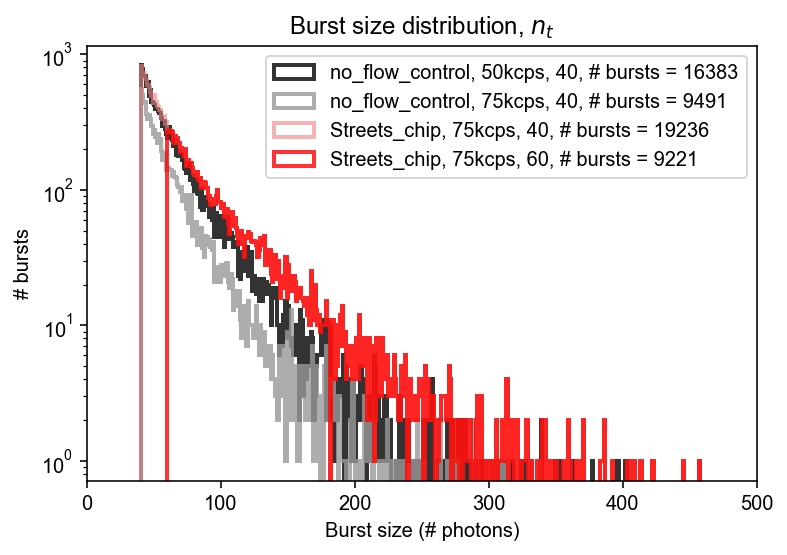

In [175]:
column = 'nt'
binwidth = 1
hist_kws = dict(histtype='step', lw=2)

size_nf50 = bursts_all.loc[mask_nf & mask_bsearch_50, column]
size_nf75 = bursts_all.loc[mask_nf & mask_bsearch_75, column]

size_nf50s40 = bursts_all_40.loc[mask_nf & mask_bsearch_50, column]
size_nf75s40 = bursts_all_40.loc[mask_nf & mask_bsearch_75, column]

size_f50 = bursts_all.loc[mask_f & mask_bsearch_50, column]
size_f75 = bursts_all.loc[mask_f & mask_bsearch_75, column]

size_f50s40 = bursts_all_40.loc[mask_f & mask_bsearch_50, column]
size_f75s40 = bursts_all_40.loc[mask_f & mask_bsearch_75, column]
size_f50s60 = bursts_all_60.loc[mask_f & mask_bsearch_50, column]
size_f75s60 = bursts_all_60.loc[mask_f & mask_bsearch_75, column]

bins = np.arange(-1, size_nf50s40.max(), binwidth)

#plt.hist(size_nf50, label=f'{burst_search_50kcps}, # bursts = {num_bursts_nf50}', 
#           color='k', bins=bins, **hist_kws)
plt.hist(size_nf50s40, label=f'{sample_description_noflow}, {burst_search_50kcps}, {size_sel_40}, # bursts = {num_bursts_nf50s40}', 
           color='k', alpha=0.8, bins=bins, **hist_kws)
#plt.hist(size_nf75, alpha=0.8, label=f'{burst_search_75kcps}, # bursts = {num_bursts_nf75}', 
#          color='r', bins=bins, **hist_kws)
plt.hist(size_nf75s40, alpha=0.8, label=f'{sample_description_noflow}, {burst_search_75kcps}, {size_sel_40}, # bursts = {num_bursts_nf75s40}', 
           color='0.6', bins=bins, **hist_kws)
plt.hist(size_f75s40, alpha=0.6, label=f'{sample_description_flow}, {burst_search_75kcps}, {size_sel_40}, # bursts = {num_bursts_f75s40}', 
           color='lightcoral', bins=bins, **hist_kws)
plt.hist(size_f75s60, alpha=0.8, label=f'{sample_description_flow}, {burst_search_75kcps}, {size_sel_60}, # bursts = {num_bursts_f75s60}', 
           color='r', bins=bins, **hist_kws)
plt.yscale('log')
plt.legend(loc='upper right')
plt.ylabel('# bursts')
plt.xlabel('Burst size (# photons)')
plt.title('Burst size distribution, $n_t$')
plt.xlim(0, 500)

plt.savefig(f'{save_dir}/burst_size_distribution_50kcps_75kcps_size_sel_40_60_comparison.png', 
            bbox_to_anchor='tight', dpi=1200);

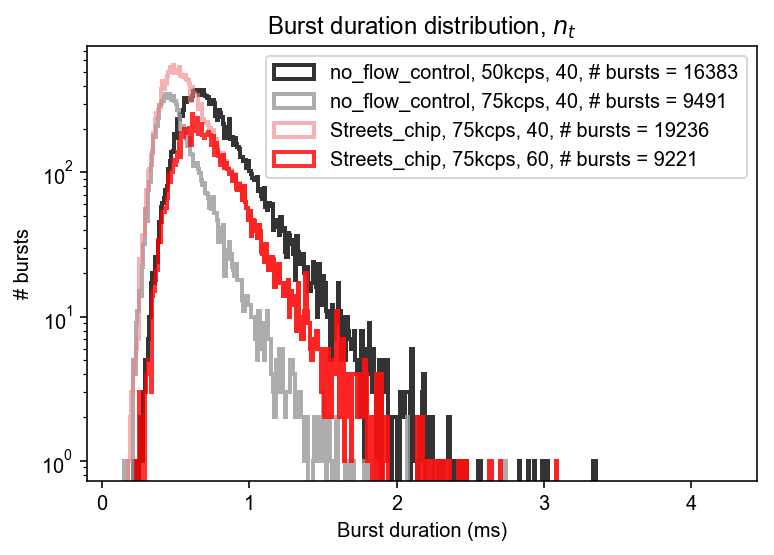

In [233]:
column = 'width_ms'
binwidth = 0.01
hist_kws = dict(histtype='step', lw=2)

width_nf50 = bursts_all.loc[mask_nf & mask_bsearch_50, column]
width_nf75 = bursts_all.loc[mask_nf & mask_bsearch_75, column]

width_nf50s40 = bursts_all_40.loc[mask_nf & mask_bsearch_50, column]
width_nf75s40 = bursts_all_40.loc[mask_nf & mask_bsearch_75, column]

width_f50 = bursts_all.loc[mask_f & mask_bsearch_50, column]
width_f75 = bursts_all.loc[mask_f & mask_bsearch_75, column]

width_f50s40 = bursts_all_40.loc[mask_f & mask_bsearch_50, column]
width_f75s40 = bursts_all_40.loc[mask_f & mask_bsearch_75, column]
width_f50s60 = bursts_all_60.loc[mask_f & mask_bsearch_50, column]
width_f75s60 = bursts_all_60.loc[mask_f & mask_bsearch_75, column]

bins = np.arange(-1, width_nf50s40.max(), binwidth)

#plt.hist(width_nf50, label=f'{burst_search_50kcps}, # bursts = {num_bursts_nf50}', 
#           color='k', bins=bins, **hist_kws)
plt.hist(width_nf50s40, label=f'{sample_description_noflow}, {burst_search_50kcps}, {size_sel_40}, # bursts = {num_bursts_nf50s40}', 
           color='k', alpha=0.8, bins=bins, **hist_kws)
#plt.hist(width_nf75, alpha=0.8, label=f'{burst_search_75kcps}, # bursts = {num_bursts_nf75}', 
#          color='r', bins=bins, **hist_kws)
plt.hist(width_nf75s40, alpha=0.8, label=f'{sample_description_noflow}, {burst_search_75kcps}, {size_sel_40}, # bursts = {num_bursts_nf75s40}', 
           color='0.6', bins=bins, **hist_kws)
plt.hist(width_f75s40, alpha=0.6, label=f'{sample_description_flow}, {burst_search_75kcps}, {size_sel_40}, # bursts = {num_bursts_f75s40}', 
           color='lightcoral', bins=bins, **hist_kws)
plt.hist(width_f75s60, alpha=0.8, label=f'{sample_description_flow}, {burst_search_75kcps}, {size_sel_60}, # bursts = {num_bursts_f75s60}', 
           color='r', bins=bins, **hist_kws)
plt.yscale('log')
plt.legend(loc='upper right')
plt.ylabel('# bursts')
plt.xlabel('Burst duration (ms)')
plt.title('Burst duration distribution, $n_t$')
plt.xlim(-.1, width_nf50s40.quantile(0.99999) + 1)

plt.savefig(f'{save_dir}/burst_duration_distribution_50kcps_75kcps_size_sel_40_60_comparison.png', 
            bbox_to_anchor='tight', dpi=1200);

In [189]:
%pip install pycorrelate

Note: you may need to restart the kernel to use updated packages.


In [190]:
import pycorrelate as pyc

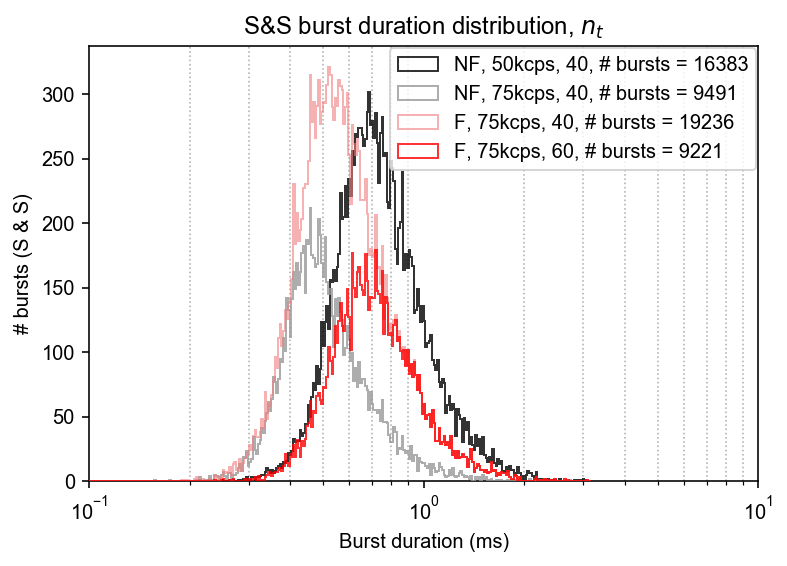

In [260]:
column = 'width_ms'
binwidth = 0.01
hist_kws = dict(histtype='step', ls='-')

width_nf50 = bursts_all.loc[mask_nf & mask_bsearch_50, column]
width_nf75 = bursts_all.loc[mask_nf & mask_bsearch_75, column]

width_nf50s40 = bursts_all_40.loc[mask_nf & mask_bsearch_50, column]
width_nf75s40 = bursts_all_40.loc[mask_nf & mask_bsearch_75, column]

width_f50 = bursts_all.loc[mask_f & mask_bsearch_50, column]
width_f75 = bursts_all.loc[mask_f & mask_bsearch_75, column]

width_f50s40 = bursts_all_40.loc[mask_f & mask_bsearch_50, column]
width_f75s40 = bursts_all_40.loc[mask_f & mask_bsearch_75, column]
width_f50s60 = bursts_all_60.loc[mask_f & mask_bsearch_50, column]
width_f75s60 = bursts_all_60.loc[mask_f & mask_bsearch_75, column]

bins = pyc.pycorrelate.make_loglags(-1, 0.5, 200, base=10)
#bins = np.logspace(np.log10(0.1),np.log10(1), binwidth) 

#plt.hist(width_nf50, label=f'{burst_search_50kcps}, # bursts = {num_bursts_nf50}', 
#           color='k', bins=bins, **hist_kws)
plt.hist(width_nf50s40, label=f'NF, {burst_search_50kcps}, {size_sel_40}, # bursts = {num_bursts_nf50s40}', 
           color='k', alpha=0.8, bins=bins, zorder=3, **hist_kws)
#plt.hist(width_nf75, alpha=0.8, label=f'{burst_search_75kcps}, # bursts = {num_bursts_nf75}', 
#          color='r', bins=bins, **hist_kws)
plt.hist(width_nf75s40, alpha=0.8, label=f'NF, {burst_search_75kcps}, {size_sel_40}, # bursts = {num_bursts_nf75s40}', 
           color='0.6', bins=bins, zorder=3, **hist_kws)
plt.hist(width_f75s40, alpha=0.6, label=f'F, {burst_search_75kcps}, {size_sel_40}, # bursts = {num_bursts_f75s40}', 
           color='lightcoral', bins=bins, zorder=3, **hist_kws)
plt.hist(width_f75s60, alpha=0.8, label=f'F, {burst_search_75kcps}, {size_sel_60}, # bursts = {num_bursts_f75s60}', 
           color='r', bins=bins, zorder=3, **hist_kws)
plt.xscale('log')
plt.grid(True, which='minor',ls=':', )
plt.legend(loc='upper right', bbox_to_anchor=(1.012, 1.02))
plt.ylabel('# bursts (S & S)')
plt.xlabel('Burst duration (ms)')
plt.title('S&S burst duration distribution, $n_t$')
plt.xlim(.1, 10)

plt.savefig(f'{save_dir}/burst_duration_distribution_ss-xlog_50kcps_75kcps_size_sel_40_60_comparison.png', 
            bbox_to_anchor='tight', dpi=1200);

In [211]:
# calculate number of bursts before size selection
num_Donly_bursts_nf50 = len(bursts_all.loc[mask_nf & mask_bsearch_50 & bursts_all.nd])
num_Donly_bursts_nf75 = len(bursts_all.loc[mask_nf & mask_bsearch_75 & bursts_all.nd])

num_Donly_bursts_f50 = len(bursts_all.loc[mask_f & mask_bsearch_50])
num_Donly_bursts_f75 = len(bursts_all.loc[mask_f & mask_bsearch_75])

# calculate number of bursts after size selection
num_Donly_bursts_nf50s40 = len(bursts_all_40.loc[mask_nf & mask_bsearch_50 & bursts_all_40.nd])
num_Donly_bursts_nf75s40 = len(bursts_all_40.loc[mask_nf & mask_bsearch_75 & bursts_all_40.nd])

num_Donly_bursts_f75s40 = len(bursts_all_40.loc[mask_f & mask_bsearch_75 & bursts_all_40.nd])
num_Donly_bursts_f75s60 = len(bursts_all_60.loc[mask_f & mask_bsearch_75 & bursts_all_60.nd])

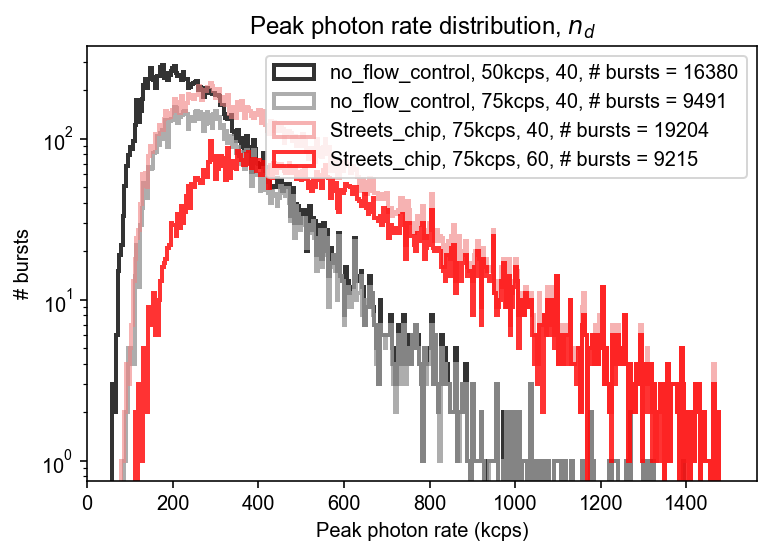

In [212]:
column = 'max_rate'
binwidth = 4
hist_kws = dict(histtype='step', lw=2)

rate_nf50 = bursts_all.loc[mask_nf & mask_bsearch_50 & bursts_all.nd, column]*1e-3
rate_nf75 = bursts_all.loc[mask_nf & mask_bsearch_75 & bursts_all.nd, column]*1e-3

rate_nf50s40 = bursts_all_40.loc[mask_nf & mask_bsearch_50 & bursts_all_40.nd, column]*1e-3
rate_nf75s40 = bursts_all_40.loc[mask_nf & mask_bsearch_75 & bursts_all_40.nd, column]*1e-3

rate_f50 = bursts_all.loc[mask_f & mask_bsearch_50 & bursts_all.nd, column]*1e-3
rate_f75 = bursts_all.loc[mask_f & mask_bsearch_75 & bursts_all.nd, column]*1e-3

rate_f50s40 = bursts_all_40.loc[mask_f & mask_bsearch_50 & bursts_all_40.nd, column]*1e-3
rate_f75s40 = bursts_all_40.loc[mask_f & mask_bsearch_75 & bursts_all_40.nd, column]*1e-3
rate_f50s60 = bursts_all_60.loc[mask_f & mask_bsearch_50 & bursts_all_60.nd, column]*1e-3
rate_f75s60 = bursts_all_60.loc[mask_f & mask_bsearch_75 & bursts_all_60.nd, column]*1e-3

bins = np.arange(-1, rate_nf50s40.max(), binwidth)

#plt.hist(rate_nf50, label=f'{burst_search_50kcps}, # bursts = {num_bursts_nf50}', 
#           color='k', bins=bins, **hist_kws)
plt.hist(rate_nf50s40, label=f'{sample_description_noflow}, {burst_search_50kcps}, {size_sel_40}, # bursts = {num_Donly_bursts_nf50s40}', 
           color='k', alpha=0.8, bins=bins, **hist_kws)
#plt.hist(rate_nf75, alpha=0.8, label=f'{burst_search_75kcps}, # bursts = {num_bursts_nf75}', 
#          color='r', bins=bins, **hist_kws)
plt.hist(rate_nf75s40, alpha=0.8, label=f'{sample_description_noflow}, {burst_search_75kcps}, {size_sel_40}, # bursts = {num_Donly_bursts_nf75s40}', 
           color='0.6', bins=bins, **hist_kws)
plt.hist(rate_f75s40, alpha=0.6, label=f'{sample_description_flow}, {burst_search_75kcps}, {size_sel_40}, # bursts = {num_Donly_bursts_f75s40}', 
           color='lightcoral', bins=bins, **hist_kws)
plt.hist(rate_f75s60, alpha=0.8, label=f'{sample_description_flow}, {burst_search_75kcps}, {size_sel_60}, # bursts = {num_Donly_bursts_f75s60}', 
           color='r', bins=bins, **hist_kws)
plt.yscale('log')
plt.legend(loc='upper right')
plt.ylabel('# bursts')
plt.xlabel('Peak photon rate (kcps)')
plt.title('Peak photon rate distribution, $n_d$')
plt.xlim(0, rate_nf50s40.quantile(0.99999) + 100)

plt.savefig(f'{save_dir}/burst_peak_rate_distribution_50kcps_75kcps_size_sel_40_60_comparison.png', 
            bbox_to_anchor='tight', dpi=1200);